# Imports

In [ ]:
!pip install statsbombpy
!pip install mplsoccer
!pip install highlight_text

In [ ]:
import warnings
warnings.filterwarnings("ignore", category=UserWarning, module="statsbombpy.api_client")

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
from google.colab import drive

# Generación de Secuencias

Para agrupar jugadas y encontrar patrones se generaron secuencias antes de gol con información de eventos de Statsbomb

In [ ]:
drive.mount('/content/drive')
events = pd.read_csv('/content/drive/MyDrive/Hackathon FUT/Data/EG_events.csv')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


<ipython-input-9-5d30d0308133>:2: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  events = pd.read_csv('/content/drive/MyDrive/Hackathon FUT/Data/EG_events.csv')


In [ ]:
for col in events.columns:
    print(col)

match_id
competition_name
season_name
home_team
away_team
timestamp
goal_minute
event_id
event_type
event_minute
event_second
team
player
location
possession
possession_team
play_pattern
pass_type
pass_outcome
pass_length
pass_recipient
pass_end_location
pass_angle
pass_height
pass_cross
pass_straight
pass_switch
pass_through_ball
dribble_outcome
shot_outcome
shot_statsbomb_xg
shot_end_location
duel_outcome
duration
foul_committed_card
goalkeeper_outcome
under_pressure
carry_end_location
half
team_started_half
team_scored


In [ ]:
unique_event_types = events['event_type'].unique()
print(unique_event_types)

['Pass' 'Ball Receipt*' 'Carry' 'Pressure' 'Duel' 'Miscontrol'
 'Ball Recovery' 'Foul Committed' 'Foul Won' 'Dispossessed' 'Shot'
 'Goal Keeper' 'Clearance' 'Block' 'Substitution' 'Dribbled Past'
 'Dribble' 'Error' 'Interception' 'Shield' 'Injury Stoppage' '50/50'
 'Player Off' 'Own Goal Against' 'Own Goal For' 'Bad Behaviour' 'Offside'
 'Player On']


In [ ]:
df = events.sort_values(['match_id','half', 'timestamp', 'event_minute', 'event_second'])

## Preparación

### Limpieza Básica

Solo se usaron eventos que tienen valor de posición

In [ ]:
df = df.dropna(subset=['location'])
print(len(df))

55417


Solo se utilizaron los equipos masculinos para homogenizar jugadas y tácticas

In [ ]:
df = df[~df['team'].str.contains('WFC|Women|LFC|FCW|WNT', na=False)]

In [ ]:
print(df.columns)

Index(['match_id', 'competition_name', 'season_name', 'home_team', 'away_team',
       'timestamp', 'goal_minute', 'event_id', 'event_type', 'event_minute',
       'event_second', 'team', 'player', 'location', 'possession',
       'possession_team', 'play_pattern', 'pass_type', 'pass_outcome',
       'pass_length', 'pass_recipient', 'pass_end_location', 'pass_angle',
       'pass_height', 'pass_cross', 'pass_straight', 'pass_switch',
       'pass_through_ball', 'dribble_outcome', 'shot_outcome',
       'shot_statsbomb_xg', 'shot_end_location', 'duel_outcome', 'duration',
       'foul_committed_card', 'goalkeeper_outcome', 'under_pressure',
       'carry_end_location', 'half', 'team_started_half', 'team_scored'],
      dtype='object')


In [ ]:
df = df[~df['competition_name'].str.contains('Women', na=False)]

### Eventos Duplicados

Limpieza de eventos duplicados

In [ ]:
duplicate_events = df[df.duplicated(subset=['match_id', 'half','timestamp'], keep=False)]

duplicate_events[['match_id', 'half','timestamp', 'event_minute', 'event_second', 'event_type','team','possession']].head(10)

,match_id,half,timestamp,event_minute,event_second,event_type,team,possession
15550,7536,2,00:00:01.533,45,1,Ball Receipt*,Belgium,86
15570,7536,2,00:00:01.533,45,1,Carry,Belgium,86
15551,7536,2,00:00:03.093,45,3,Ball Receipt*,Belgium,86
15571,7536,2,00:00:03.093,45,3,Carry,Belgium,86
15552,7536,2,00:00:05.333,45,5,Ball Receipt*,Belgium,86
15572,7536,2,00:00:05.333,45,5,Carry,Belgium,86
15553,7536,2,00:00:08.053,45,8,Ball Receipt*,Belgium,86
15573,7536,2,00:00:08.053,45,8,Carry,Belgium,86
15554,7536,2,00:00:12.773,45,12,Ball Receipt*,Belgium,86
15574,7536,2,00:00:12.773,45,12,Carry,Belgium,86


In [ ]:
for event_type in duplicate_events['event_type'].unique():
    print(event_type)

Ball Receipt*
Carry
Foul Committed
Foul Won
Clearance
Ball Recovery
Duel
Pressure
Pass
Interception
Miscontrol
Shot
Dispossessed
Block
Dribble
Dribbled Past
Goal Keeper
50/50


Se limpiaron algunos eventos que se decidieron no impactantes

In [ ]:
events_to_remove = ['Foul Won', 'Dribbled Past','Goal Keeper','Ball Receipt*','50/50']
df = df[~df['event_type'].isin(events_to_remove)]

Algunos eventos tienen timestamps duplicados entonces tuvimos que agarrar los eventos de Pass, Carry, Shot como después dado por la naturaleza

In [ ]:
def custom_sort(group):
    sorter = {
        "Pass": 1,
        "Carry": 2,
        "Shot": 3
    }
    group['sort_key'] = group['event_type'].map(sorter).fillna(0)
    return group.sort_values(['sort_key'], ascending=True)

df = df.groupby(['match_id', 'half','timestamp'], group_keys=False).apply(custom_sort).reset_index(drop=True)

<ipython-input-20-29175a6654f2>:10: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  df = df.groupby(['match_id', 'half','timestamp'], group_keys=False).apply(custom_sort).reset_index(drop=True)


### Últimos filtros

Se separan los datos entre goles tempranos de minutos 0 y 1 y 45 y 46 con los demás de hasta 4 minutos

In [ ]:
dfEE = df[df['event_minute'].apply(lambda x: x in [0, 1, 45, 46])]
dfEL = df[df['event_minute'].apply(lambda x: x not in [0, 1, 2, 3, 45, 46, 47, 48])]

In [ ]:
import ast

def string_to_list(input_string):
  try:
    return ast.literal_eval(input_string)
  except (ValueError, SyntaxError):
    return None


In [ ]:
early_goals = dfEE[
    (dfEE['event_type'] == 'Shot') &
    (dfEE['shot_outcome'] == 'Goal')
]

In [ ]:
duplicate_early_goals = early_goals[early_goals.duplicated(subset=['match_id', 'player', 'event_minute'], keep=False)]

if not duplicate_early_goals.empty:
    print("Duplicate early goals found:")
    print(duplicate_early_goals[['match_id', 'player', 'event_minute']])
else:
    print("No duplicate early goals found.")

Duplicate early goals found:
       match_id                         player  event_minute
621        7581  Mathias Jattah-Njie Jørgensen             0
622        7581  Mathias Jattah-Njie Jørgensen             0
8224    3795187                  Harry Maguire            45
8225    3795187                  Harry Maguire            45
10429   3825572                  Karim Benzema            46
10430   3825572                  Karim Benzema            46
13555   3825749    Deyverson Brum Silva Acosta            46
13556   3825749    Deyverson Brum Silva Acosta            46
22272   3879847  Felipe Dias da Silva dal Belo            46
22273   3879847  Felipe Dias da Silva dal Belo            46
26286   3900544               Benjamin Jeannot            46
26287   3900544               Benjamin Jeannot            46


In [ ]:
early_goals = early_goals.drop_duplicates(subset=['match_id', 'player', 'event_minute'], keep='first')
early_goals

,match_id,competition_name,season_name,home_team,away_team,timestamp,goal_minute,event_id,event_type,event_minute,...,duel_outcome,duration,foul_committed_card,goalkeeper_outcome,under_pressure,carry_end_location,half,team_started_half,team_scored,sort_key
50,7536,FIFA World Cup,2018,Belgium,Panama,00:01:40.400,46,610b7fa7-4319-46aa-8d91-7932b39d8e7a,Shot,46,...,NaN,1.733000,NaN,NaN,NaN,NaN,2,Belgium,Belgium,3.0
621,7581,FIFA World Cup,2018,Croatia,Denmark,00:00:57.320,0,17911bde-ca9f-48a8-9b51-8ab50603b866,Shot,0,...,NaN,0.640000,NaN,NaN,NaN,NaN,1,Denmark,Denmark,3.0
1858,265894,La Liga,2015/2016,Málaga,Barcelona,00:01:04.238,1,97fbe520-719e-44eb-a32f-78b070d75ebb,Shot,1,...,NaN,0.222339,NaN,NaN,NaN,NaN,1,Barcelona,Barcelona,3.0
1923,266149,La Liga,2015/2016,Barcelona,Athletic Club,00:01:22.970,46,d4e89c25-9ab1-40b3-b8a6-958aeeede849,Shot,46,...,NaN,0.580400,NaN,NaN,NaN,NaN,2,Barcelona,Barcelona,3.0
1981,266310,La Liga,2015/2016,RC Deportivo La Coruña,Barcelona,00:01:23.180,46,42ff6b3b-484e-41a7-b2fa-1fe99511ee8b,Shot,46,...,NaN,0.654400,NaN,NaN,NaN,NaN,2,Barcelona,Barcelona,3.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
30125,3938644,UEFA Euro,2024,Georgia,Portugal,00:01:32.870,1,13ff7cf3-cfc4-4a42-b788-c2b3a95925fe,Shot,1,...,NaN,0.766192,NaN,NaN,True,NaN,1,Portugal,Georgia,3.0
30397,3939986,Copa America,2024,Argentina,Peru,00:01:13.509,46,24d1b856-b497-43d0-9428-8590ab2d9716,Shot,46,...,NaN,1.083943,NaN,NaN,NaN,NaN,2,Peru,Argentina,3.0
30629,3940878,UEFA Euro,2024,Switzerland,Italy,00:00:27.414,45,8db360f7-8b50-4814-b02a-0fbaa709f4ac,Shot,45,...,NaN,0.904606,NaN,NaN,NaN,NaN,2,Italy,Switzerland,3.0
30659,3941022,UEFA Euro,2024,Austria,Turkey,00:00:58.114,0,df73fa5b-6ec6-408c-aa80-30e4502b5d73,Shot,0,...,NaN,0.334739,NaN,NaN,NaN,NaN,1,Austria,Turkey,3.0


## Enriquecimiento

### Funciones de determinación

In [ ]:
def calculate_distance(start, end):
    return np.sqrt((end[0] - start[0])**2 + (end[1] - start[1])**2)

def determine_pitch_third(start_location, pitch_length=120):
    if start_location:
        distance_to_goal = abs(120 - start_location[0])
        third_length = pitch_length / 3
        third = int(distance_to_goal // third_length) + 1
        return min(third, 3)
    return 'UnknownThird'

def determine_direction(pass_vector, goal_vector):
    pass_magnitude = np.linalg.norm(pass_vector)
    goal_magnitude = np.linalg.norm(goal_vector)

    if pass_magnitude > 0 and goal_magnitude > 0:
        cos_theta = np.dot(pass_vector, goal_vector) / (pass_magnitude * goal_magnitude)
        cos_theta = max(min(cos_theta, 1), -1)
        angle = np.degrees(np.arccos(cos_theta))

        if angle < 45:
            return 'Towards'
        elif angle > 135:
            return 'Away'
        else:
            return 'Sideways'
    return 'UnknownDirection'

def categorize_pass_length(pass_length):
    if pd.isnull(pass_length):
        return 'UnknownLength'
    elif pass_length < 15:
        return 'Short'
    elif pass_length < 30:
        return 'Medium'
    return 'Long'

def categorize_carry_distance(start_location, end_location):
    carry_distance = calculate_distance(start_location, end_location)
    if carry_distance < 10:
        return 'Short'
    elif carry_distance < 30:
        return 'Medium'
    return 'Long'

def categorize_shot_area(x, y):
    if 102 <= x <= 120 and 18 <= y <= 62:
        return 'Inside'
    return 'Outside'

def determine_pass_type(row):
    if pd.notnull(row['pass_cross']):
        return 'Cross'
    elif pd.notnull(row['pass_through_ball']):
        return 'Through-Ball'
    elif pd.notnull(row['pass_switch']):
        return 'Switch'
    elif pd.notnull(row['pass_straight']):
        return 'Straight'
    else:
        return 'None'

In [ ]:
def get_enriched_event(row):
    event_type = row['event_type']

    start_location = string_to_list(row['location'])
    third = determine_pitch_third(start_location)

    play_pattern = row['play_pattern'] if pd.notnull(row['play_pattern']) else 'NoPattern'

    if event_type == 'Pass':
        pass_length = row['pass_length']
        end_location = string_to_list(row['pass_end_location'])

        if all([start_location, end_location]):
            pass_vector = np.array([end_location[0] - start_location[0], end_location[1] - start_location[1]])
            goal_vector = np.array([120 - start_location[0], 40 - start_location[1]])
            direction = determine_direction(pass_vector, goal_vector)
        else:
            direction = 'UnknownDirection'

        length_category = categorize_pass_length(pass_length)

        pass_type = determine_pass_type(row)

        pass_height = row['pass_height'] if pd.notnull(row['pass_height']) else 'NoHeight'

        return f"{event_type}_{play_pattern}_{pass_type}_{pass_height}_{length_category}_{direction}_T{third}"

    elif event_type == 'Shot':
        if isinstance(start_location, (list, tuple)) and len(start_location) == 2:
            x, y = start_location
            shot_area = categorize_shot_area(x, y)
        else:
            shot_area = 'UnknownArea'

        outcome = row['shot_outcome'] if pd.notnull(row['shot_outcome']) else 'NoOutcome'
        return f"{event_type}_{play_pattern}_{shot_area}_{outcome}_T{third}"

    elif event_type == 'Dribble':
        outcome = row['dribble_outcome'] if pd.notnull(row['dribble_outcome']) else 'NoOutcome'
        return f"{event_type}_{play_pattern}_{outcome}_T{third}"

    elif event_type == 'Carry':
        end_location = string_to_list(row['carry_end_location'])


        if all([start_location, end_location]):
            pass_vector = np.array([end_location[0] - start_location[0], end_location[1] - start_location[1]])
            goal_vector = np.array([120 - start_location[0], 40 - start_location[1]])
            direction = determine_direction(pass_vector, goal_vector)
        else:
            direction = 'UnknownDirection'

        distance_category = categorize_carry_distance(start_location, end_location)
        return f"{event_type}_{play_pattern}_{distance_category}_{direction}_T{third}"


    return f"{event_type}_{play_pattern}"

def get_enriched_event_with_kickoff(row):
    event_repr = get_enriched_event(row)
    kick_off_flag = 'YES' if row['team'] == row['team_started_half'] else 'NO'
    return f"{event_repr}_{kick_off_flag}"


In [ ]:
sequences = []
sequences_with_match = []
for idx, goal in early_goals.iterrows():
    match_id = goal['match_id']
    team = goal['team']
    half = goal['half']
    goal_time = goal['event_minute'] * 60 + goal['event_second']

    sequence = df[ (df['match_id'] == match_id) & (df['half'] == half) & ((df['event_minute'] * 60 + df['event_second']) <= goal_time)]

    sequence['enriched_event'] = sequence.apply(get_enriched_event_with_kickoff, axis=1)

    event_sequence = sequence['enriched_event'].tolist()

    sequences.append(event_sequence)
    sequences_with_match.append([[match_id, team, goal['event_minute']], sequence])

In [ ]:
from collections import defaultdict
def remove_consecutive_duplicates(sequence):
  if not sequence:
    return []
  new_sequence = [sequence[0]]
  for i in range(1, len(sequence)):
    if sequence[i] != sequence[i-1]:
      new_sequence.append(sequence[i])
  return new_sequence

new_sequences = []
for seq in sequences:
    new_sequences.append(remove_consecutive_duplicates(seq))

sequences = new_sequences

Información de cancha tiene que ser cambiada para los equipos que no metieron el gol

In [ ]:
new_sequences = []
for seq in sequences:
    last_event = seq[-1]
    split_last_event = last_event.split('_')
    team = split_last_event[-1]
    new_seq = []

    for event in seq:
        if team not in event:
          if "T3" in event:
            event = event.replace("T3", "T1")
          elif "T1" in event:
            event = event.replace("T1", "T3")
        new_seq.append(event)
    new_sequences.append(new_seq)

sequences = new_sequences

In [ ]:
sequences

[['Pass_From Kick Off_None_Ground Pass_Short_Away_T2_YES',
  'Carry_From Kick Off_Short_UnknownDirection_T2_YES',
  'Pass_From Kick Off_None_Ground Pass_Medium_Sideways_T2_YES',
  'Pressure_From Kick Off_NO',
  'Carry_From Kick Off_Short_Sideways_T2_YES',
  'Pass_From Kick Off_None_Ground Pass_Medium_Sideways_T2_YES',
  'Carry_From Kick Off_Short_Sideways_T3_YES',
  'Pass_From Kick Off_None_Ground Pass_Medium_Towards_T3_YES',
  'Carry_From Kick Off_Short_Sideways_T2_YES',
  'Pass_From Kick Off_None_Ground Pass_Short_Sideways_T2_YES',
  'Carry_From Kick Off_Short_Sideways_T2_YES',
  'Pass_From Kick Off_None_Ground Pass_Medium_Sideways_T2_YES',
  'Carry_From Kick Off_Short_Sideways_T2_YES',
  'Pass_From Kick Off_None_Ground Pass_Long_Sideways_T2_YES',
  'Carry_From Kick Off_Short_UnknownDirection_T1_YES',
  'Pass_From Kick Off_None_Ground Pass_Medium_Sideways_T1_YES',
  'Carry_From Kick Off_Short_Sideways_T2_YES',
  'Pass_From Kick Off_None_Ground Pass_Long_Sideways_T2_YES',
  'Carry_Fro

In [ ]:
print(len(sequences))

average_events_per_sequence = [len(seq) for seq in sequences]
total_events = sum([len(seq) for seq in sequences])
average_events = sum(average_events_per_sequence) / len(average_events_per_sequence) if average_events_per_sequence else 0

print(f"Average number of events per sequence: {average_events:.2f}")
print(f"Total number of events across all sequences: {total_events}")

142
Average number of events per sequence: 40.23
Total number of events across all sequences: 5713


In [ ]:
def remove_events_without_third(sequences):
  new_sequences = []
  for sequence in sequences:
    new_sequence = [event for event in sequence if len(event.split("_")) > 3 or "Error" in event]
    new_sequences.append(new_sequence)
  return new_sequences

sequences_basic = remove_events_without_third(sequences)

In [ ]:
print(len(sequences_basic))
average_events_per_sequence = [len(seq) for seq in sequences_basic]
total_events = sum([len(seq) for seq in sequences_basic])
average_events = sum(average_events_per_sequence) / len(average_events_per_sequence) if average_events_per_sequence else 0

print(f"Average number of events per sequence: {average_events:.2f}")
print(f"Total number of events across all sequences: {total_events}")

142
Average number of events per sequence: 30.32
Total number of events across all sequences: 4305


In [ ]:
sequences_basic

[['Pass_From Kick Off_None_Ground Pass_Short_Away_T2_YES',
  'Carry_From Kick Off_Short_UnknownDirection_T2_YES',
  'Pass_From Kick Off_None_Ground Pass_Medium_Sideways_T2_YES',
  'Carry_From Kick Off_Short_Sideways_T2_YES',
  'Pass_From Kick Off_None_Ground Pass_Medium_Sideways_T2_YES',
  'Carry_From Kick Off_Short_Sideways_T3_YES',
  'Pass_From Kick Off_None_Ground Pass_Medium_Towards_T3_YES',
  'Carry_From Kick Off_Short_Sideways_T2_YES',
  'Pass_From Kick Off_None_Ground Pass_Short_Sideways_T2_YES',
  'Carry_From Kick Off_Short_Sideways_T2_YES',
  'Pass_From Kick Off_None_Ground Pass_Medium_Sideways_T2_YES',
  'Carry_From Kick Off_Short_Sideways_T2_YES',
  'Pass_From Kick Off_None_Ground Pass_Long_Sideways_T2_YES',
  'Carry_From Kick Off_Short_UnknownDirection_T1_YES',
  'Pass_From Kick Off_None_Ground Pass_Medium_Sideways_T1_YES',
  'Carry_From Kick Off_Short_Sideways_T2_YES',
  'Pass_From Kick Off_None_Ground Pass_Long_Sideways_T2_YES',
  'Carry_From Kick Off_Short_Sideways_T2_YE

## Generalización de eventos

Para formar clusters las secuencias se generalizaron en diferentes valores de información considerada importante

In [ ]:
def parse_event(event_str):
    parts = event_str.split('_')

    event = {}
    idx = 0
    event['type'] = parts[idx]
    idx += 1
    event['play_source'] = parts[idx]
    idx += 1

    if event['type'] == 'Pass':
        event['pass_type'] = parts[idx]
        idx += 1
        event['pass_detail'] = parts[idx]
        idx += 1
    if event['type'] in ['Carry', 'Pass']:
        event['length'] = parts[idx]
        idx += 1
        event['direction'] = parts[idx]
        idx += 1
        event['third'] = parts[idx]
        idx += 1
        event['team'] = parts[idx]
    elif event['type'] == "Dribble":
        event['outcome'] = parts[idx]
        idx += 1
        event['third'] = parts[idx]
        idx += 1
        event['team'] = parts[idx]
    elif event['type'] == 'Error':
        event['team'] = parts[idx]
    elif event['type'] == 'Shot':
        event['shot_detail'] = parts[idx]
        idx += 1
        event['result'] = parts[idx]
        idx += 1
        event['third'] = parts[idx]
        idx += 1
        event['team'] = parts[idx]
    else:
        pass
    return event

def categorize_possession_length(num_events):
    """Categorizes the possession length."""
    if num_events < 5:
        return 'Short'
    elif num_events <= 20:
        return 'Medium'
    else:
        return 'Long'

In [ ]:
def process_sequences(sequence):
    current_possession = []
    last_team = None
    possession_origin = None
    last_third = None

    output_sequence = []

    for idx, event_str in enumerate(sequence):
        event = parse_event(event_str)
        event_type = event['type']
        team = event.get('team')
        third = event.get('third')

        if event_type in ['Error', 'Shot', 'Dribble']:
            if current_possession:
                possession = {
                    'team': last_team,
                    'third': last_third,
                    'events': current_possession,
                    'origin': possession_origin,
                    'length_category': categorize_possession_length(len(current_possession)),
                }
                possession_events = [e for e in current_possession if e['type'] in ['Carry', 'Pass']]
                possession['num_passes_carries'] = len(possession_events)
                possession['last_two_events'] = possession_events[-2:] if len(possession_events) >= 2 else possession_events
                output_sequence.append(possession)
                current_possession = []
                possession_origin = None
                last_team = None
                last_third = None
            special_event = {
                'type': event_type,
                'event': event,
            }
            output_sequence.append(special_event)
            continue

        if event_type in ['Carry', 'Pass']:
            if (last_team is not None and team != last_team) or (last_third is not None and third != last_third):
                if current_possession:

                    possession = {
                        'team': last_team,
                        'third': last_third,
                        'events': current_possession,
                        'origin': possession_origin,
                        'length_category': categorize_possession_length(len(current_possession)),
                    }

                    possession_events = [e for e in current_possession if e['type'] in ['Carry', 'Pass']]
                    possession['num_passes_carries'] = len(possession_events)
                    possession['last_two_events'] = possession_events[-2:] if len(possession_events) >= 2 else possession_events

                    output_sequence.append(possession)
                current_possession = []
                possession_origin = None

            if not current_possession:
                possession_origin = event.get('play_source', 'Unknown')

            current_possession.append(event)
            last_team = team
            last_third = third

    if current_possession:
        possession = {
            'team': last_team,
            'third': last_third,
            'events': current_possession,
            'origin': possession_origin,
            'length_category': categorize_possession_length(len(current_possession)),
        }

        possession_events = [e for e in current_possession if e['type'] in ['Carry', 'Pass']]
        possession['num_passes_carries'] = len(possession_events)
        possession['last_two_events'] = possession_events[-2:] if len(possession_events) >= 2 else possession_events

        output_sequence.append(possession)

    return output_sequence



# might be smth wrong with the last event generation shouldnt be a possesion if its like 1 pass or carry
def generate_possession_events(output_sequence):
    """Generates generalized event strings from the possessions and special events."""
    possession_events = []
    for item in output_sequence:
        if 'type' in item and item['type'] in ['Error', 'Shot', 'Dribble']:
            event = item['event']
            event_type = event['type']
            if event_type == 'Error':
                event_str = f"Error_{event['team']}"

            elif event_type == 'Shot':
                event_str = f"Shot_{event['third']}_{event['result']}_{event['team']}"

                if event['result'] == 'Goal':
                    last_two_events = possession.get('last_two_events', [])


                    if len(last_two_events) >= 1:

                        last_event = last_two_events[-1]

                        if last_event['type'] == 'Pass':
                            pass_type = last_event['pass_type']
                            pass_detail = last_event['pass_detail']
                            last_event_str = f"LastEvent_{last_event['type']}_{last_event['length']}_{last_event['direction']}_{last_event['third']}_{last_event['team']}_{pass_type}_{pass_detail}"
                        else:
                            last_event_str = f"LastEvent_{last_event['type']}_{last_event['length']}_{last_event['direction']}_{last_event['third']}_{last_event['team']}"


                    if len(last_two_events) == 2:

                        second_last_event = last_two_events[0]

                        if second_last_event['type'] == 'Pass':
                            pass_type = second_last_event['pass_type']
                            pass_detail = second_last_event['pass_detail']
                            second_last_event_str = f"SecondLastEvent_{second_last_event['type']}_{second_last_event['length']}_{second_last_event['direction']}_{second_last_event['third']}_{second_last_event['team']}_{pass_type}_{pass_detail}"
                        else:
                            second_last_event_str = f"SecondLastEvent_{second_last_event['type']}_{second_last_event['length']}_{second_last_event['direction']}_{second_last_event['third']}_{second_last_event['team']}"

                        possession_events.append(second_last_event_str)
                        possession_events.append(last_event_str)
                    else:
                        possession_events.append(last_event_str)


            elif event_type == 'Dribble':

                event_str = f"Dribble_{event['outcome']}_{event['third']}_{event['team']}"

            possession_events.append(event_str)
        else:
            possession = item
            team = possession['team']
            third = possession['third']
            origin = possession['origin']
            length_category = possession['length_category']
            possession_event_str = f"Possession_{origin}_{length_category}_{team}_{third}"
            possession_events.append(possession_event_str)


    return possession_events

In [ ]:
sequences_gen = []
event_descriptions = []
for sequence in sequences_basic:
  output_sequence = process_sequences(sequence)
  event_descriptions.append(output_sequence)

  possession_events = generate_possession_events(output_sequence)

  sequences_gen.append(possession_events)

In [ ]:
sequences_gen

[['Possession_From Kick Off_Medium_YES_T2',
  'Possession_From Kick Off_Short_YES_T3',
  'Possession_From Kick Off_Medium_YES_T2',
  'Possession_From Kick Off_Short_YES_T1',
  'Possession_From Kick Off_Medium_YES_T2',
  'Possession_From Kick Off_Short_YES_T1',
  'Possession_From Free Kick_Short_NO_T1',
  'Possession_From Throw In_Medium_YES_T2',
  'Possession_From Throw In_Short_YES_T1',
  'Error_NO',
  'SecondLastEvent_Carry_Short_Towards_T1_YES',
  'LastEvent_Pass_Medium_Towards_T1_YES_Cross_High Pass',
  'Shot_T1_Goal_YES'],
 ['Possession_From Kick Off_Short_YES_T2',
  'Possession_From Kick Off_Short_YES_T3',
  'Possession_From Kick Off_Short_NO_T1',
  'Possession_From Kick Off_Short_YES_T2',
  'Possession_From Kick Off_Short_NO_T1',
  'Possession_From Kick Off_Short_YES_T2',
  'Possession_From Kick Off_Short_NO_T1',
  'Possession_From Kick Off_Short_YES_T2',
  'Possession_From Kick Off_Short_YES_T1',
  'Possession_From Kick Off_Short_NO_T1',
  'Possession_From Throw In_Short_YES_T1

In [ ]:
average_events_per_sequence = [len(seq) for seq in sequences_gen]
total_events = sum([len(seq) for seq in sequences_gen])
average_events = sum(average_events_per_sequence) / len(average_events_per_sequence) if average_events_per_sequence else 0

print(f"Average number of events per sequence: {average_events:.2f}")
print(f"Total number of events across all sequences: {total_events}")

Average number of events per sequence: 12.56
Total number of events across all sequences: 1783


# Clustering

## Encoding

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

from sklearn.preprocessing import LabelEncoder
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score

import networkx as nx

from mlxtend.preprocessing import TransactionEncoder
from mlxtend.frequent_patterns import apriori, association_rules
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import pairwise_distances
from scipy.spatial.distance import pdist, squareform

In [ ]:
sequences_t = sequences_gen

In [ ]:
all_enriched_events = [event for seq in sequences_t for event in seq]
le = LabelEncoder()
le.fit(all_enriched_events)

encoded_sequences = [le.transform(seq) for seq in sequences_t]

max_length = max(len(seq) for seq in encoded_sequences)
padded_sequences = [
    np.pad(seq, (0, max_length - len(seq)), 'constant', constant_values=-1)
    for seq in encoded_sequences
]

sequence_df = pd.DataFrame(padded_sequences)

sequence_data = np.array(padded_sequences)

In [ ]:
sequence_df.replace(-1, np.nan, inplace=True)

sequence_df.fillna(0, inplace=True)

distance_matrix = pairwise_distances(sequence_df, metric='euclidean')

## Encontrar numero de clusters optimo

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


Number of clusters: 2, Silhouette Score: 0.2446
Number of clusters: 3, Silhouette Score: 0.1798
Number of clusters: 4, Silhouette Score: 0.2256
Number of clusters: 5, Silhouette Score: 0.2315
Number of clusters: 6, Silhouette Score: 0.2533
Number of clusters: 7, Silhouette Score: 0.2732
Number of clusters: 8, Silhouette Score: 0.3120
Number of clusters: 9, Silhouette Score: 0.3235
Number of clusters: 10, Silhouette Score: 0.3340
Number of clusters: 11, Silhouette Score: 0.3542
Number of clusters: 12, Silhouette Score: 0.3708
Number of clusters: 13, Silhouette Score: 0.3887
Number of clusters: 14, Silhouette Score: 0.4026
Number of clusters: 15, Silhouette Score: 0.4080
Number of clusters: 16, Silhouette Score: 0.4272
Number of clusters: 17, Silhouette Score: 0.4477
Number of clusters: 18, Silhouette Score: 0.4436
Number of clusters: 19, Silhouette Score: 0.4494
Number of clusters: 20, Silhouette Score: 0.4508
Number of clusters: 21, Silhouette Score: 0.4557
Number of clusters: 22, Silh

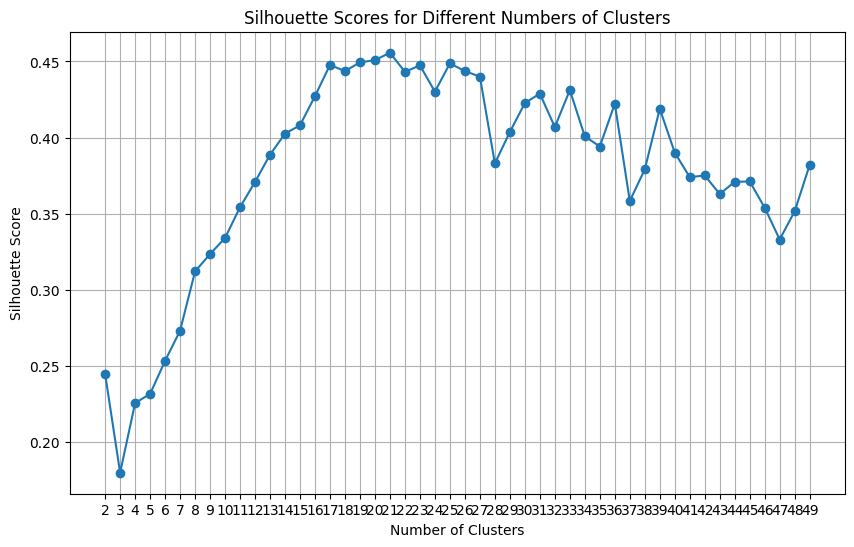

In [ ]:
cluster_range = range(2, 50)

silhouette_scores = []

for n_clusters in cluster_range:
    kmeans = KMeans(n_clusters=n_clusters, random_state=42, n_init=10)

    cluster_labels = kmeans.fit_predict(sequence_data)

    score = silhouette_score(sequence_data, cluster_labels)
    silhouette_scores.append(score)

    print(f"Number of clusters: {n_clusters}, Silhouette Score: {score:.4f}")

plt.figure(figsize=(10, 6))
plt.plot(cluster_range, silhouette_scores, marker='o')
plt.title('Silhouette Scores for Different Numbers of Clusters')
plt.xlabel('Number of Clusters')
plt.ylabel('Silhouette Score')
plt.xticks(cluster_range)
plt.grid(True)
plt.show()

In [ ]:
optimal_clusters = 21

In [ ]:
kmeans_optimal = KMeans(n_clusters=optimal_clusters, random_state=42, n_init=10)
cluster_labels_optimal = kmeans_optimal.fit_predict(sequence_data)
clustered_sequences = pd.DataFrame({
    'sequence': sequences_t,
    'cluster': cluster_labels_optimal
})

In [ ]:
event_mapping = {i: label for i, label in enumerate(le.classes_)}

## Resultados del Clustering

In [ ]:
from collections import Counter

for cluster_num in range(optimal_clusters):
    print(f"\nCluster {cluster_num}:")
    cluster_seqs = clustered_sequences[clustered_sequences['cluster'] == cluster_num]['sequence']
    print(f"Number of sequences in cluster: {len(cluster_seqs)}")

    events_in_cluster = []
    for seq in cluster_seqs:
        events_in_cluster.extend(seq)

    event_labels = [event for event in events_in_cluster]

    event_counts = Counter(event_labels)
    common_events = event_counts.most_common(10)

    print("Most common events in this cluster:")
    for event, count in common_events:
        print(f"{event}: {count}")



Cluster 0:
Number of sequences in cluster: 9
Most common events in this cluster:
Possession_From Kick Off_Short_YES_T2: 7
Shot_T1_Goal_YES: 7
Possession_From Kick Off_Medium_YES_T2: 6
Possession_From Throw In_Short_YES_T2: 5
Possession_From Kick Off_Short_YES_T3: 4
Possession_From Throw In_Short_YES_T3: 3
Possession_Regular Play_Short_YES_T1: 3
Possession_Regular Play_Short_YES_T2: 3
Possession_From Throw In_Short_YES_T1: 3
Possession_From Free Kick_Short_NO_T1: 2

Cluster 1:
Number of sequences in cluster: 12
Most common events in this cluster:
Possession_From Kick Off_Short_YES_T2: 11
Possession_From Kick Off_Medium_YES_T2: 8
Possession_From Kick Off_Short_YES_T3: 8
Possession_From Kick Off_Short_YES_T1: 7
Possession_From Throw In_Short_NO_T1: 7
Shot_T1_Goal_YES: 6
Possession_From Throw In_Short_YES_T2: 6
Possession_Regular Play_Short_NO_T2: 6
Shot_T1_Goal_NO: 6
Possession_Regular Play_Short_NO_T1: 6

Cluster 2:
Number of sequences in cluster: 16
Most common events in this cluster:


/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


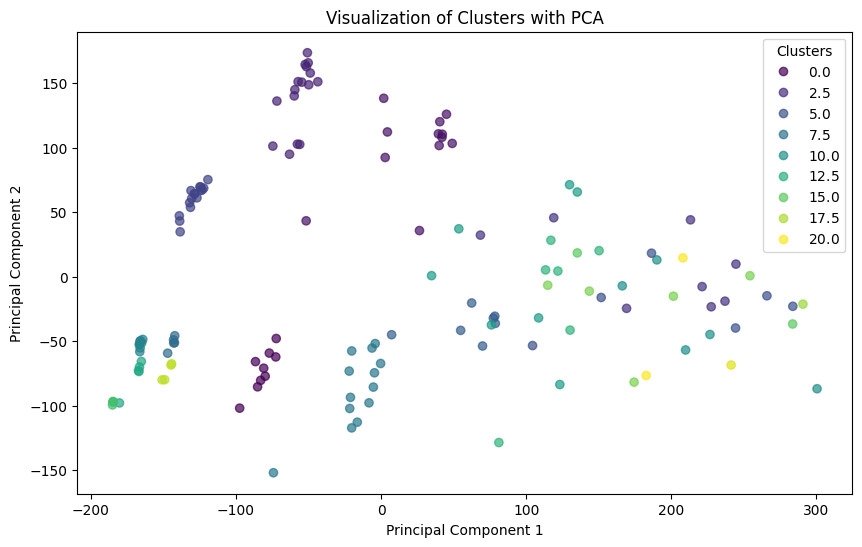

In [ ]:
from sklearn.decomposition import PCA

# Reduce dimensions to 2 for visualization
pca = PCA(n_components=2)
principal_components = pca.fit_transform(sequence_data)

plt.figure(figsize=(10, 6))
scatter = plt.scatter(
    principal_components[:, 0], principal_components[:, 1],
    c=cluster_labels_optimal, cmap='viridis', alpha=0.7
)
plt.title('Visualization of Clusters with PCA')
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.legend(*scatter.legend_elements(), title='Clusters')
plt.show()


/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


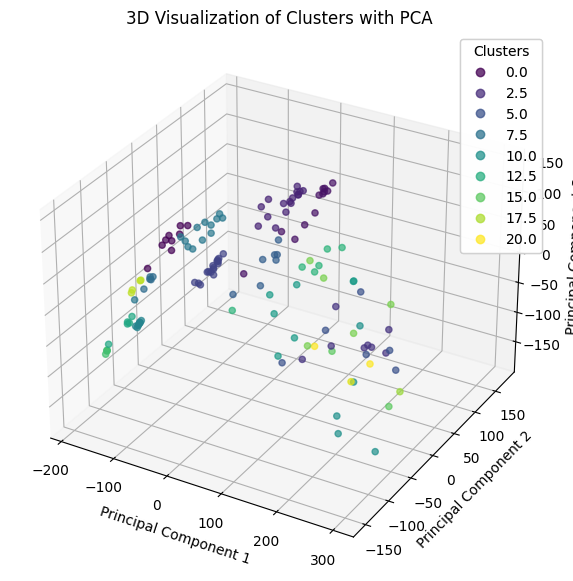

In [ ]:
from mpl_toolkits.mplot3d import Axes3D

# Reduce dimensions to 3 for 3D visualization
principal_components = pca.fit_transform(sequence_data)

fig = plt.figure(figsize=(10, 7))
ax = fig.add_subplot(111, projection='3d')

scatter = ax.scatter(
    principal_components[:, 0], principal_components[:, 1], principal_components[:, 2],
    c=cluster_labels_optimal, cmap='viridis', alpha=0.7
)

ax.set_title('3D Visualization of Clusters with PCA')
ax.set_xlabel('Principal Component 1')
ax.set_ylabel('Principal Component 2')
ax.set_zlabel('Principal Component 3')

legend = ax.legend(*scatter.legend_elements(), title='Clusters')
ax.add_artist(legend)

plt.show()


/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


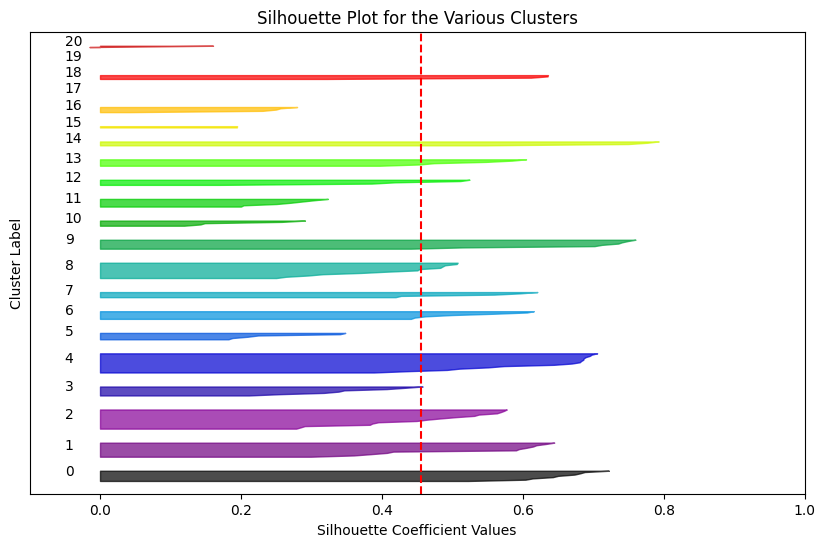

In [ ]:
import matplotlib.cm as cm
from sklearn.metrics import silhouette_samples

sample_silhouette_values = silhouette_samples(sequence_data, cluster_labels_optimal)

y_lower = 10
fig, ax1 = plt.subplots(figsize=(10, 6))

ax1.set_xlim([-0.1, 1])
ax1.set_ylim([0, len(sequence_data) + (optimal_clusters + 1) * 10])

for i in range(optimal_clusters):
    ith_cluster_silhouette_values = sample_silhouette_values[cluster_labels_optimal == i]
    ith_cluster_silhouette_values.sort()

    size_cluster_i = ith_cluster_silhouette_values.shape[0]
    y_upper = y_lower + size_cluster_i

    color = cm.nipy_spectral(float(i) / optimal_clusters)
    ax1.fill_betweenx(
        np.arange(y_lower, y_upper),
        0,
        ith_cluster_silhouette_values,
        facecolor=color,
        edgecolor=color,
        alpha=0.7
    )

    ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

    y_lower = y_upper + 10  # 10 for the 0 samples gap between clusters

ax1.set_title("Silhouette Plot for the Various Clusters")
ax1.set_xlabel("Silhouette Coefficient Values")
ax1.set_ylabel("Cluster Label")
ax1.axvline(x=silhouette_score(sequence_data, cluster_labels_optimal), color="red", linestyle="--")
ax1.set_yticks([])
plt.show()


In [ ]:
silhouette_values = silhouette_samples(sequence_data, cluster_labels_optimal)

silhouette_df = pd.DataFrame({
    'cluster': cluster_labels_optimal,
    'silhouette_score': silhouette_values
})

silhouette_df = silhouette_df.groupby('cluster')['silhouette_score'].mean().reset_index()

silhouette_df

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


,cluster,silhouette_score
0,0,0.644231
1,1,0.514110
2,2,0.454504
3,3,0.345835
4,4,0.611741
5,5,0.248844
6,6,0.518336
7,7,0.524601
8,8,0.406163
9,9,0.669541


In [ ]:
good_clusters = silhouette_df[silhouette_df['silhouette_score'] > 0.5]
good_clusters

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


,cluster,silhouette_score
0,0,0.644231
1,1,0.514110
4,4,0.611741
6,6,0.518336
7,7,0.524601
9,9,0.669541
13,13,0.510331
14,14,0.716682
18,18,0.551170


In [ ]:
for cluster_num in range(optimal_clusters):
  print(f"\nCluster {cluster_num}:")
  cluster_seqs = clustered_sequences[clustered_sequences['cluster'] == cluster_num]['sequence']
  print("Example Sequences:")
  for i, seq in enumerate(cluster_seqs[:2]):  # Print the first 2 sequences of each cluster
      print(f"  Sequence {len(seq)} {i+1}: {seq}")


Cluster 0:
Example Sequences:
  Sequence 10 1: ['Possession_From Kick Off_Short_YES_T2', 'Possession_From Kick Off_Short_YES_T3', 'Possession_From Free Kick_Short_NO_T1', 'Possession_From Free Kick_Short_YES_T3', 'Possession_From Free Kick_Short_NO_T2', 'Possession_From Free Kick_Short_NO_T1', 'Possession_From Free Kick_Short_YES_T2', 'Possession_From Free Kick_Short_YES_T1', 'LastEvent_Carry_Short_Sideways_T1_YES', 'Shot_T1_Goal_YES']
  Sequence 10 2: ['Possession_From Kick Off_Medium_YES_T2', 'Possession_From Throw In_Short_NO_T2', 'Possession_From Throw In_Short_NO_T3', 'Possession_From Throw In_Short_YES_T2', 'Possession_From Throw In_Short_YES_T3', 'Possession_From Throw In_Short_NO_T3', 'Possession_From Throw In_Short_NO_T2', 'SecondLastEvent_Pass_Medium_Sideways_T2_NO_None_Ground Pass', 'LastEvent_Carry_Medium_Towards_T2_NO', 'Shot_T1_Goal_NO']

Cluster 1:
Example Sequences:
  Sequence 13 1: ['Possession_From Kick Off_Medium_YES_T2', 'Possession_From Kick Off_Short_YES_T3', 'Po

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [ ]:
import matplotlib.pyplot as plt
import matplotlib.patches as patches

# Helper function to draw a football pitch
def draw_pitch(ax=None):
    if ax is None:
        fig, ax = plt.subplots(figsize=(10, 7))

    # Pitch Outline & Centre Line
    ax.plot([0, 0], [0, 90], color="black")
    ax.plot([0, 130], [90, 90], color="black")
    ax.plot([130, 130], [90, 0], color="black")
    ax.plot([130, 0], [0, 0], color="black")
    ax.plot([65, 65], [0, 90], color="black")

    # Left Penalty Area
    ax.plot([16.5, 16.5], [65, 25], color="black")
    ax.plot([0, 16.5], [65, 65], color="black")
    ax.plot([0, 16.5], [25, 25], color="black")

    # Right Penalty Area
    ax.plot([130, 113.5], [65, 65], color="black")
    ax.plot([113.5, 113.5], [65, 25], color="black")
    ax.plot([130, 113.5], [25, 25], color="black")

    # Left 6-yard Box
    ax.plot([0, 5.5], [54, 54], color="black")
    ax.plot([5.5, 5.5], [54, 36], color="black")
    ax.plot([0, 5.5], [36, 36], color="black")

    # Right 6-yard Box
    ax.plot([130, 124.5], [54, 54], color="black")
    ax.plot([124.5, 124.5], [54, 36], color="black")
    ax.plot([130, 124.5], [36, 36], color="black")

    # Prepare Circles; 10 yard circle at center and small circles for penalty spots
    centreCircle = plt.Circle((65, 45), 9.15, color="black", fill=False)
    centreSpot = plt.Circle((65, 45), 0.8, color="black")
    leftPenSpot = plt.Circle((11, 45), 0.8, color="black")
    rightPenSpot = plt.Circle((119, 45), 0.8, color="black")

    ax.add_patch(centreCircle)
    ax.add_patch(centreSpot)
    ax.add_patch(leftPenSpot)
    ax.add_patch(rightPenSpot)

    return ax

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)



Cluster 0:
9
3754154 Liverpool 1
3754280 Chelsea 0
3813282 Kerala Blasters 46
3825610 Real Betis 45
3825774 Atlético Madrid 1
3825795 Atlético Madrid 45
3825823 Real Sociedad 1
3879832 Palermo 1
3941022 Turkey 0
9
Match IDs and Scoring Teams:
  Match ID: 3754154, Team: Liverpool, Minute: 1


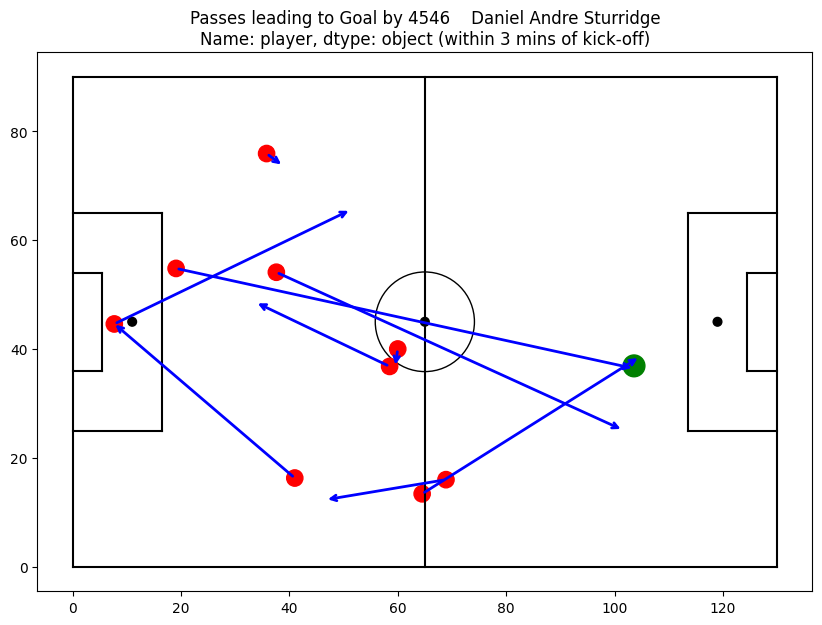

  Match ID: 3754280, Team: Chelsea, Minute: 0


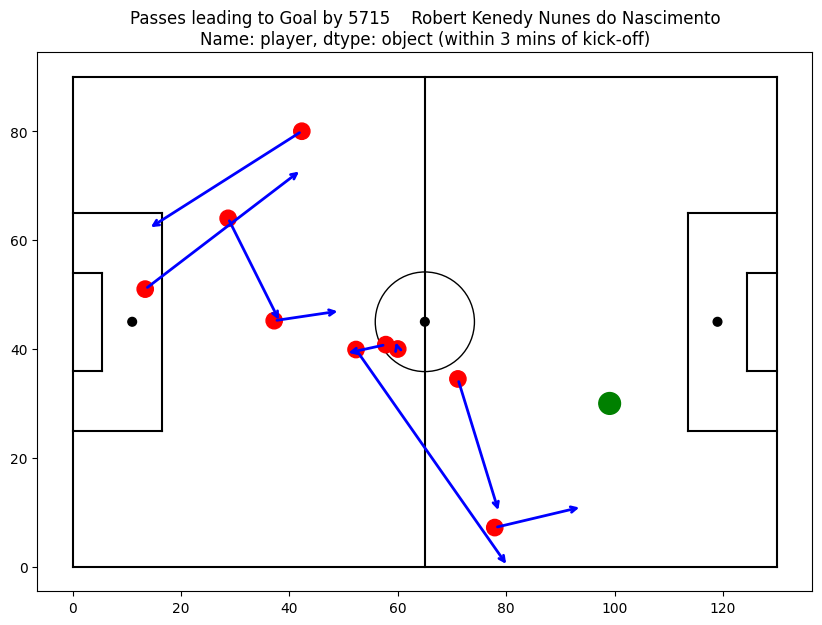

  Match ID: 3813282, Team: Kerala Blasters, Minute: 46


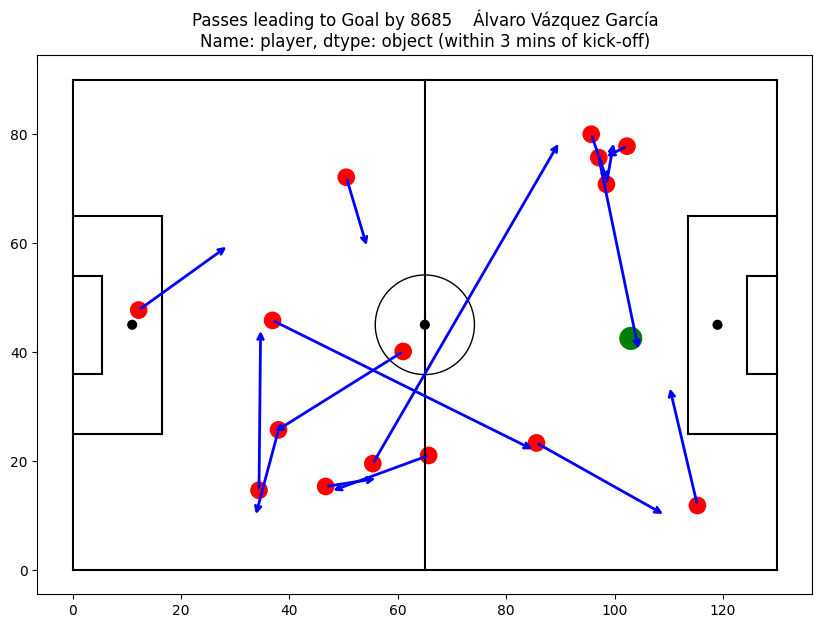

  Match ID: 3825610, Team: Real Betis, Minute: 45


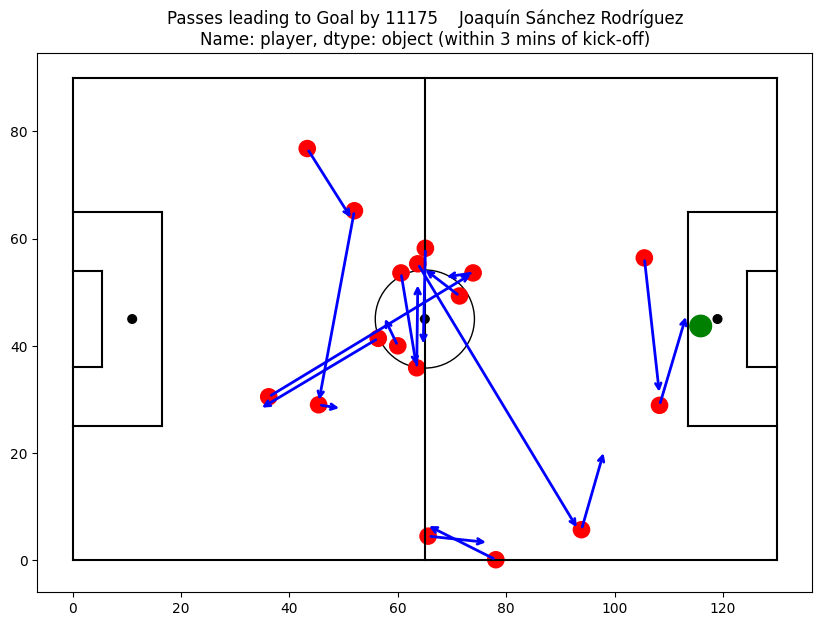

  Match ID: 3825774, Team: Atlético Madrid, Minute: 1


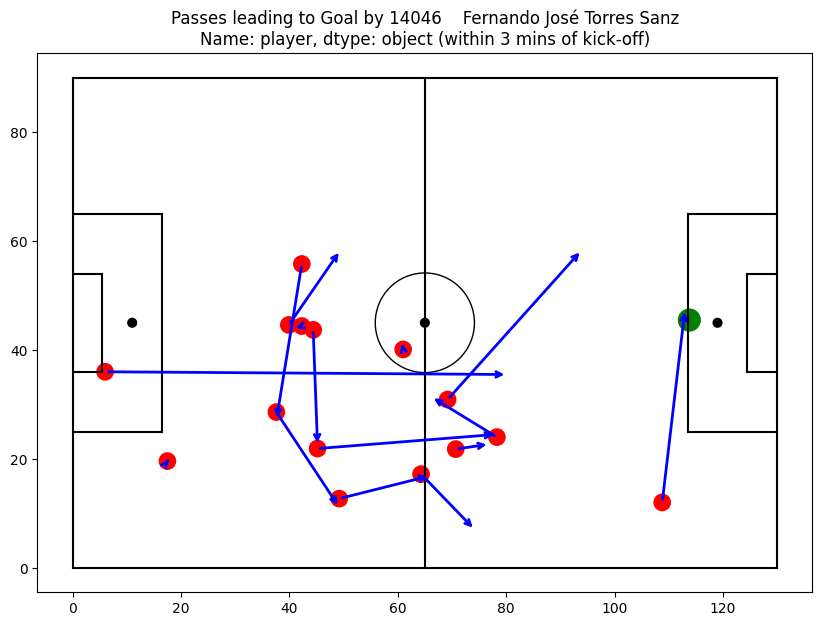

  Match ID: 3825795, Team: Atlético Madrid, Minute: 45


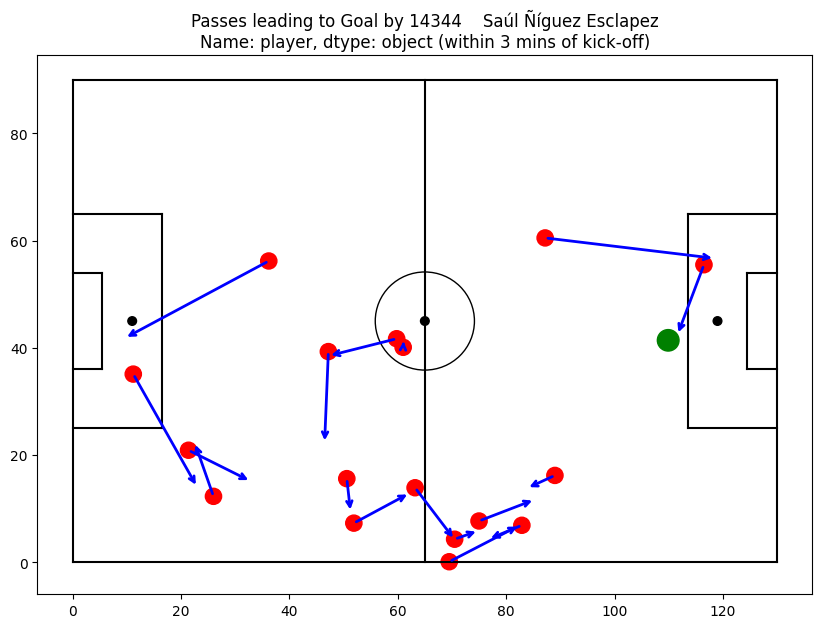

  Match ID: 3825823, Team: Real Sociedad, Minute: 1


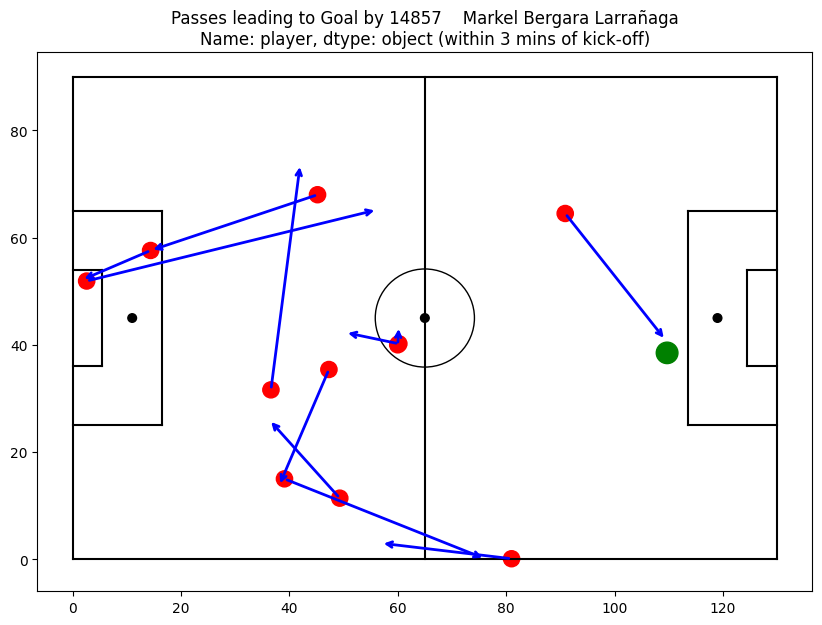

  Match ID: 3879832, Team: Palermo, Minute: 1


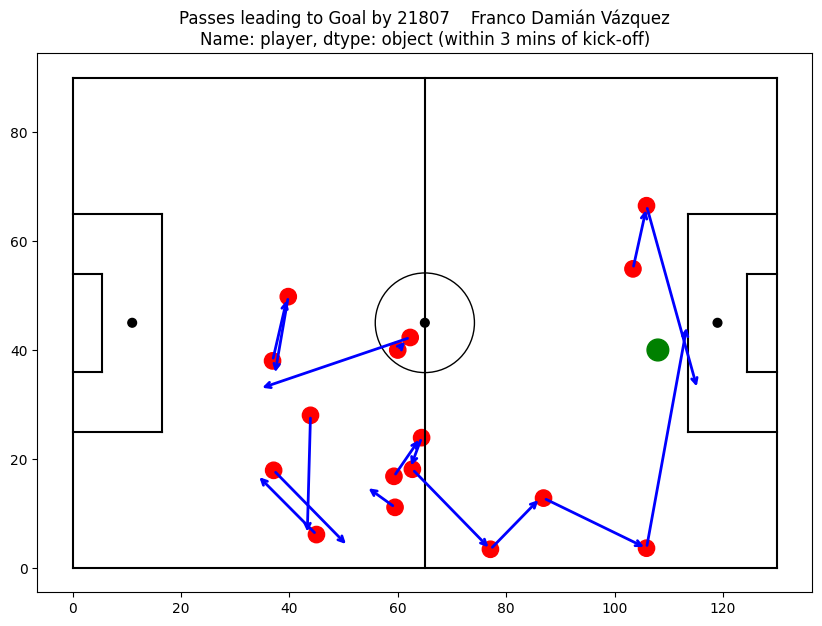

  Match ID: 3941022, Team: Turkey, Minute: 0


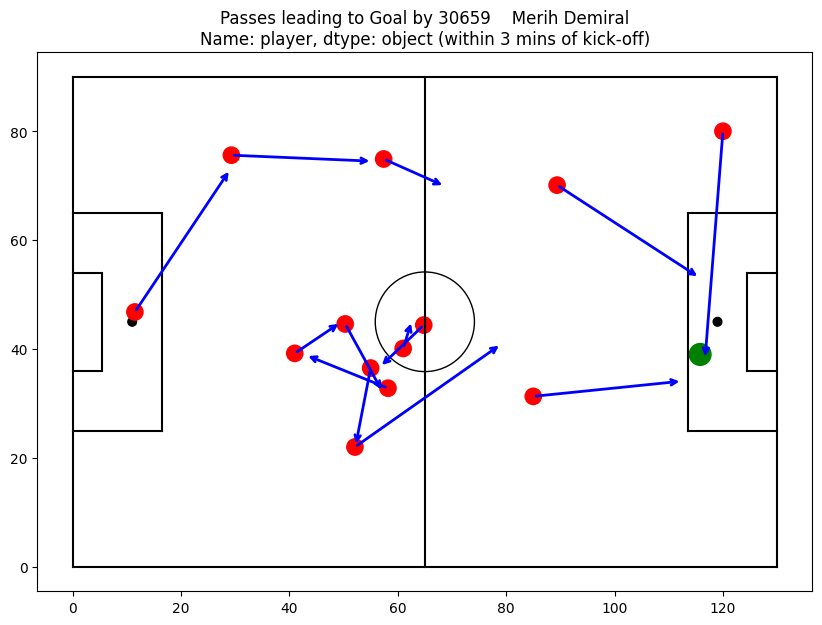


Cluster 1:
12
7536 Belgium 46
3754133 West Bromwich Albion 45
3754162 AFC Bournemouth 1
3754234 AFC Bournemouth 0
3788757 Denmark 1
3825572 Real Madrid 1
3825675 Athletic Club 0
3825688 Getafe 45
3829437 Angers 1
3879578 Bologna 46
3879635 Napoli 1
3890480 Schalke 04 1
12
Match IDs and Scoring Teams:
  Match ID: 7536, Team: Belgium, Minute: 46


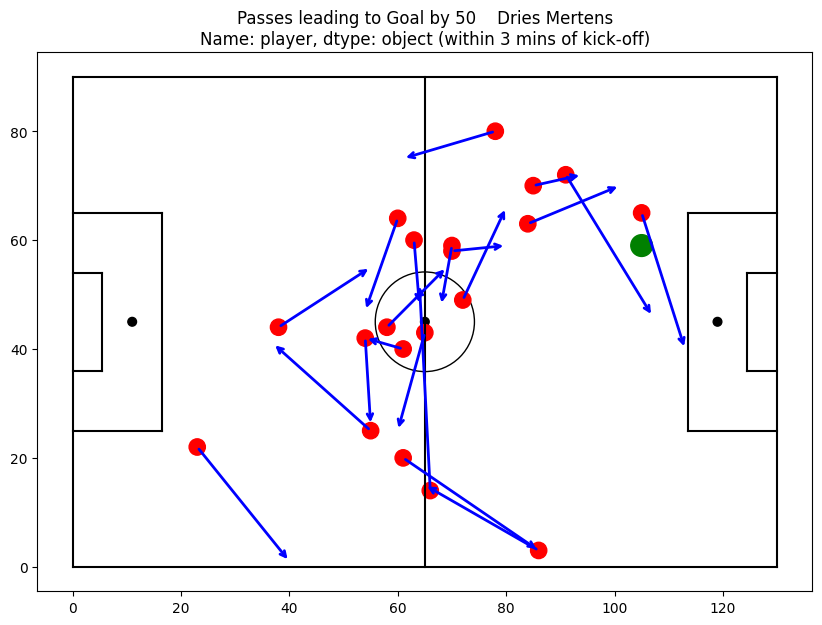

  Match ID: 3754133, Team: West Bromwich Albion, Minute: 45


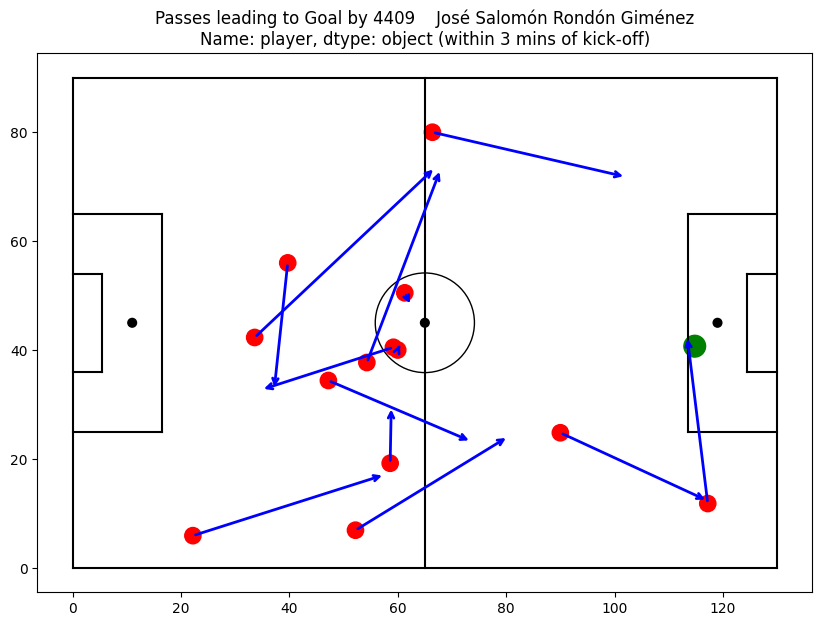

  Match ID: 3754162, Team: AFC Bournemouth, Minute: 1


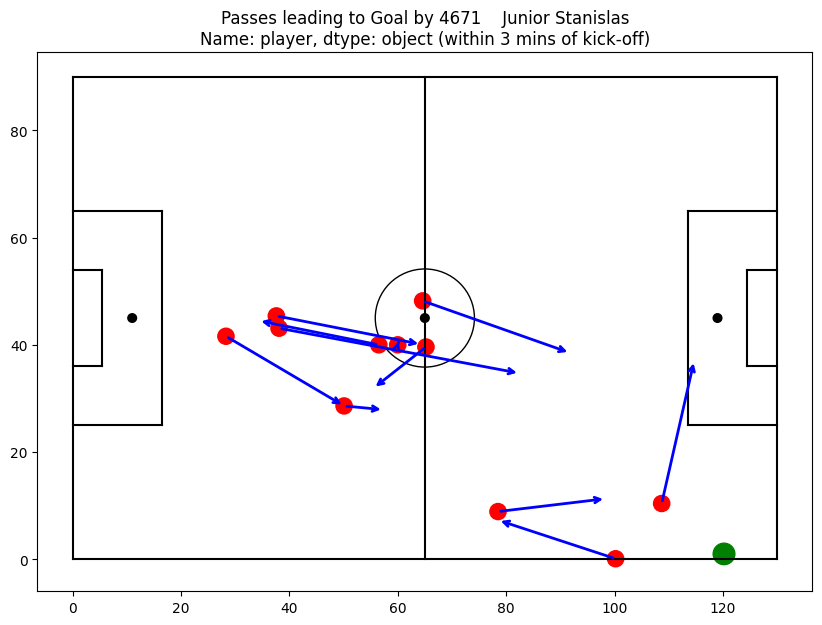

  Match ID: 3754234, Team: AFC Bournemouth, Minute: 0


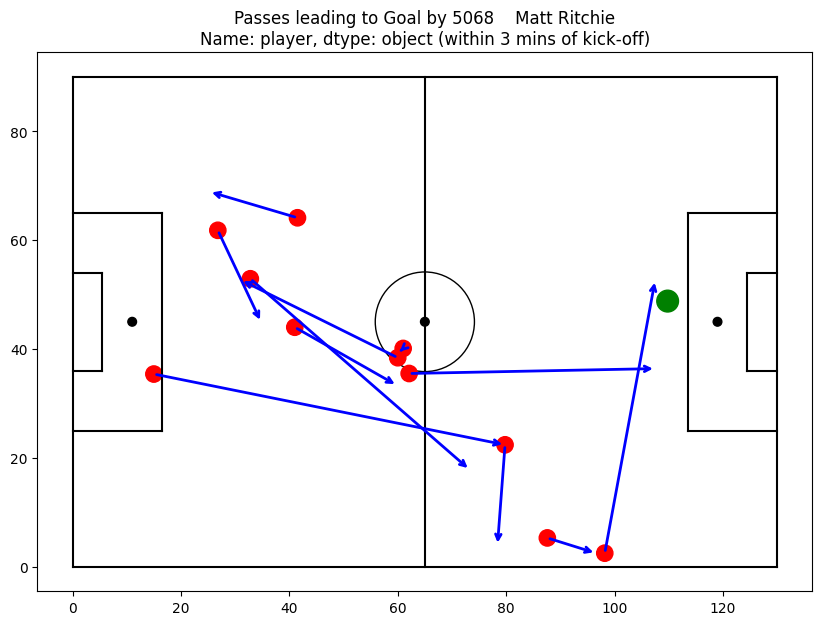

  Match ID: 3788757, Team: Denmark, Minute: 1


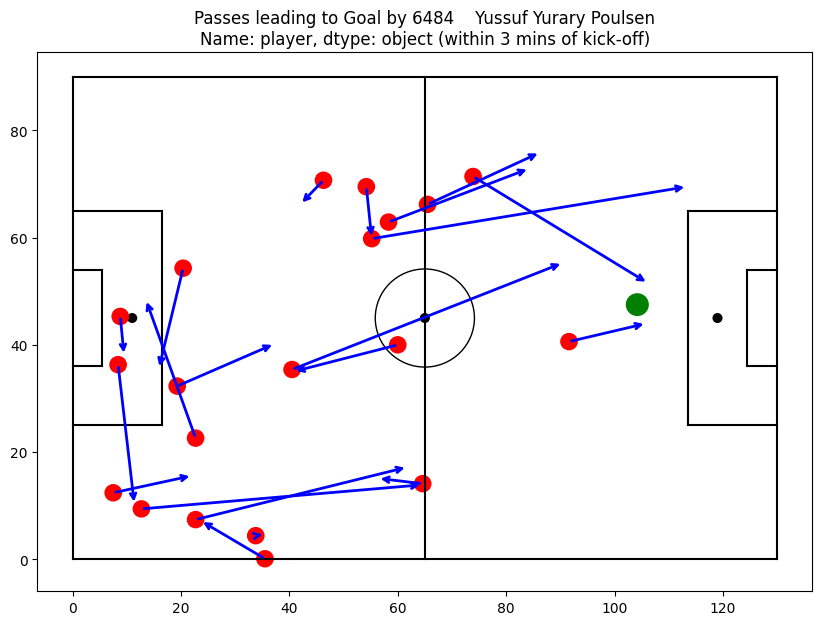

  Match ID: 3825572, Team: Real Madrid, Minute: 1


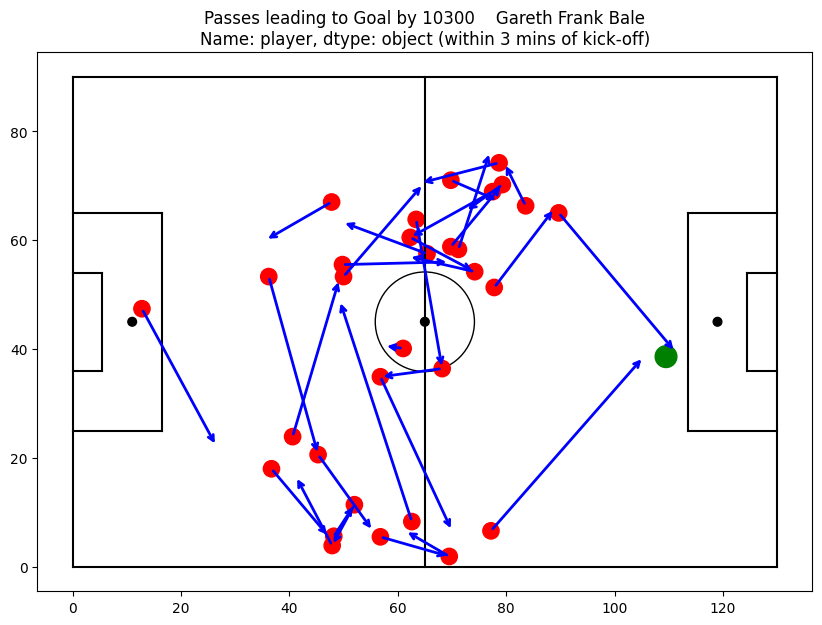

  Match ID: 3825675, Team: Athletic Club, Minute: 0


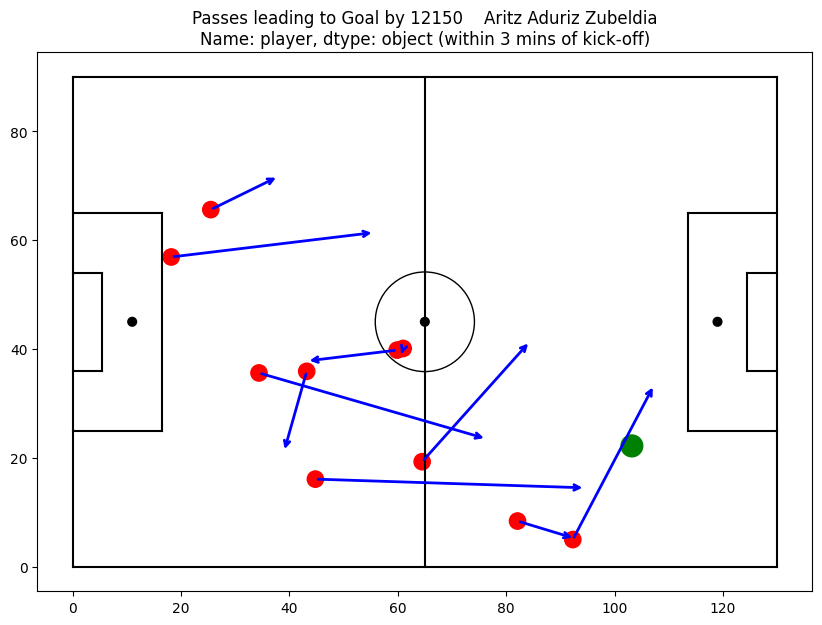

  Match ID: 3825688, Team: Getafe, Minute: 45


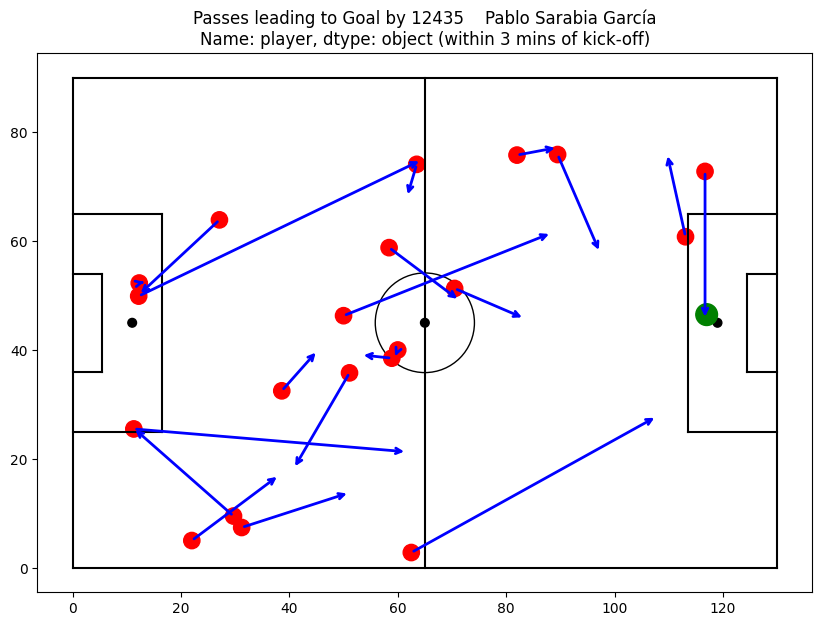

  Match ID: 3829437, Team: Angers, Minute: 1


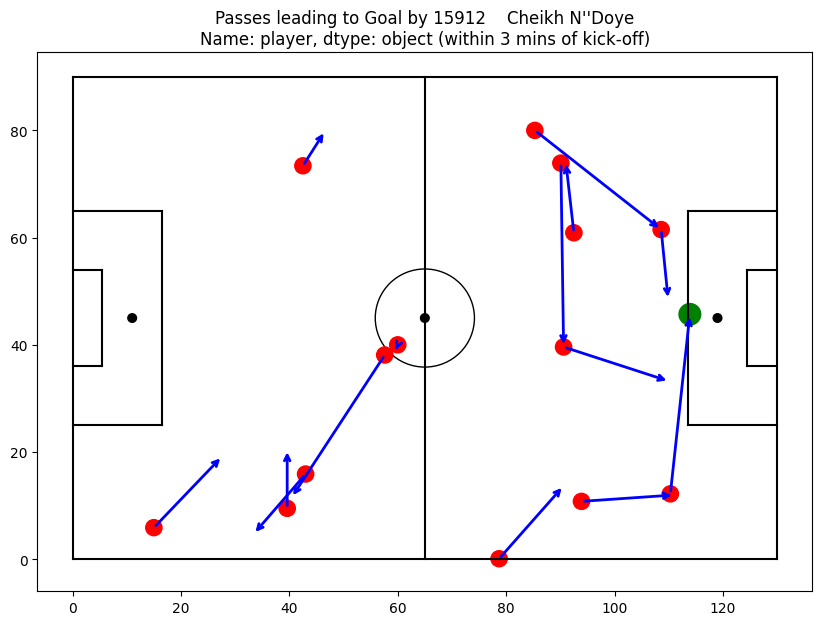

  Match ID: 3879578, Team: Bologna, Minute: 46


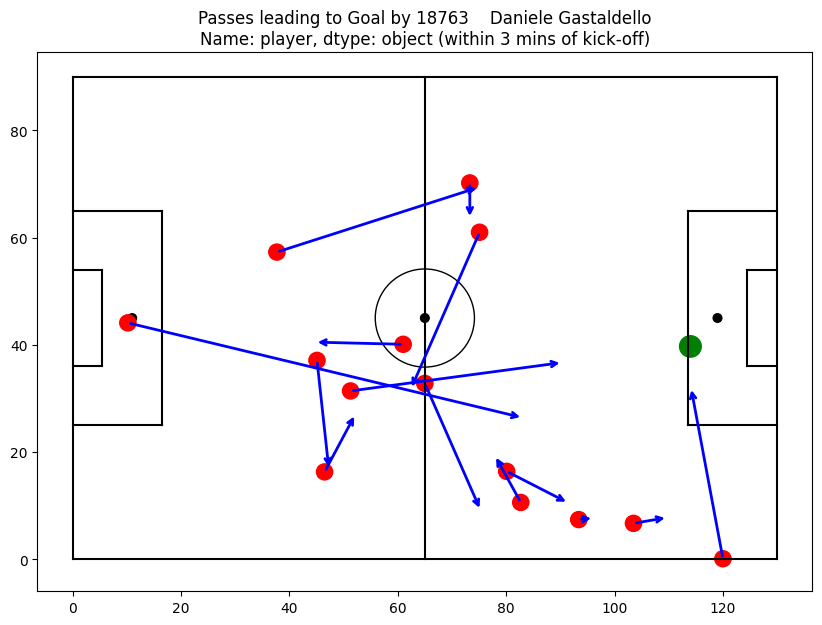

  Match ID: 3879635, Team: Napoli, Minute: 1


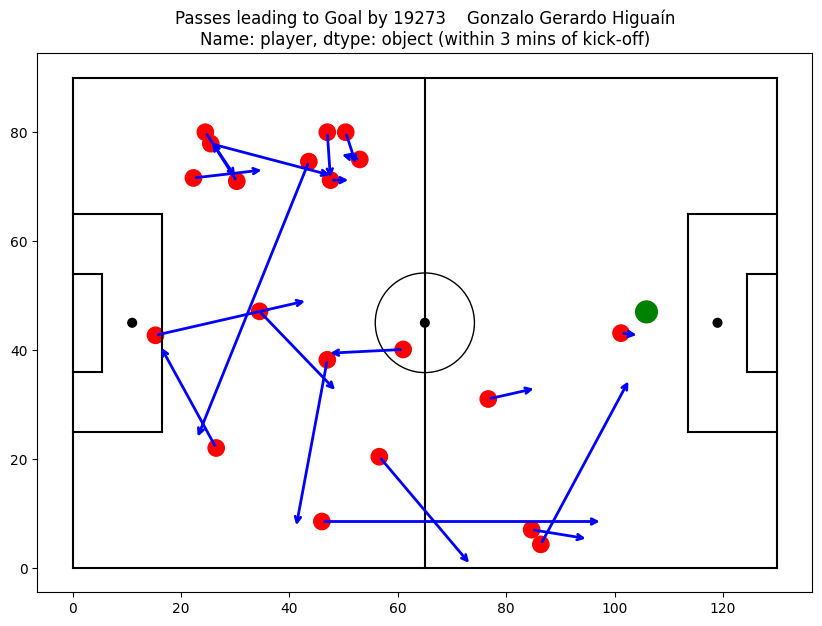

  Match ID: 3890480, Team: Schalke 04, Minute: 1


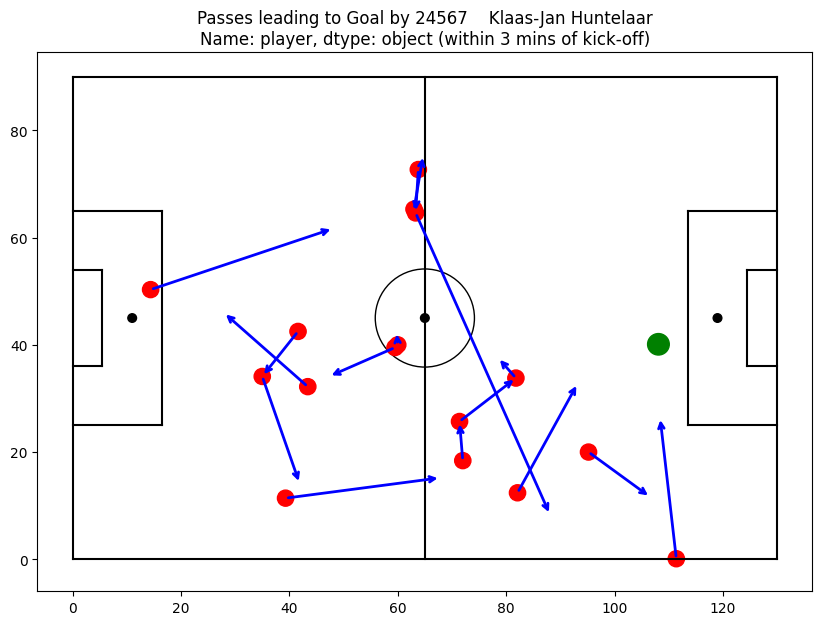


Cluster 2:
16
3754008 Manchester United 45
3754182 Norwich City 46
3754271 Watford 45
3754319 Manchester United 46
3813314 ATK Mohun Bagan 1
3817890 NorthEast United 1
3825611 RC Deportivo La Coruña 46
3825654 Valencia 45
3829441 Marseille 46
3829456 Lorient 45
3879684 Juventus 45
3879692 Empoli 46
3900612 Guingamp 45
3901205 Lorient 46
3922244 Mali 46
3939986 Argentina 46
16
Match IDs and Scoring Teams:
  Match ID: 3754008, Team: Manchester United, Minute: 45


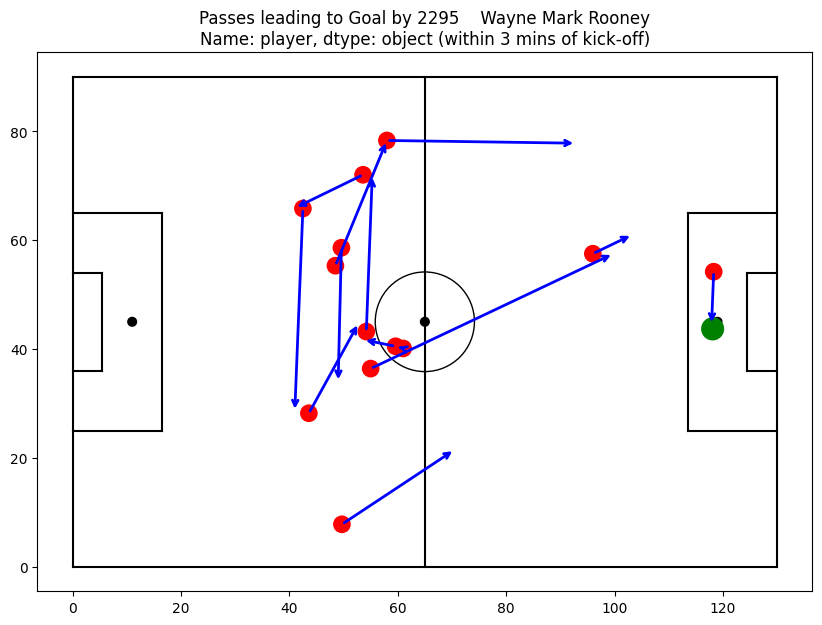

  Match ID: 3754182, Team: Norwich City, Minute: 46


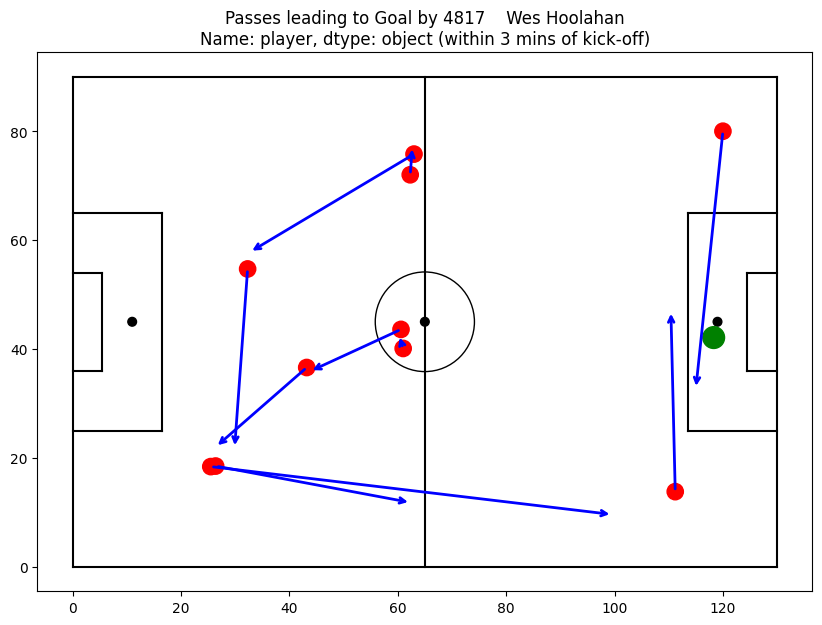

  Match ID: 3754271, Team: Watford, Minute: 45


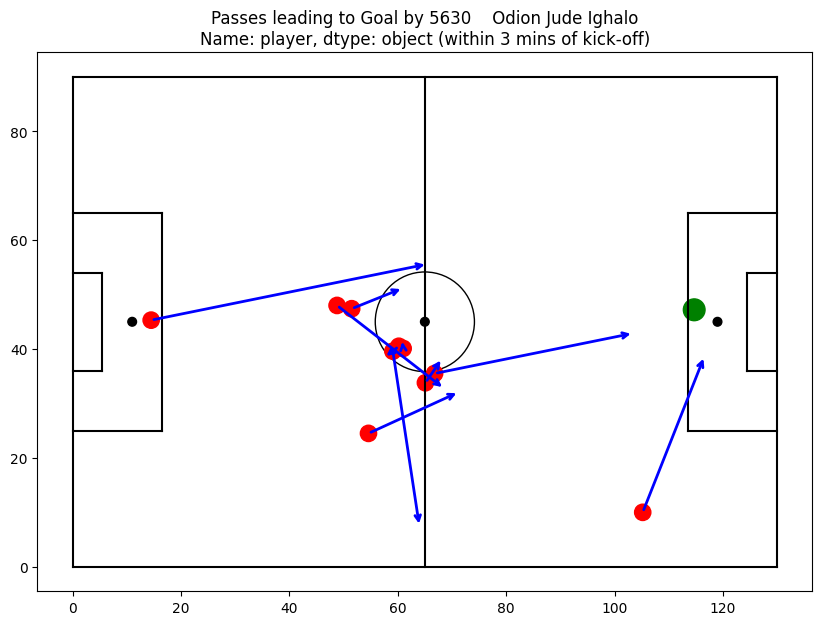

  Match ID: 3754319, Team: Manchester United, Minute: 46


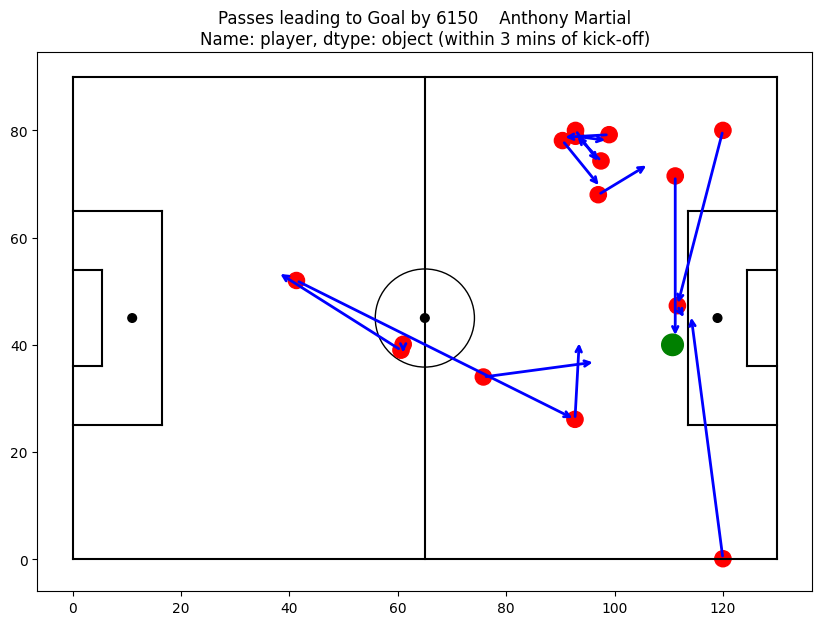

  Match ID: 3813314, Team: ATK Mohun Bagan, Minute: 1


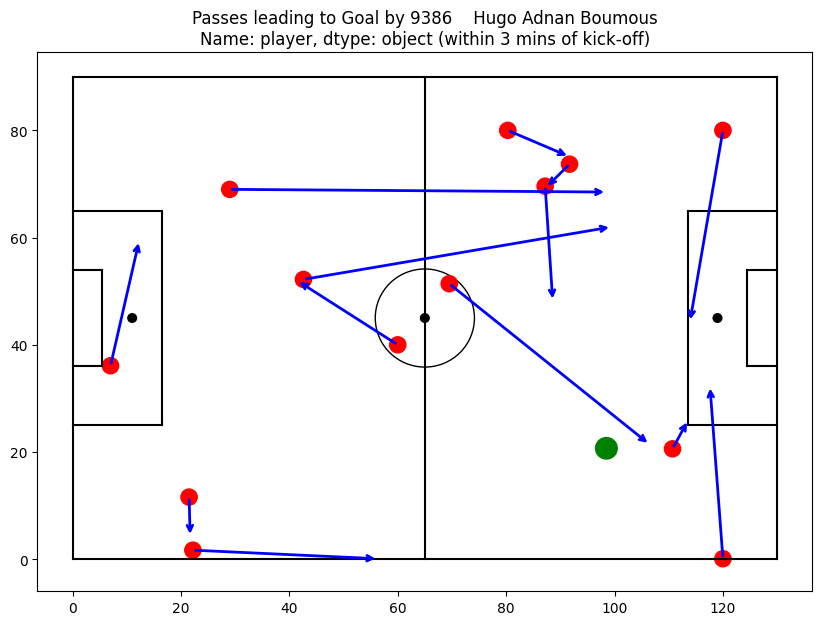

  Match ID: 3817890, Team: NorthEast United, Minute: 1


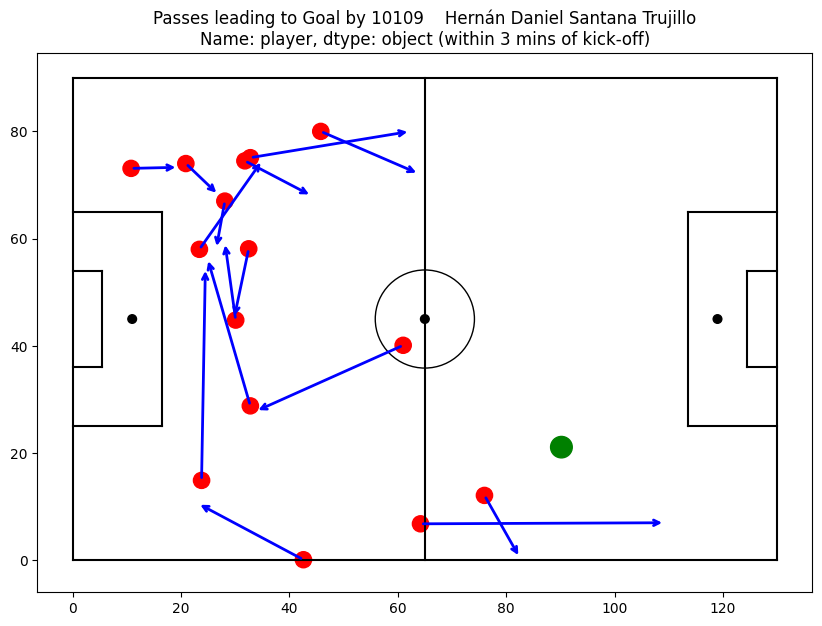

  Match ID: 3825611, Team: RC Deportivo La Coruña, Minute: 46


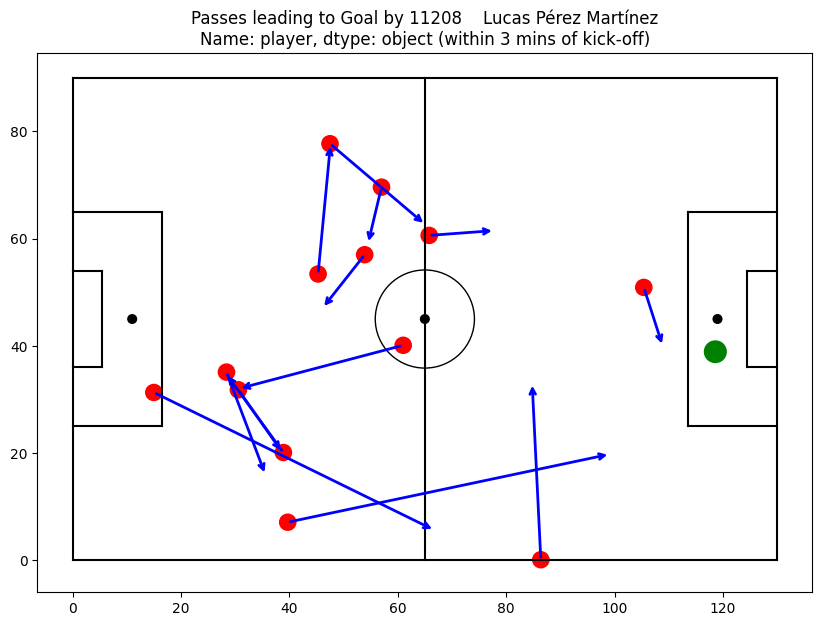

  Match ID: 3825654, Team: Valencia, Minute: 45


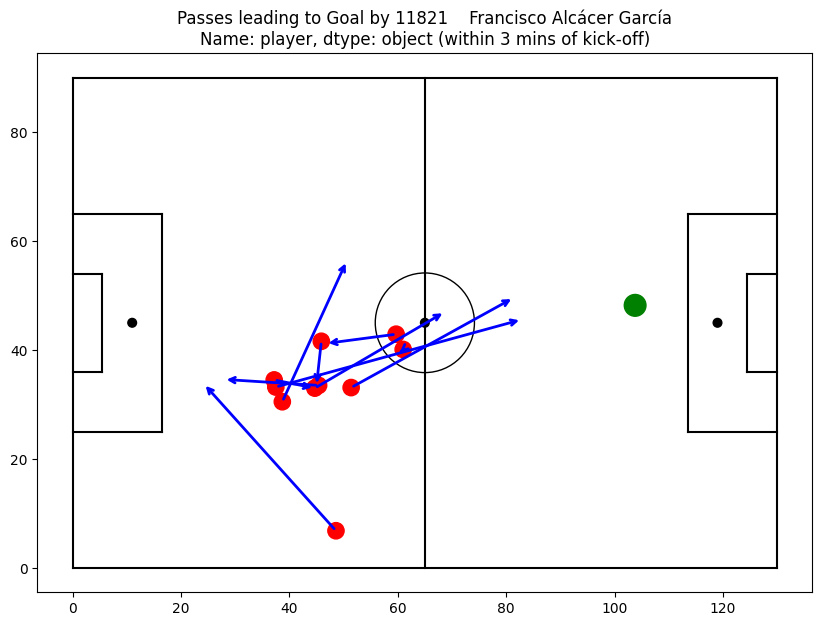

  Match ID: 3829441, Team: Marseille, Minute: 46


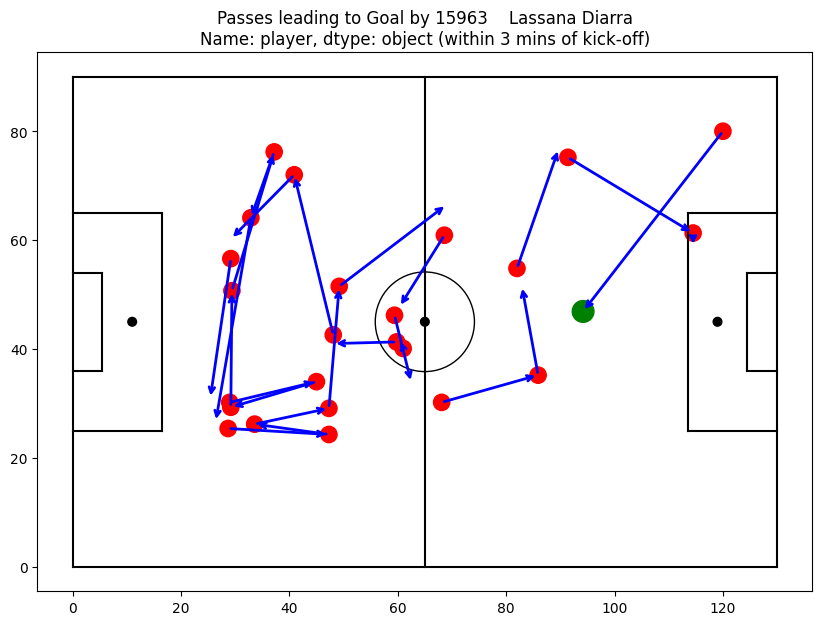

  Match ID: 3829456, Team: Lorient, Minute: 45


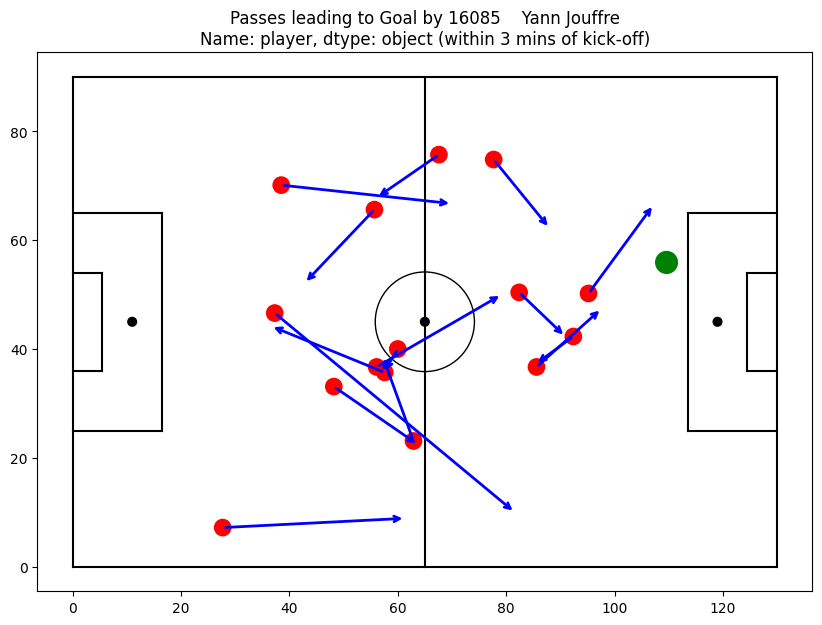

  Match ID: 3879684, Team: Juventus, Minute: 45


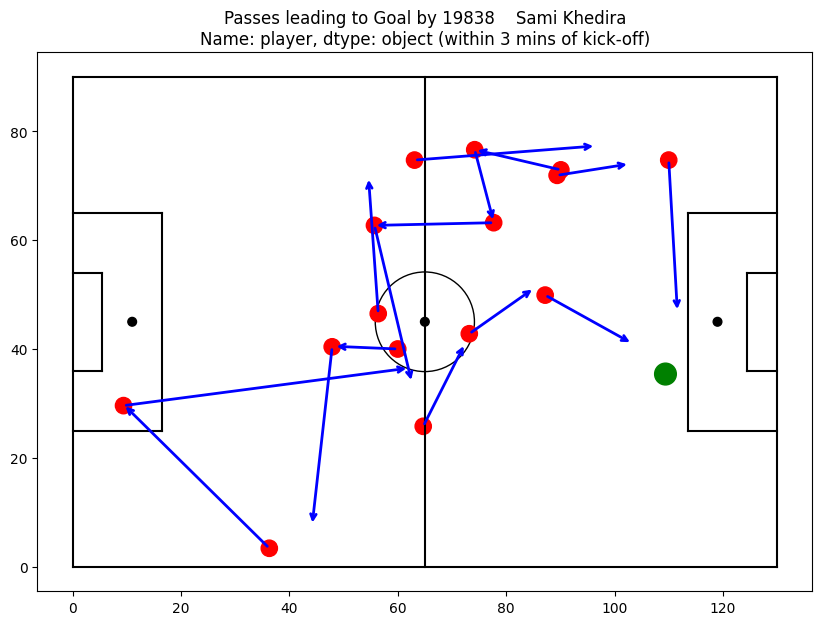

  Match ID: 3879692, Team: Empoli, Minute: 46


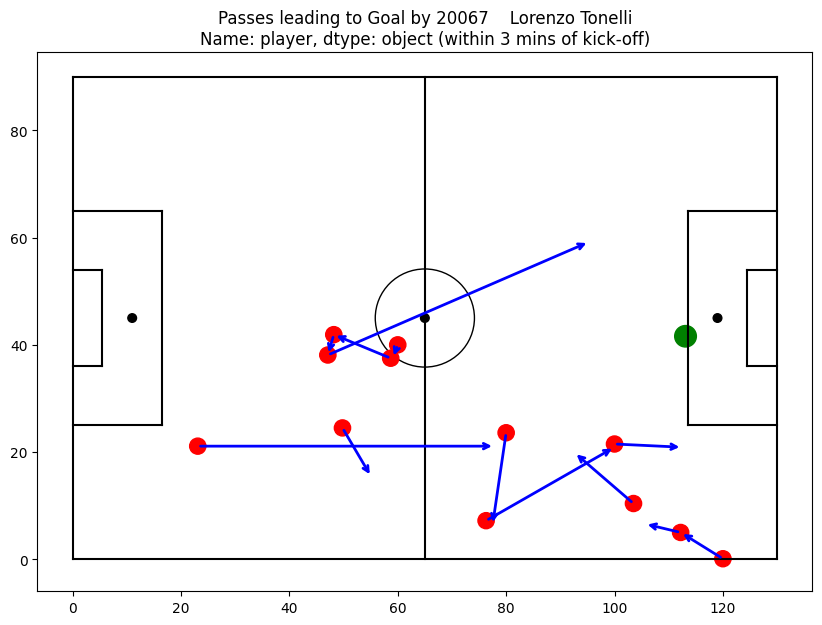

  Match ID: 3900612, Team: Guingamp, Minute: 45


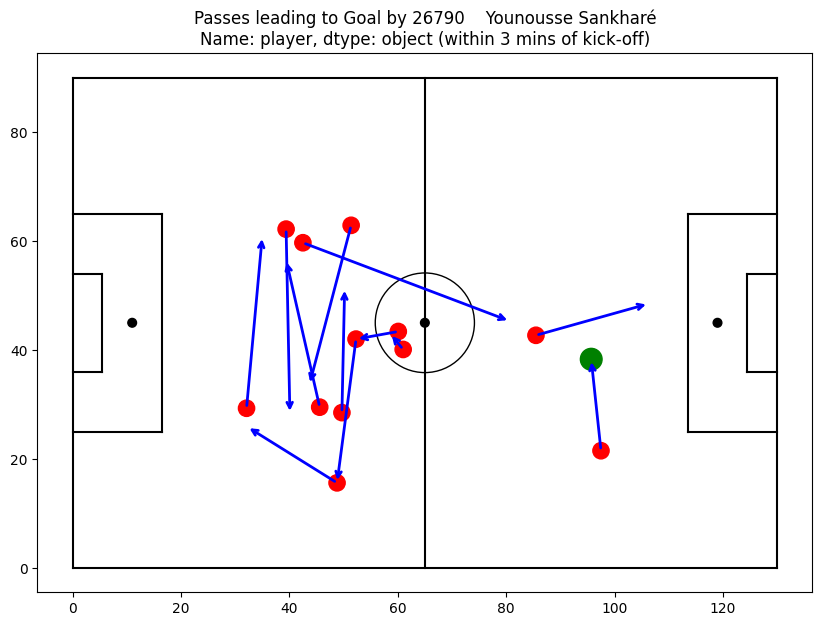

  Match ID: 3901205, Team: Lorient, Minute: 46


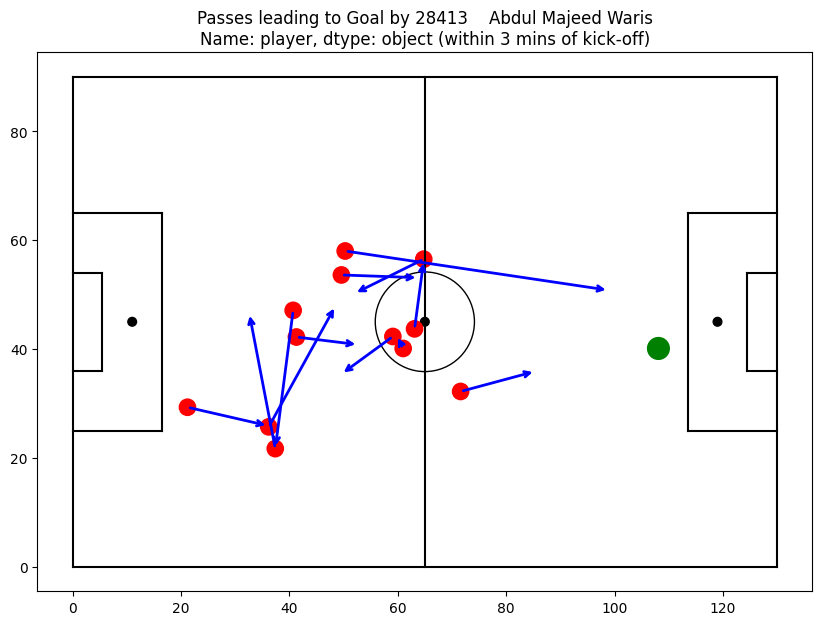

  Match ID: 3922244, Team: Mali, Minute: 46


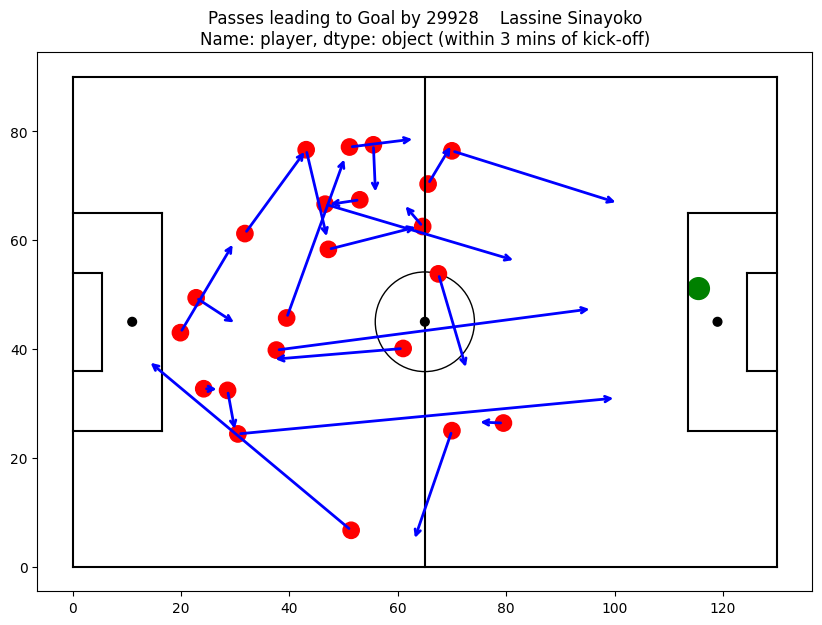

  Match ID: 3939986, Team: Argentina, Minute: 46


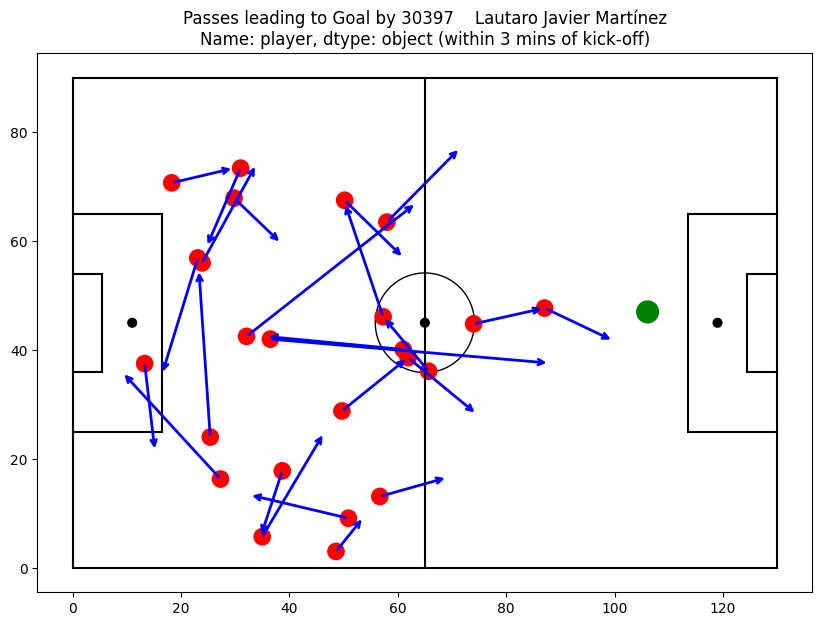


Cluster 3:
8
3754303 Crystal Palace 46
3890282 FSV Mainz 05 46
3890418 Darmstadt 98 46
3890438 Hamburger SV 46
3890540 Bayer Leverkusen 1
3901258 OGC Nice 1
3920385 Egypt 1
3930175 Belgium 1
8
Match IDs and Scoring Teams:
  Match ID: 3754303, Team: Crystal Palace, Minute: 46


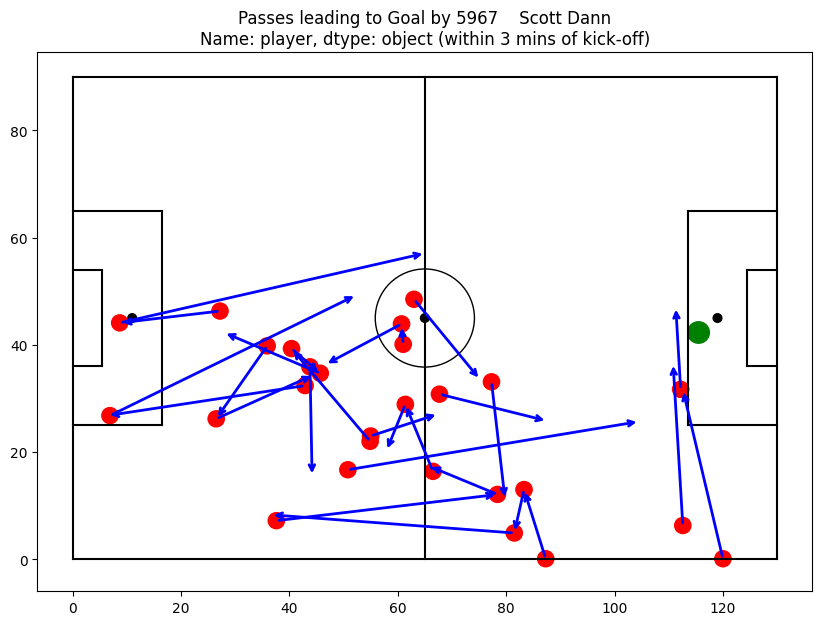

  Match ID: 3890282, Team: FSV Mainz 05, Minute: 46


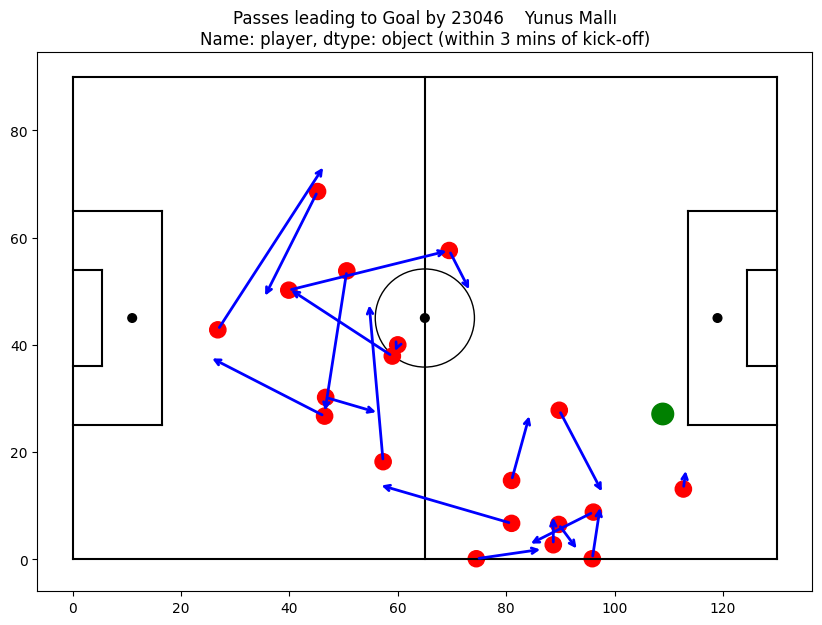

  Match ID: 3890418, Team: Darmstadt 98, Minute: 46


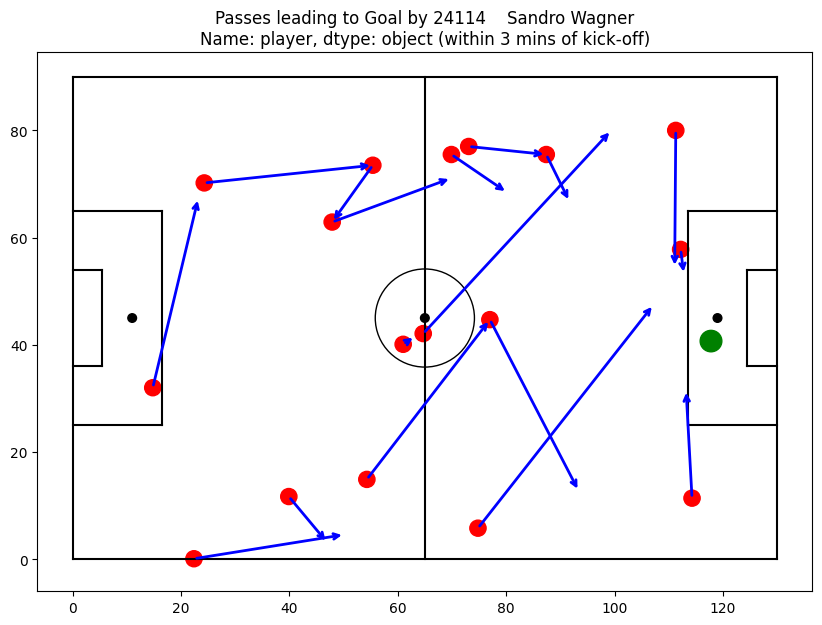

  Match ID: 3890438, Team: Hamburger SV, Minute: 46


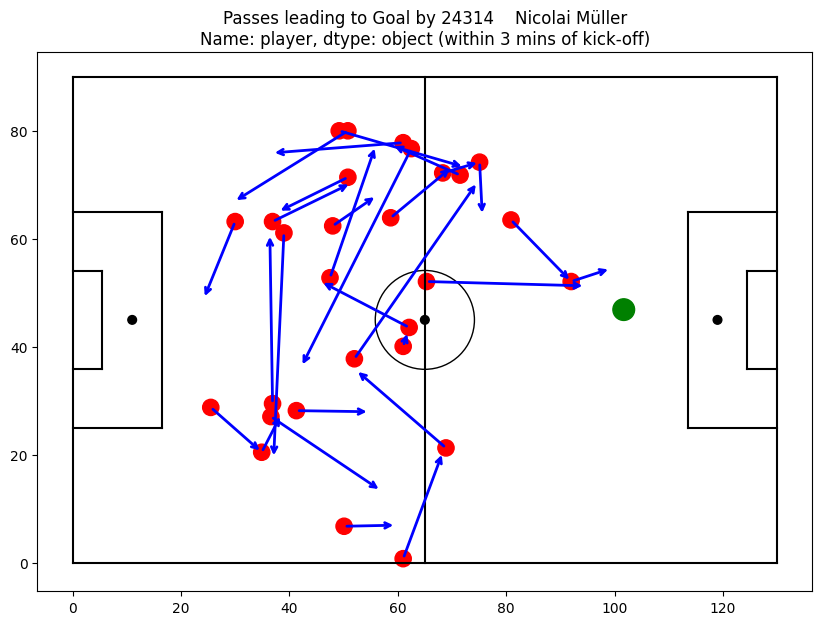

  Match ID: 3890540, Team: Bayer Leverkusen, Minute: 1


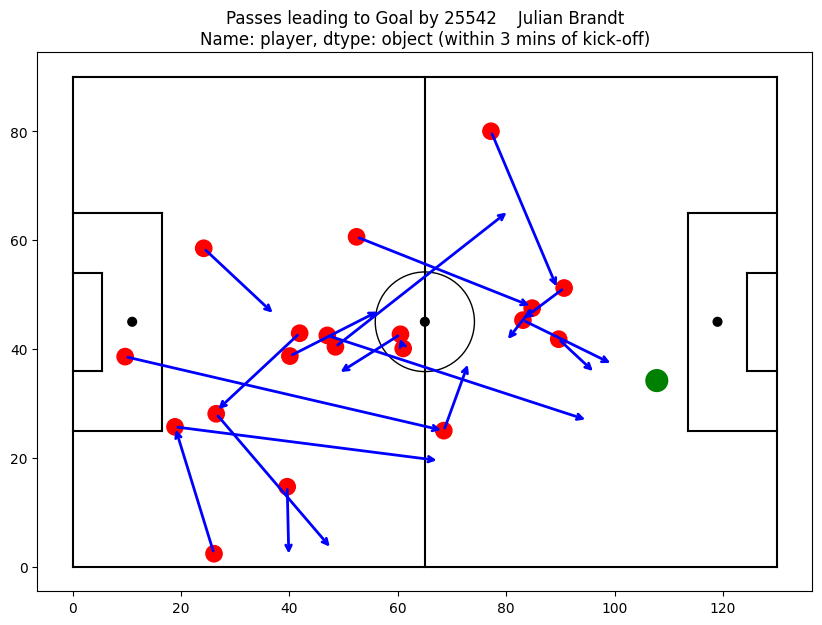

  Match ID: 3901258, Team: OGC Nice, Minute: 1


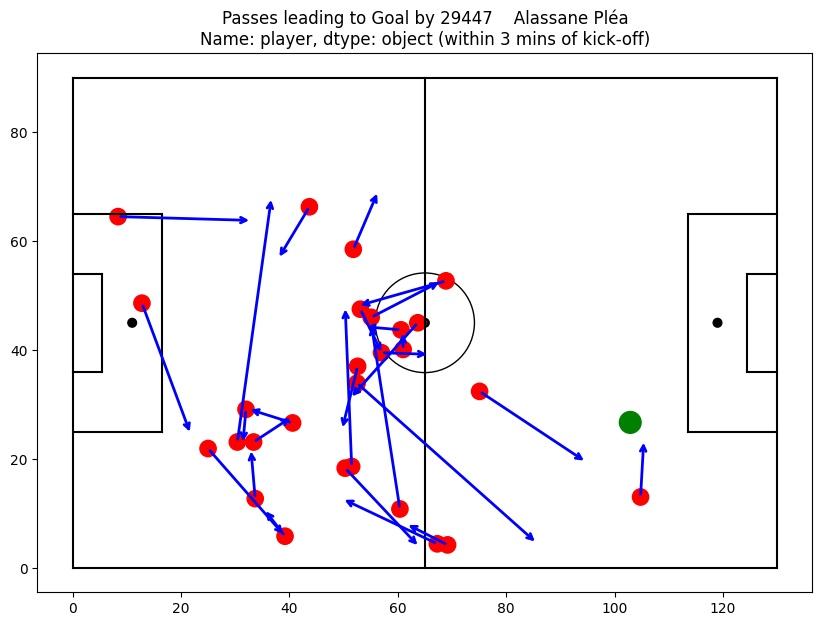

  Match ID: 3920385, Team: Egypt, Minute: 1


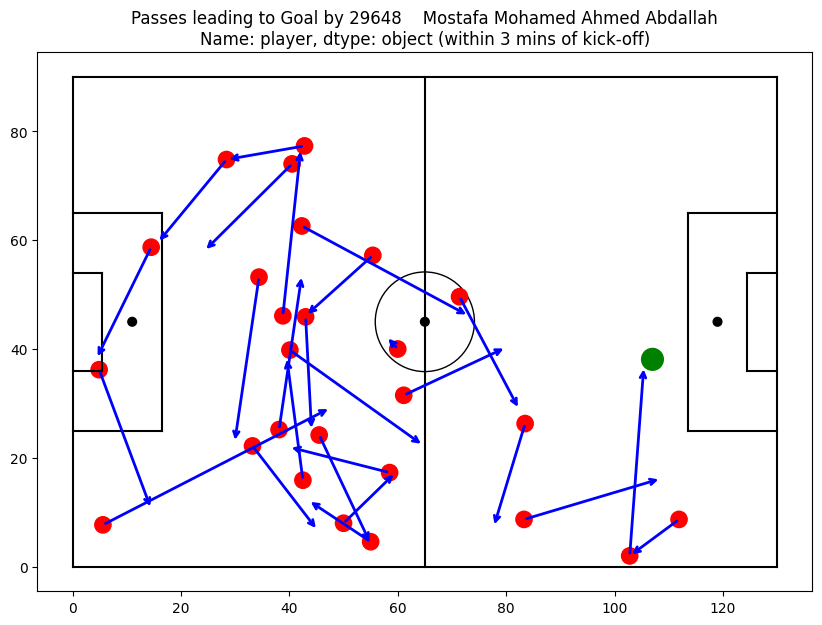

  Match ID: 3930175, Team: Belgium, Minute: 1


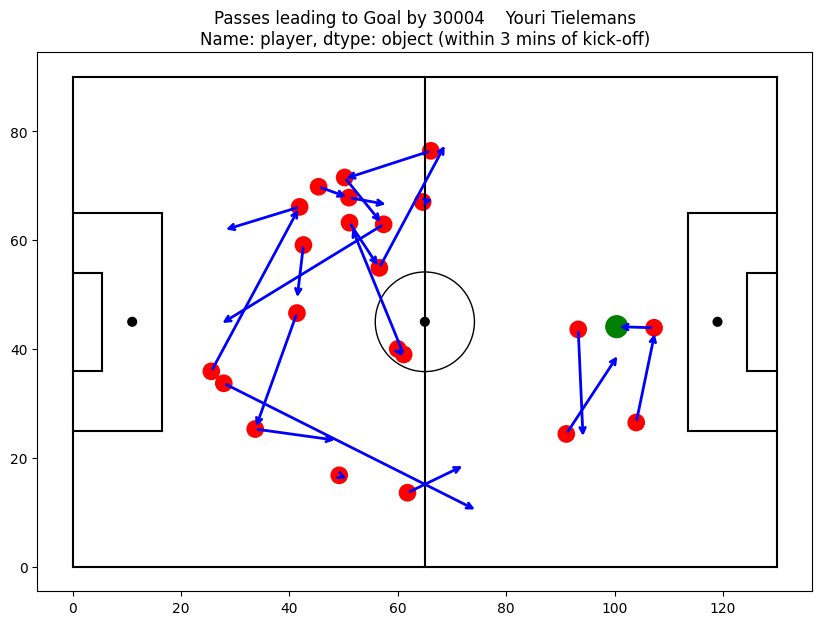


Cluster 4:
16
3754226 Liverpool 45
3788749 Poland 45
3788760 Croatia 46
3825758 RC Deportivo La Coruña 45
3825863 RC Deportivo La Coruña 46
3829461 Marseille 45
3829469 AS Monaco 46
3857264 Argentina 45
3857281 Canada 1
3879570 Chievo 0
3879694 Bologna 1
3890535 Augsburg 0
3900492 Guingamp 0
3901145 Montpellier 1
3901178 Marseille 45
3901197 Guingamp 46
16
Match IDs and Scoring Teams:
  Match ID: 3754226, Team: Liverpool, Minute: 45


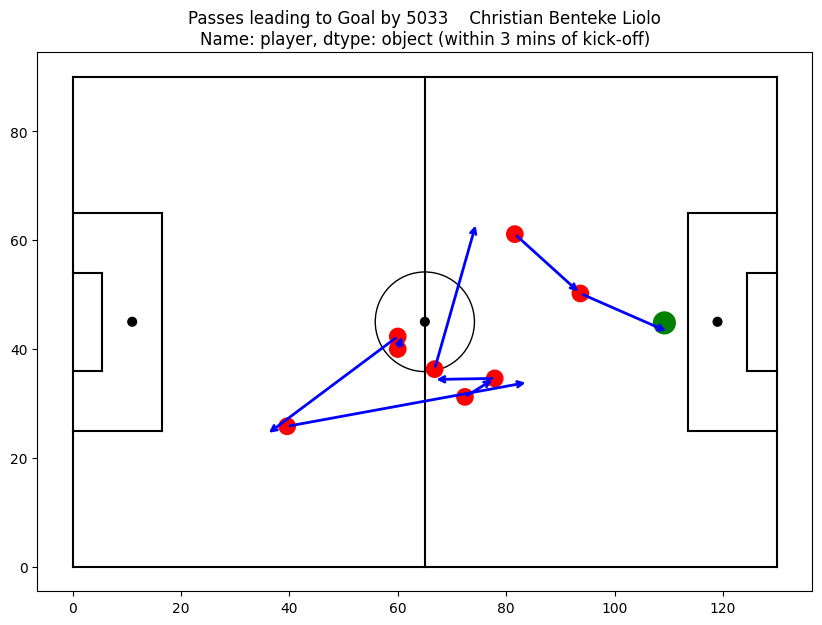

  Match ID: 3788749, Team: Poland, Minute: 45


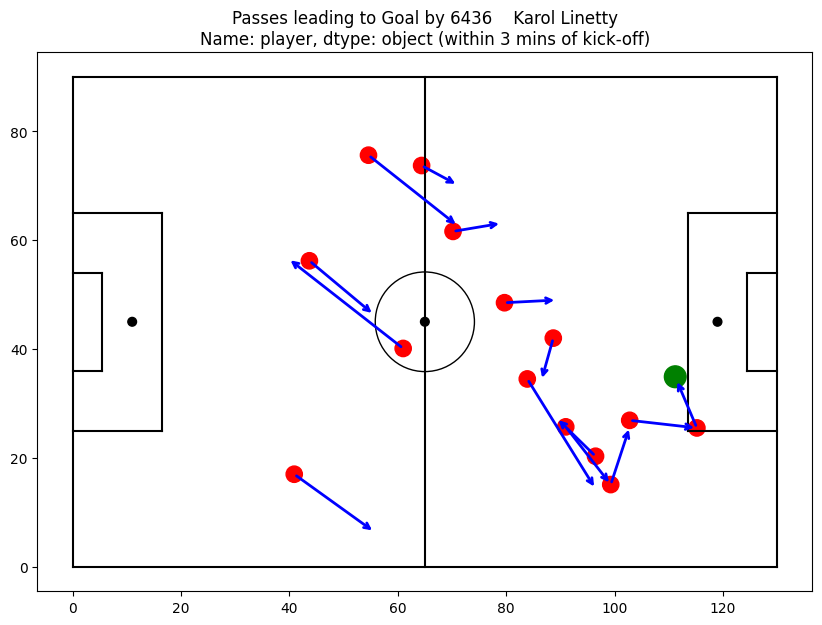

  Match ID: 3788760, Team: Croatia, Minute: 46


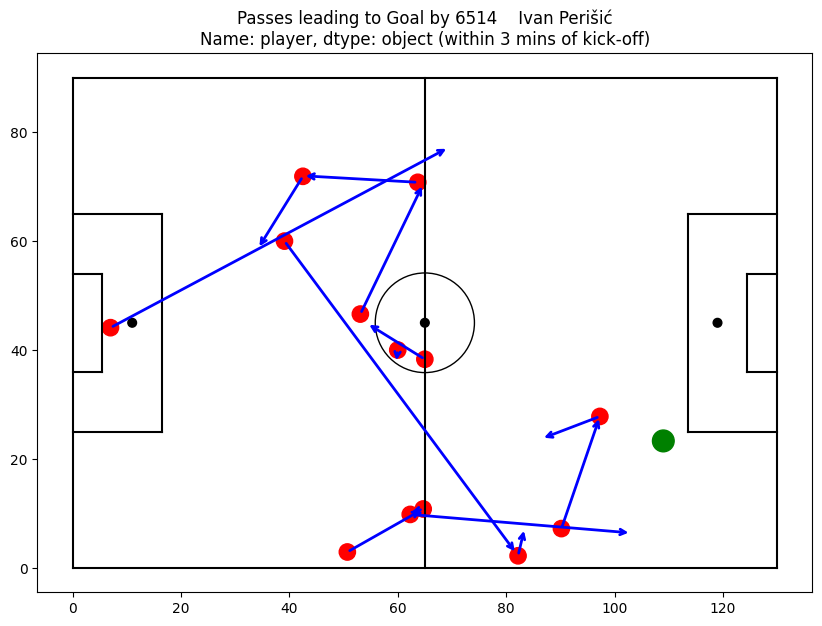

  Match ID: 3825758, Team: RC Deportivo La Coruña, Minute: 45


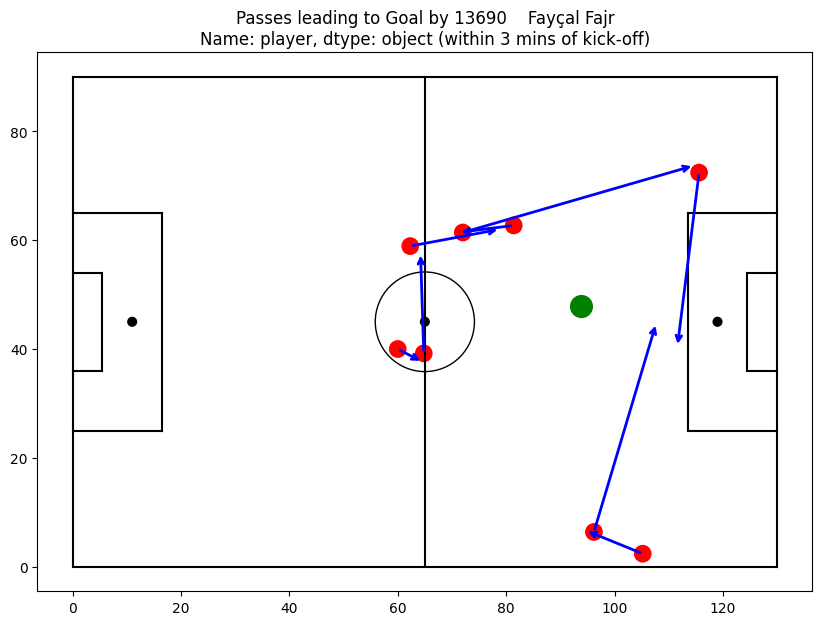

  Match ID: 3825863, Team: RC Deportivo La Coruña, Minute: 46


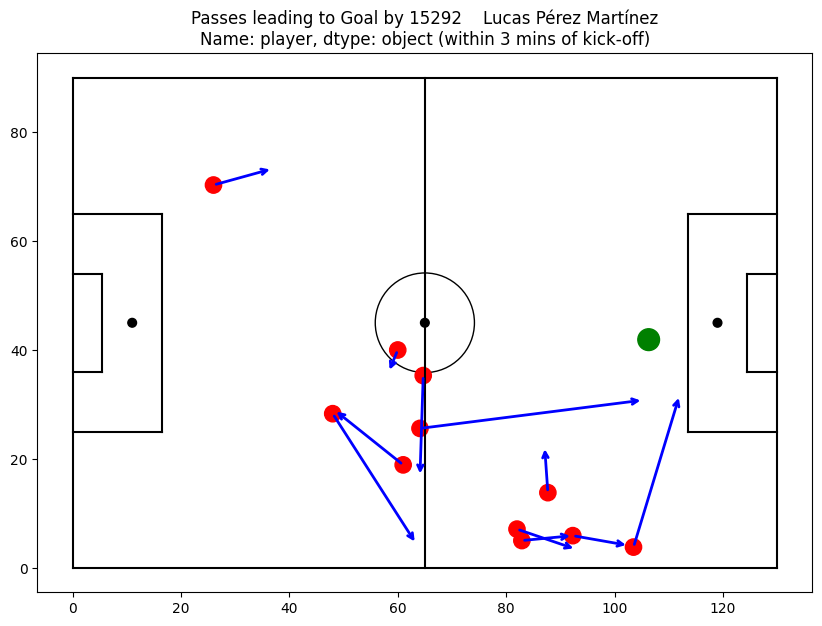

  Match ID: 3829461, Team: Marseille, Minute: 45


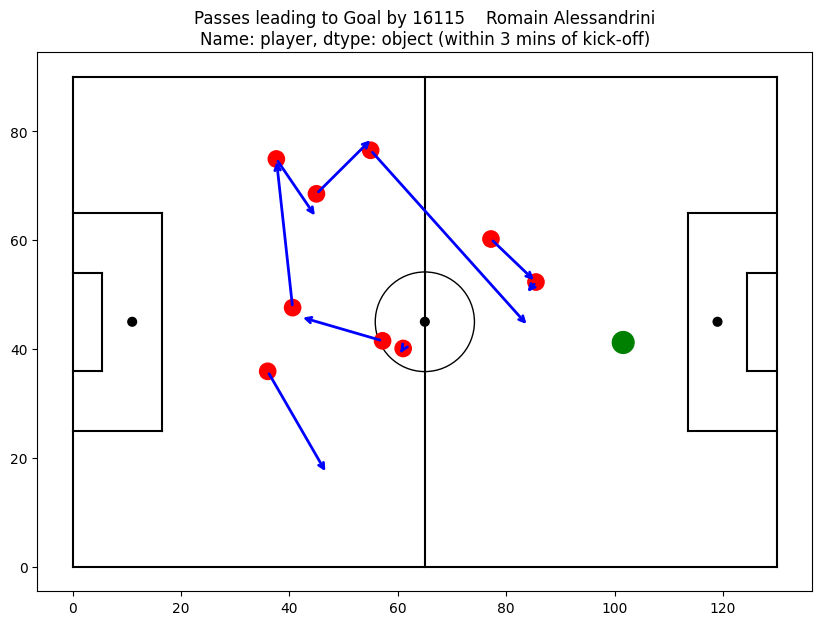

  Match ID: 3829469, Team: AS Monaco, Minute: 46


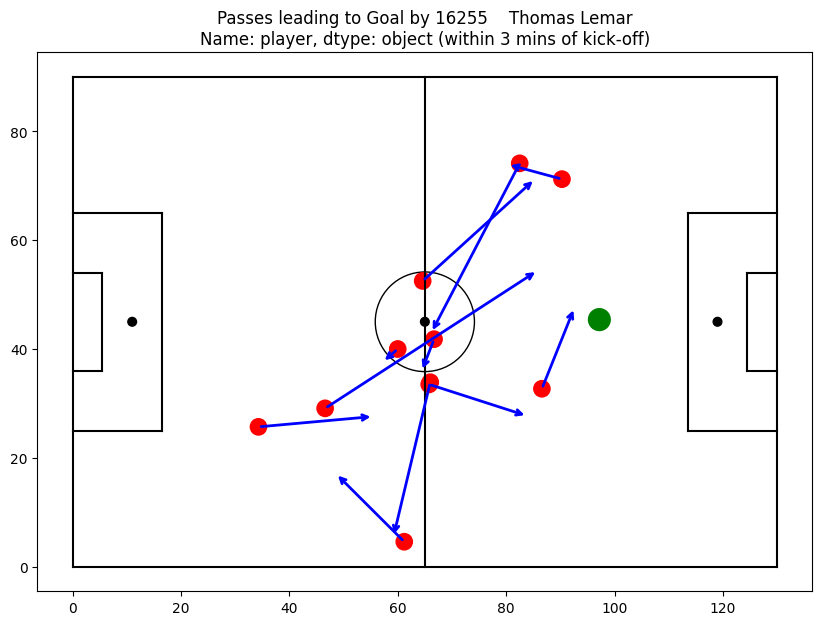

  Match ID: 3857264, Team: Argentina, Minute: 45


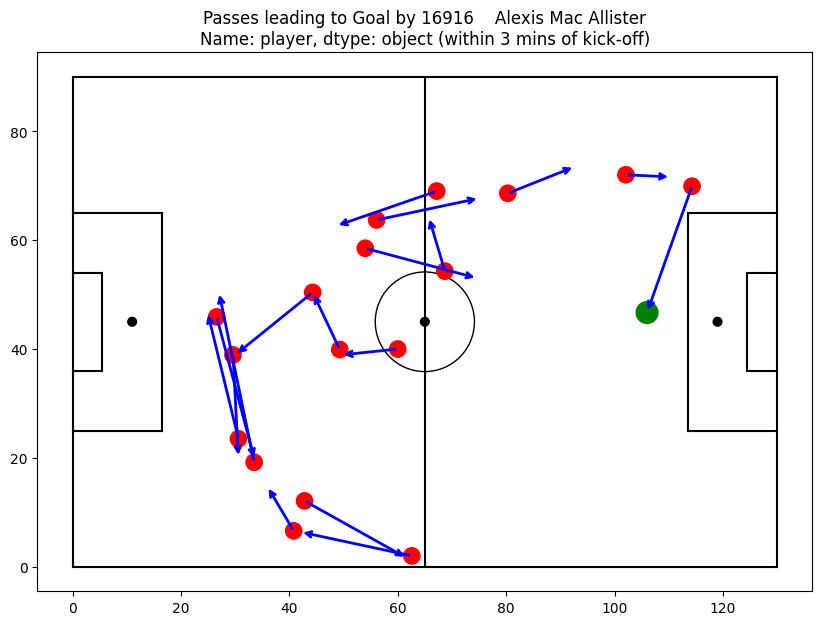

  Match ID: 3857281, Team: Canada, Minute: 1


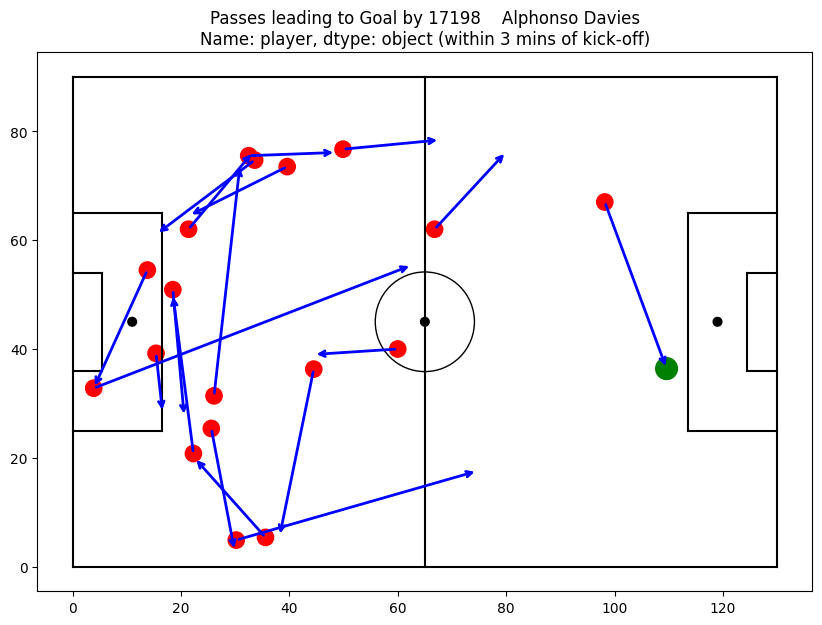

  Match ID: 3879570, Team: Chievo, Minute: 0


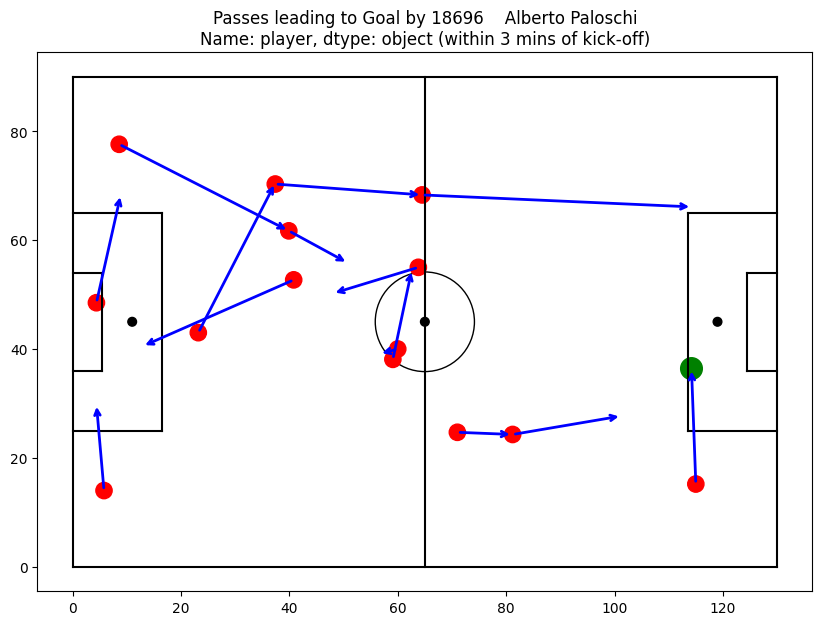

  Match ID: 3879694, Team: Bologna, Minute: 1


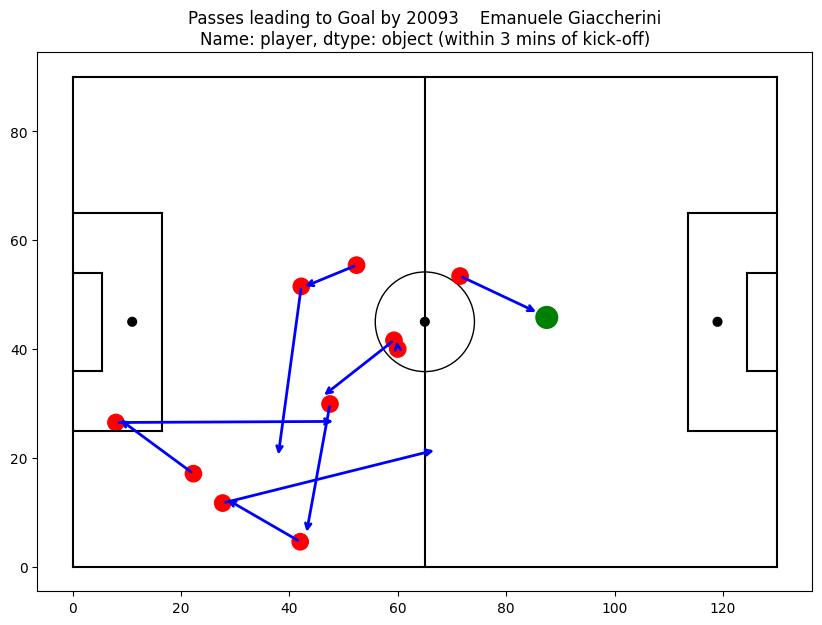

  Match ID: 3890535, Team: Augsburg, Minute: 0


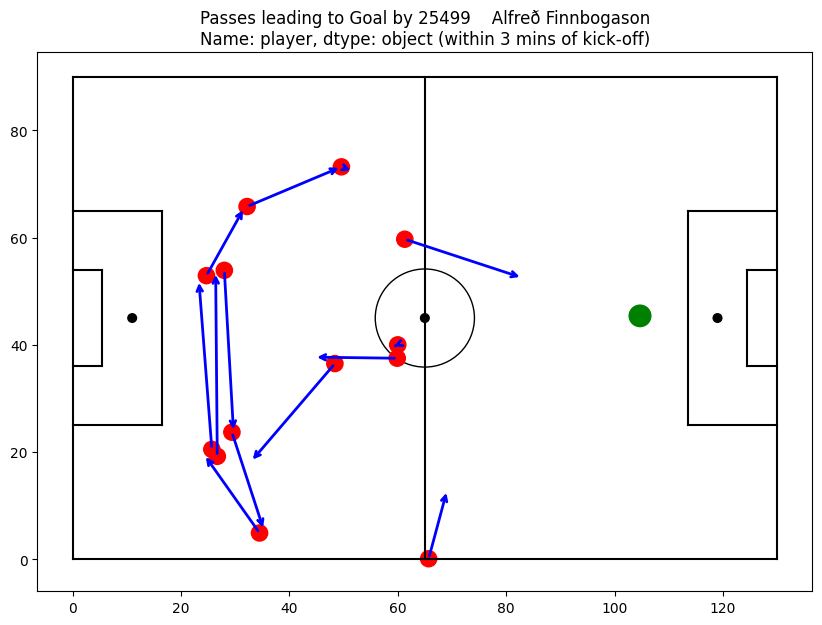

  Match ID: 3900492, Team: Guingamp, Minute: 0


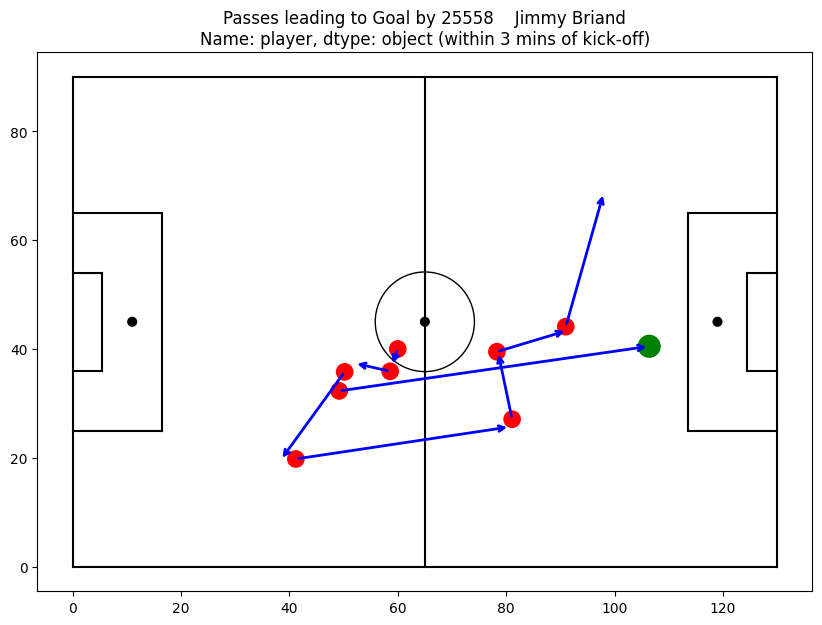

  Match ID: 3901145, Team: Montpellier, Minute: 1


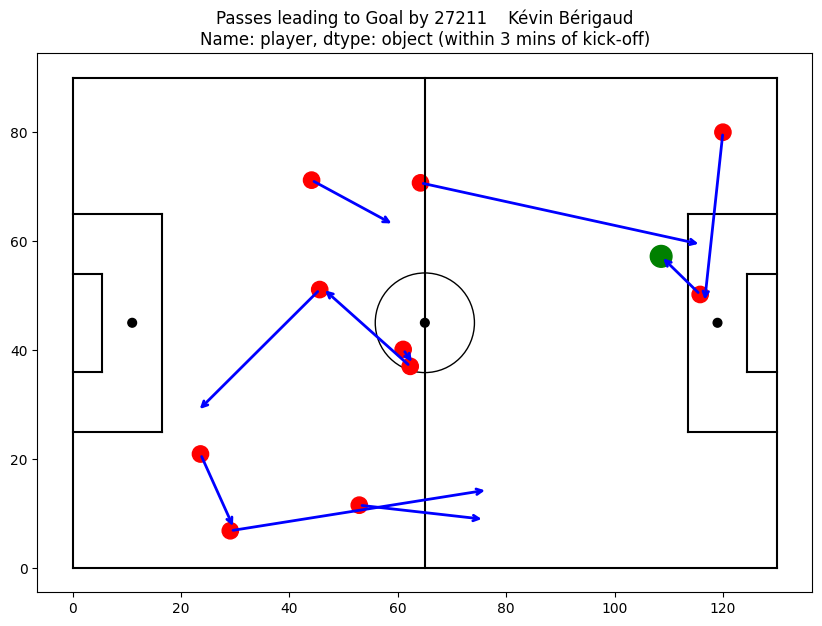

  Match ID: 3901178, Team: Marseille, Minute: 45


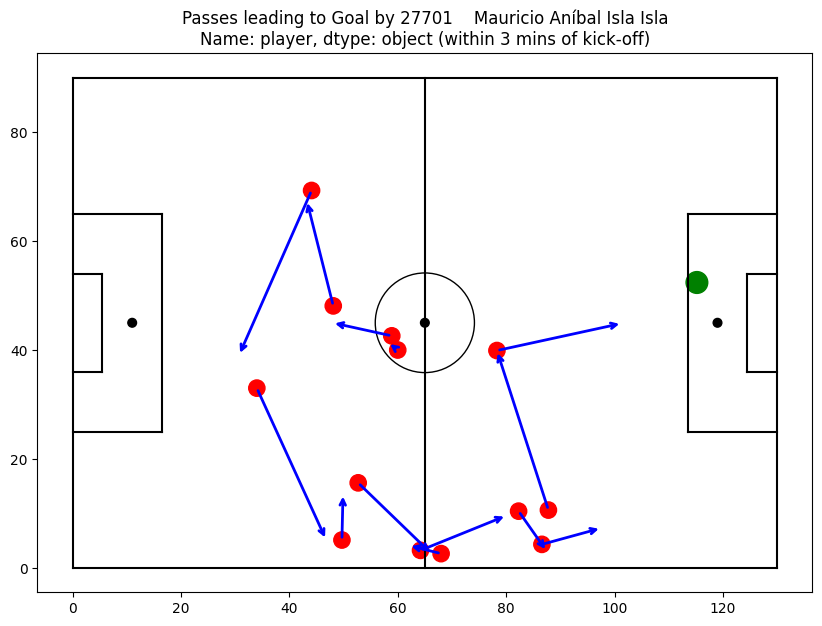

  Match ID: 3901197, Team: Guingamp, Minute: 46


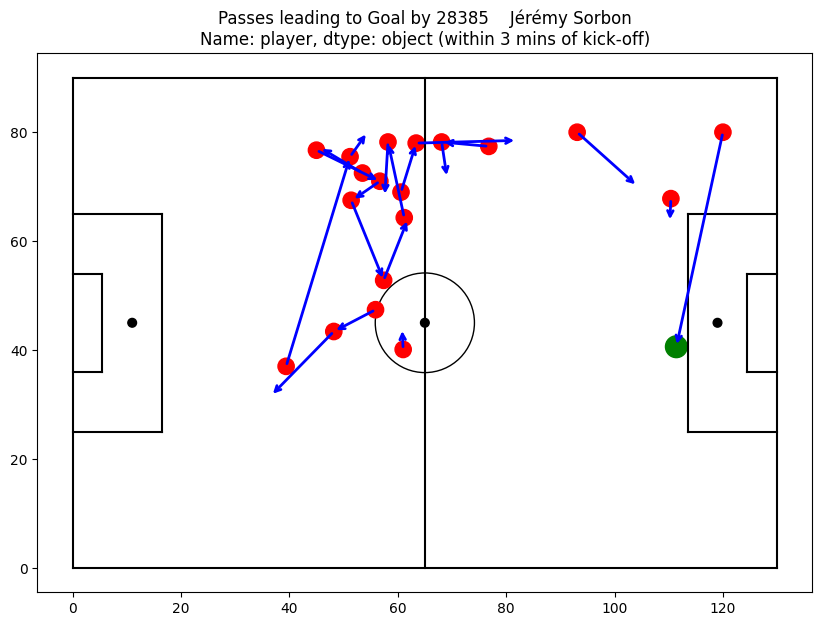


Cluster 5:
6
3754335 Leicester City 46
3788776 Sweden 1
3879564 AS Roma 1
3879724 Fiorentina 1
3900543 Troyes 46
3938644 Georgia 1
6
Match IDs and Scoring Teams:
  Match ID: 3754335, Team: Leicester City, Minute: 46


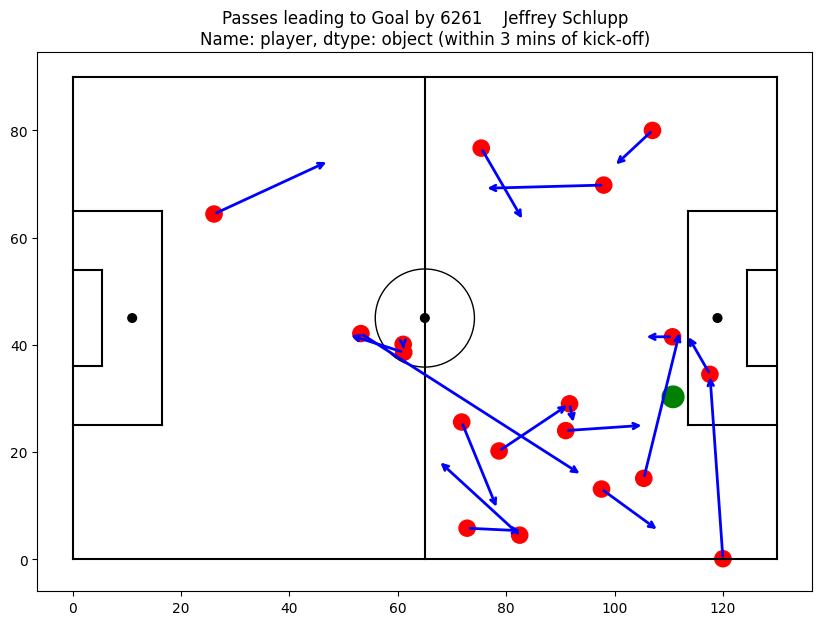

  Match ID: 3788776, Team: Sweden, Minute: 1


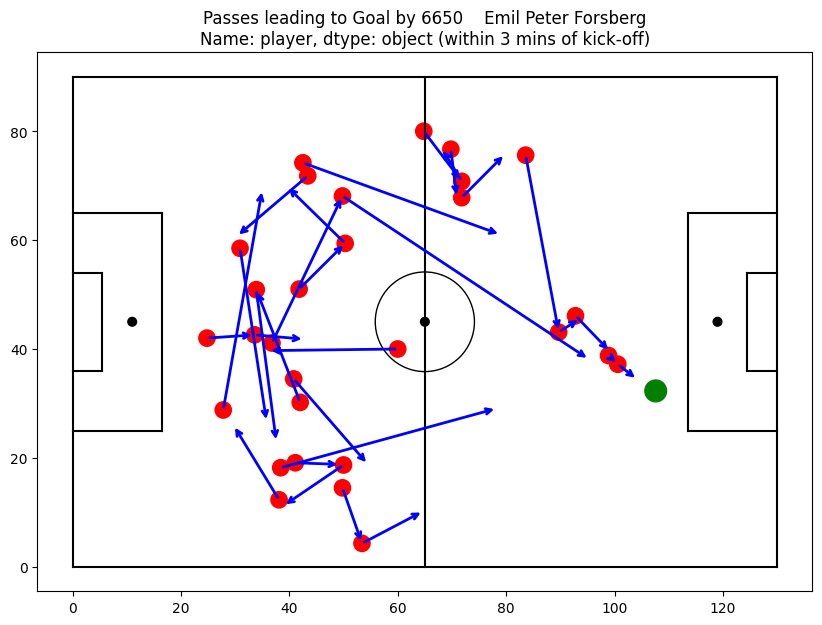

  Match ID: 3879564, Team: AS Roma, Minute: 1


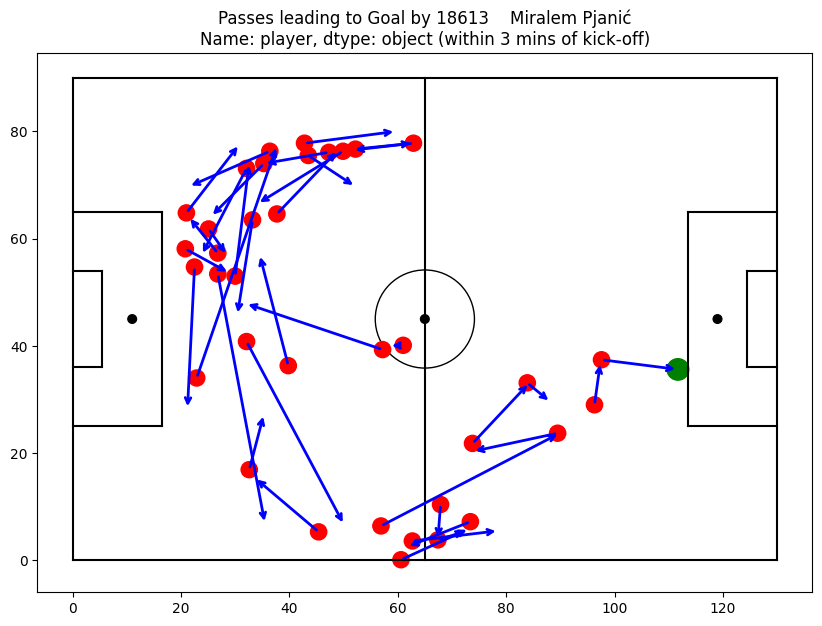

  Match ID: 3879724, Team: Fiorentina, Minute: 1


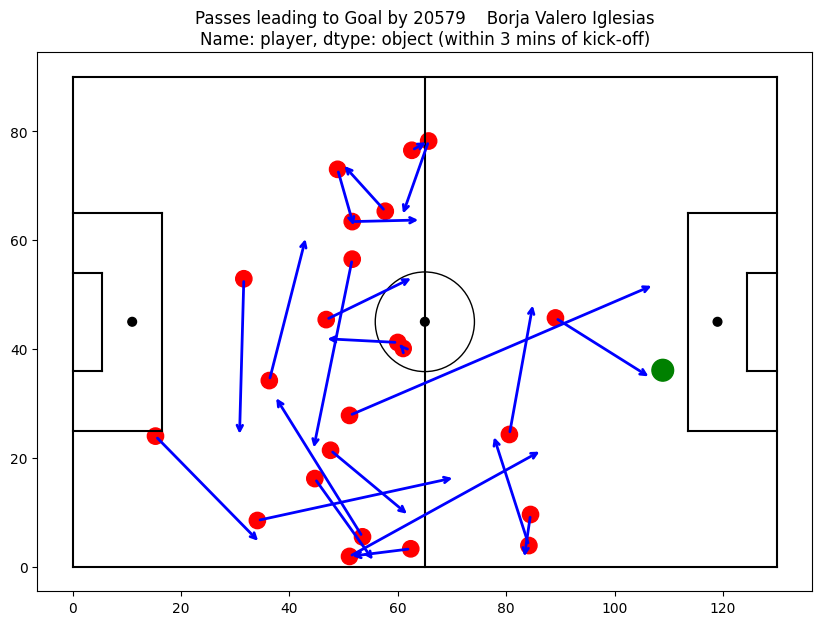

  Match ID: 3900543, Team: Troyes, Minute: 46


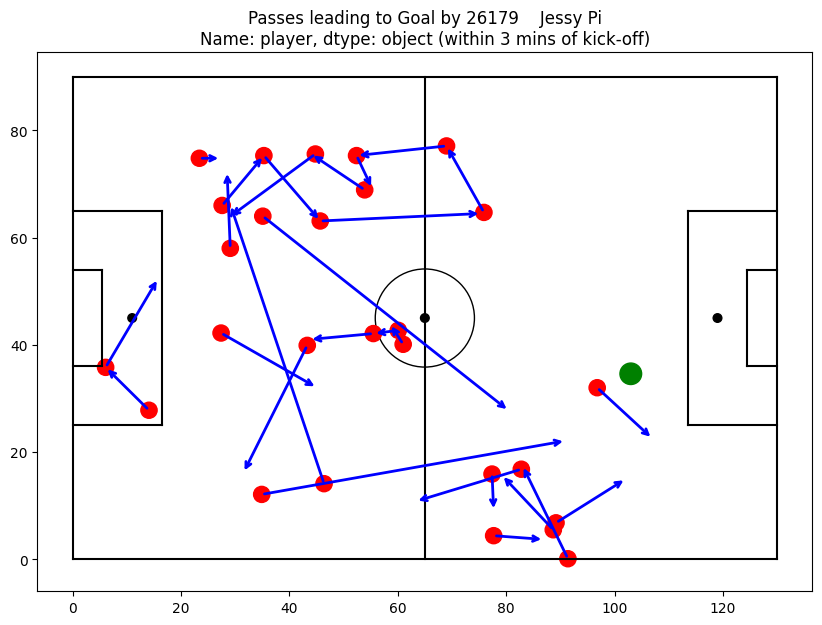

  Match ID: 3938644, Team: Georgia, Minute: 1


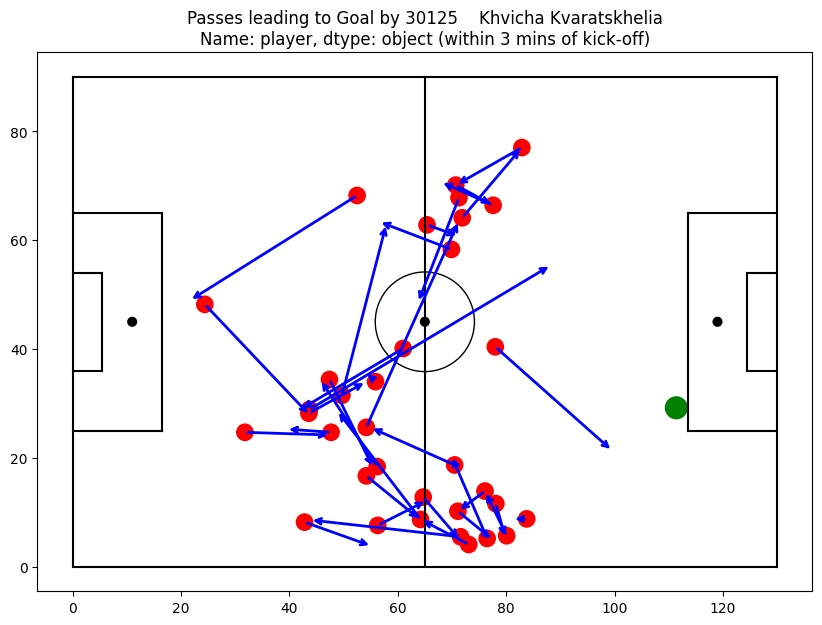


Cluster 6:
7
7581 Denmark 0
267327 Barcelona 45
3813306 NorthEast United 1
3825749 Levante UD 46
3879566 Udinese 46
3900537 Toulouse 1
3930180 Netherlands 46
7
Match IDs and Scoring Teams:
  Match ID: 7581, Team: Denmark, Minute: 0


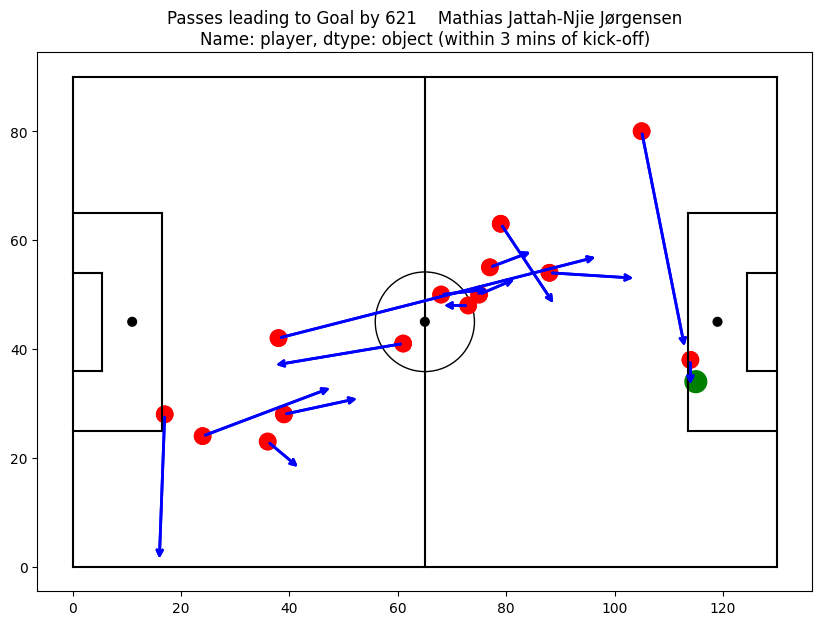

  Match ID: 267327, Team: Barcelona, Minute: 45


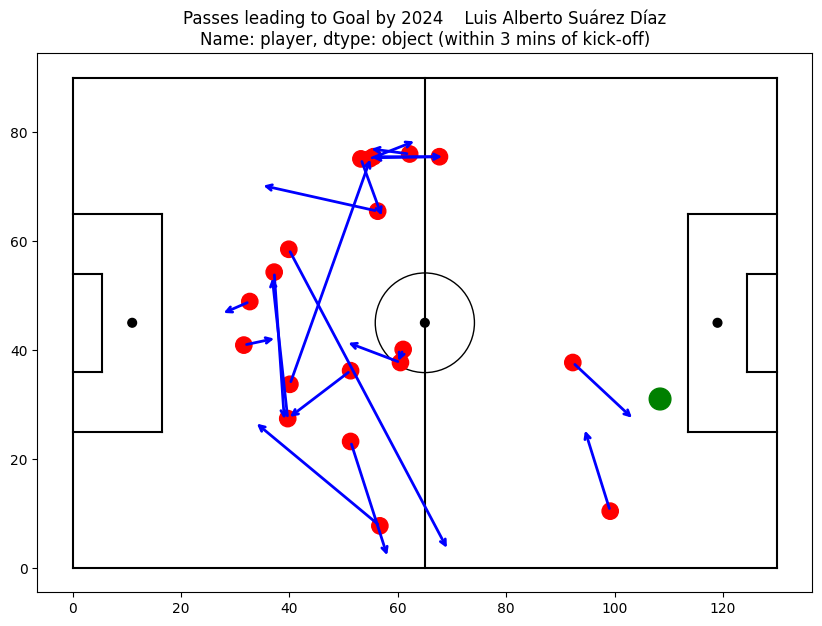

  Match ID: 3813306, Team: NorthEast United, Minute: 1


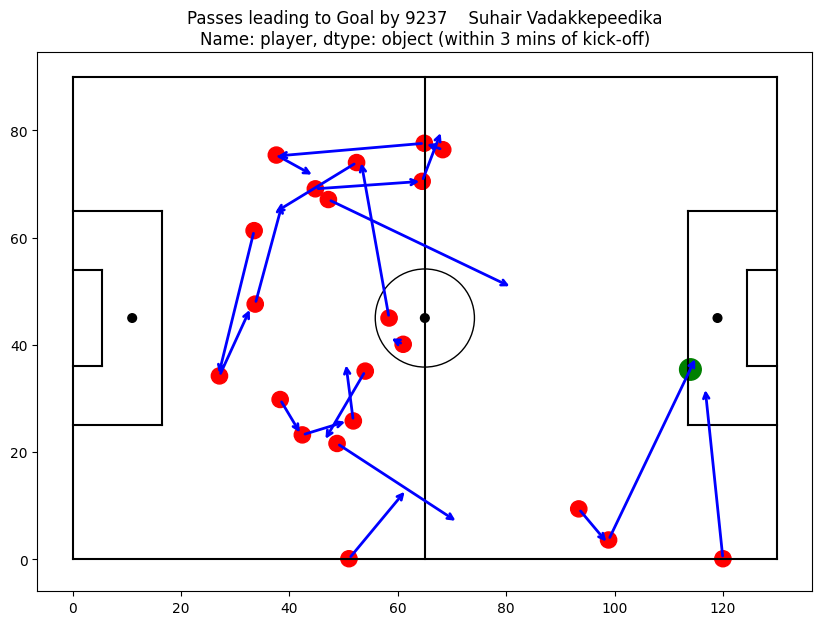

  Match ID: 3825749, Team: Levante UD, Minute: 46


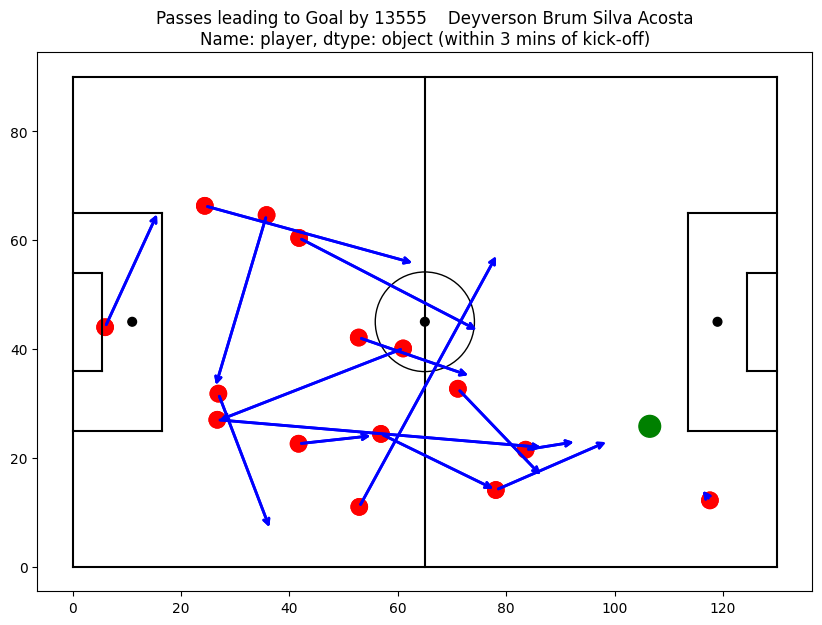

  Match ID: 3879566, Team: Udinese, Minute: 46


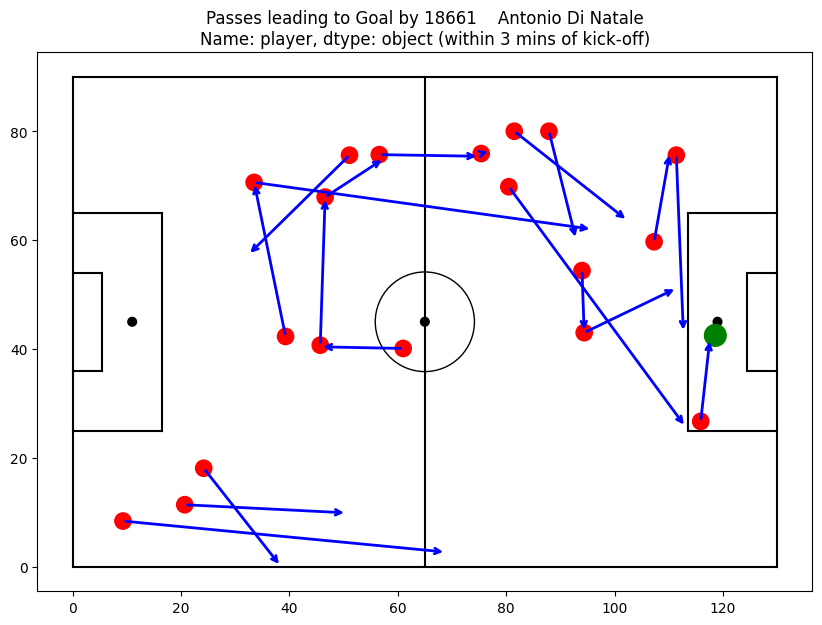

  Match ID: 3900537, Team: Toulouse, Minute: 1


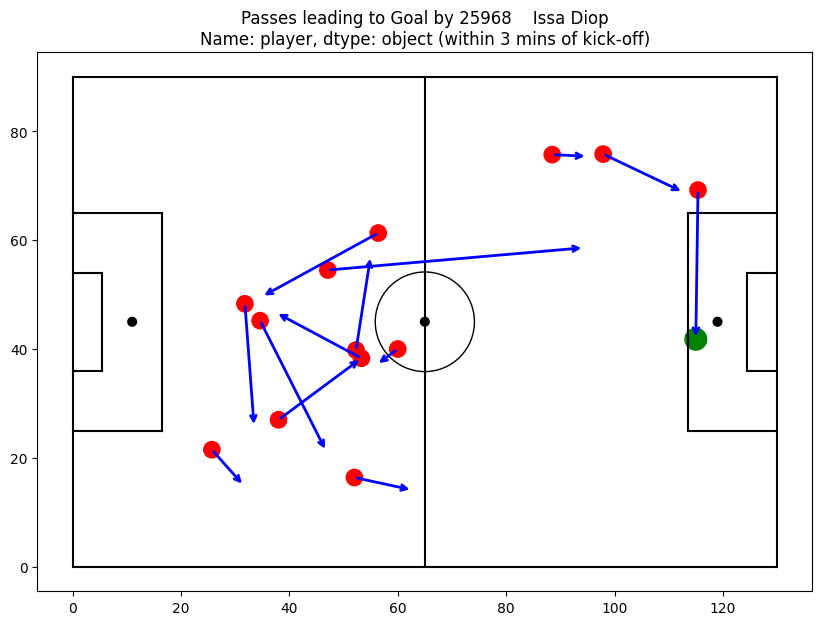

  Match ID: 3930180, Team: Netherlands, Minute: 46


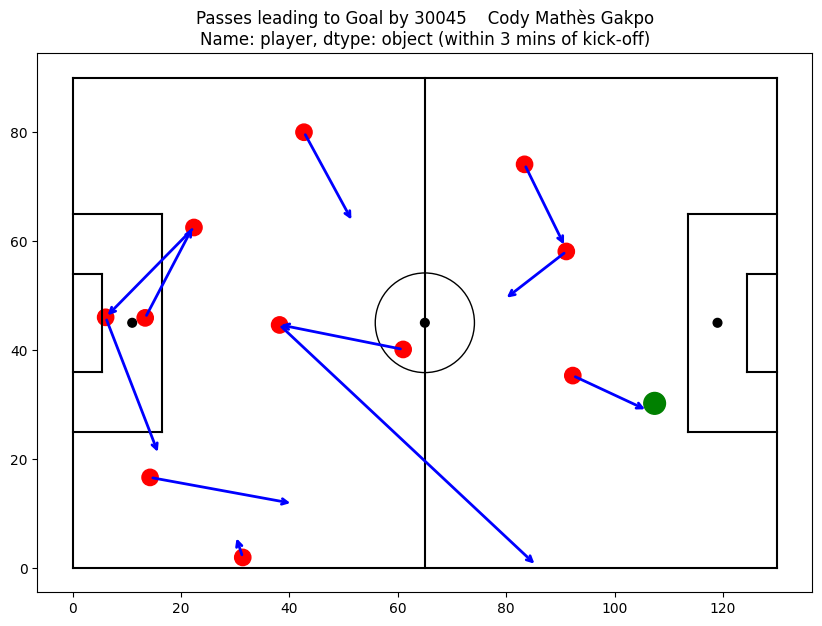


Cluster 7:
5
265894 Barcelona 1
3754043 Tottenham Hotspur 0
3879631 Udinese 45
3890439 Schalke 04 45
3920397 Equatorial Guinea 45
5
Match IDs and Scoring Teams:
  Match ID: 265894, Team: Barcelona, Minute: 1


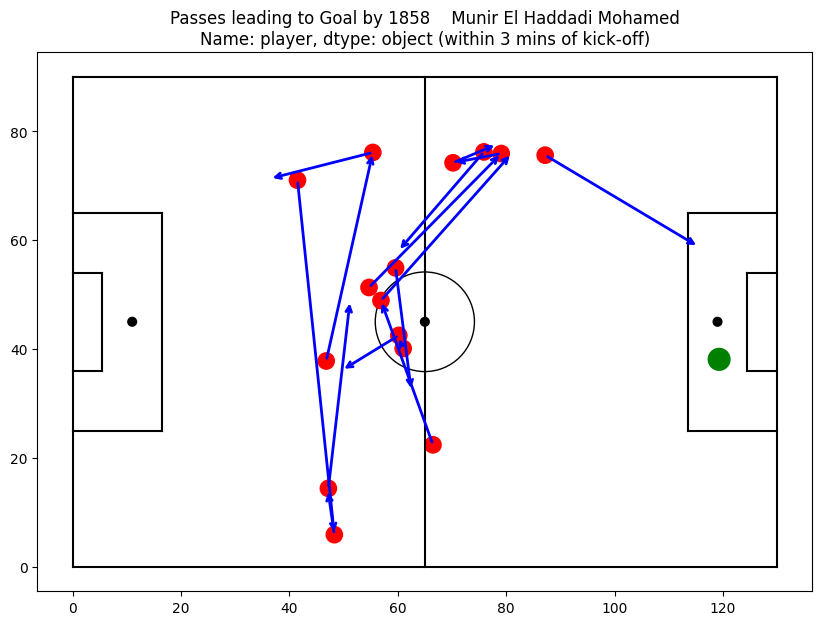

  Match ID: 3754043, Team: Tottenham Hotspur, Minute: 0


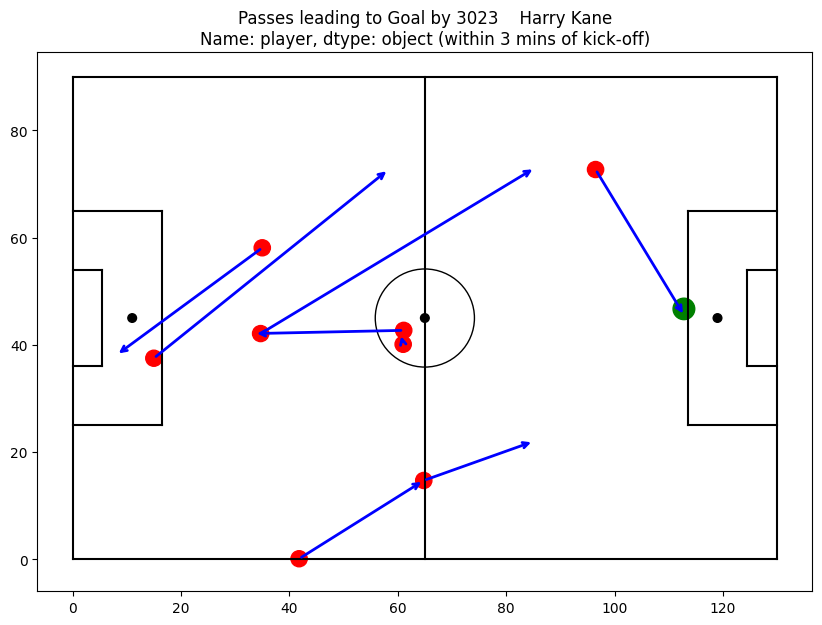

  Match ID: 3879631, Team: Udinese, Minute: 45


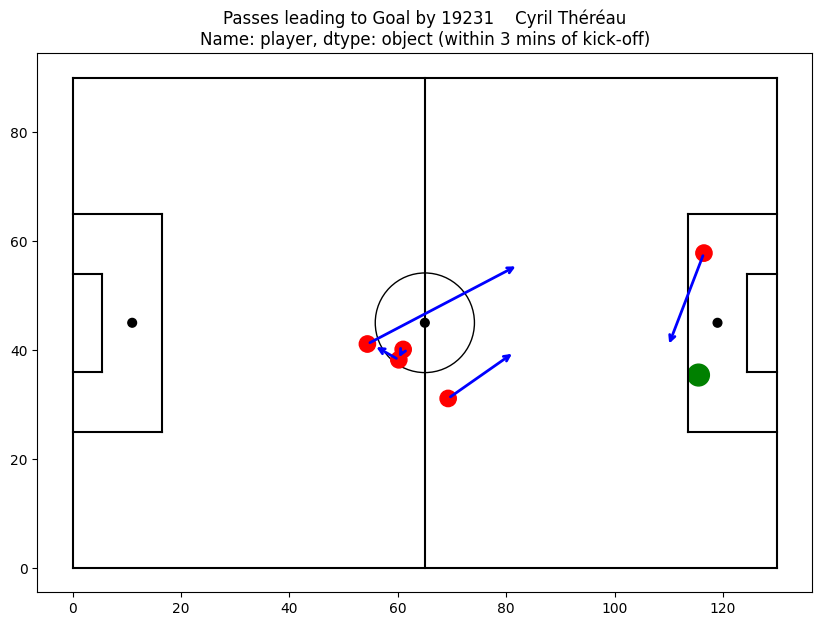

  Match ID: 3890439, Team: Schalke 04, Minute: 45


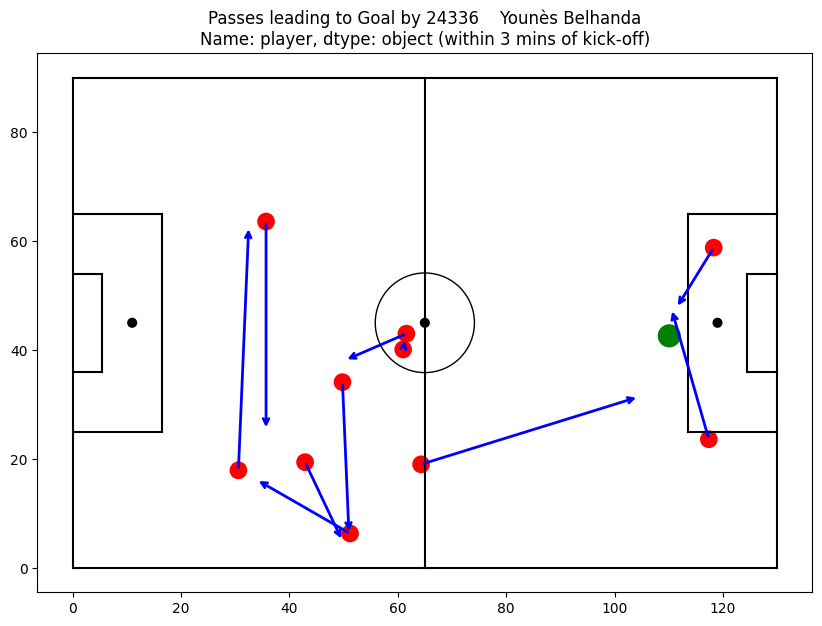

  Match ID: 3920397, Team: Equatorial Guinea, Minute: 45


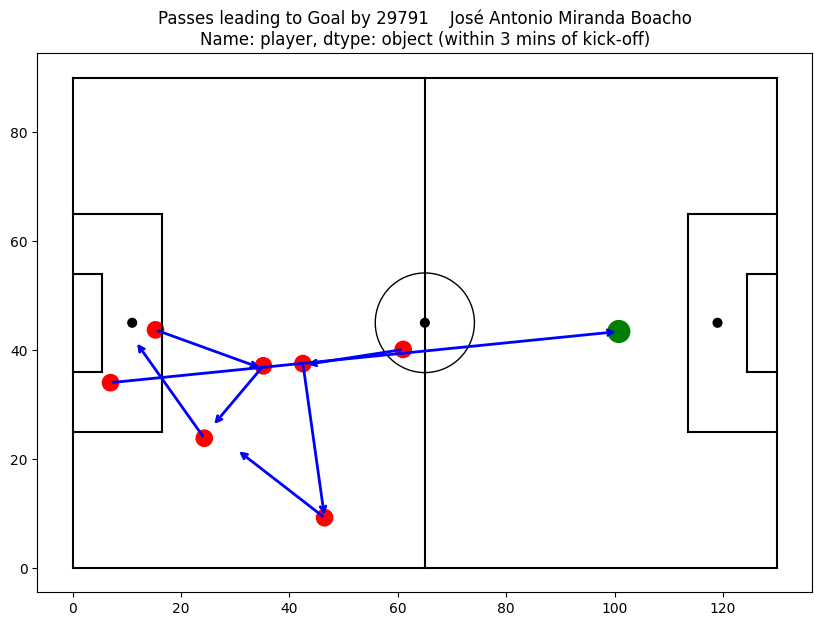


Cluster 8:
13
3754304 Crystal Palace 46
3795506 England 1
3817880 Chennaiyin 1
3817883 Jamshedpur 0
3879759 Juventus 46
3879834 Udinese 1
3879847 Udinese 46
3890271 Schalke 04 46
3890335 Wolfsburg 0
3890365 Borussia Dortmund 46
3890408 VfB Stuttgart 46
3900624 Lyon 45
3943043 Spain 46
13
Match IDs and Scoring Teams:
  Match ID: 3754304, Team: Crystal Palace, Minute: 46


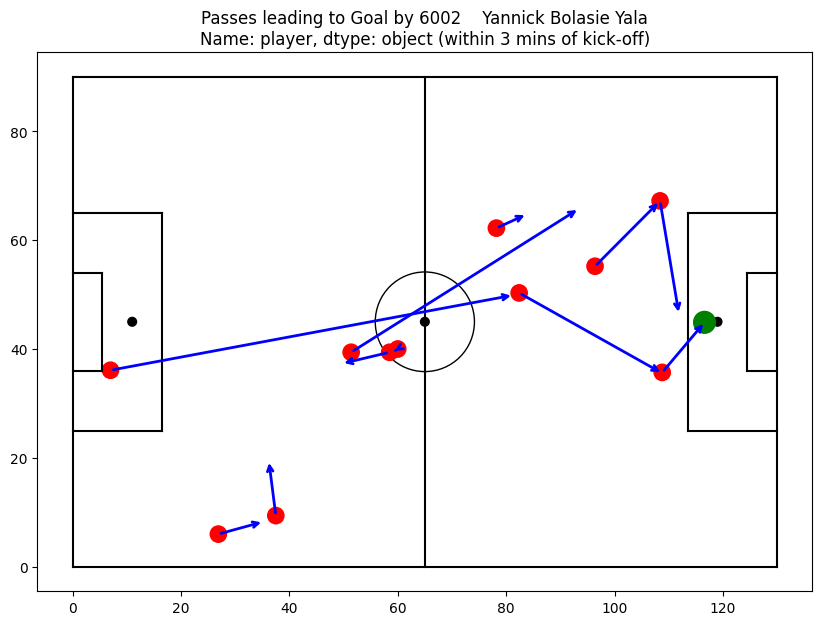

  Match ID: 3795506, Team: England, Minute: 1


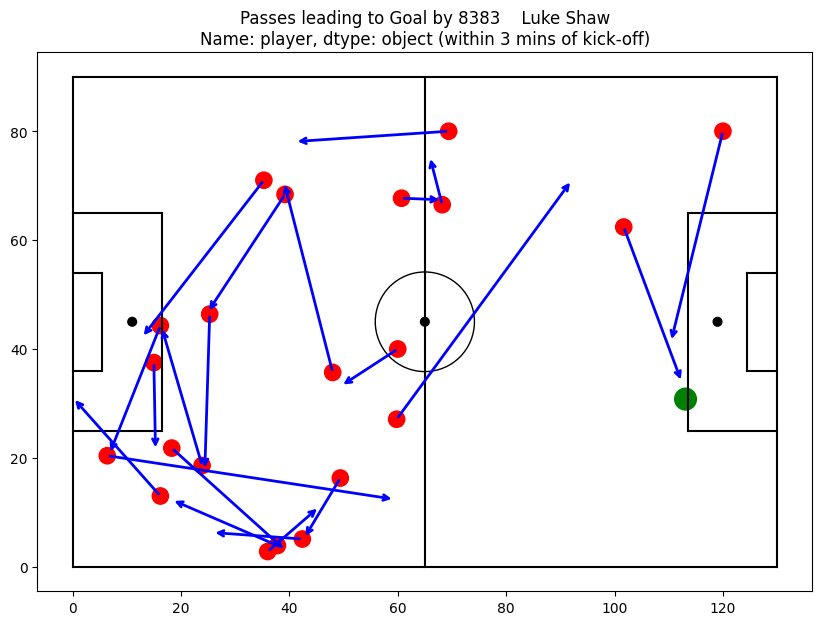

  Match ID: 3817880, Team: Chennaiyin, Minute: 1


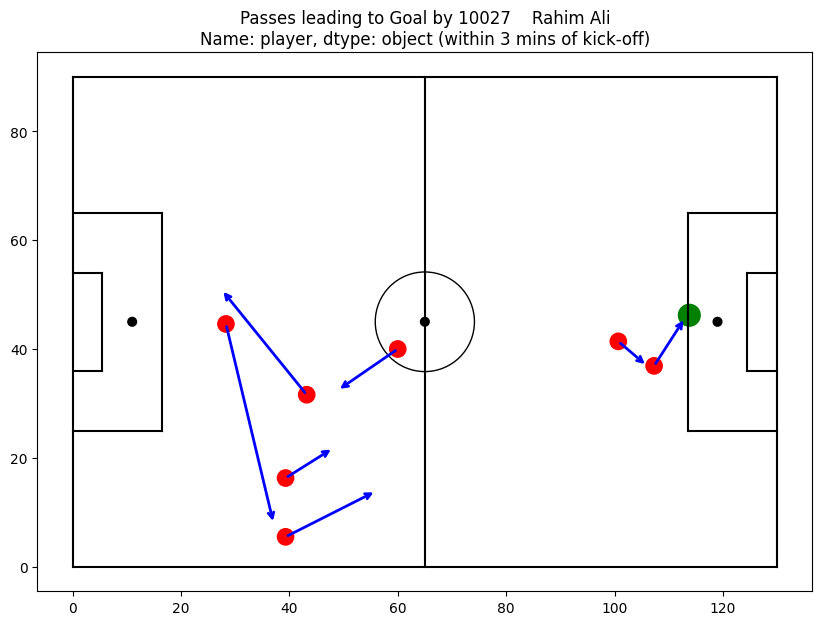

  Match ID: 3817883, Team: Jamshedpur, Minute: 0


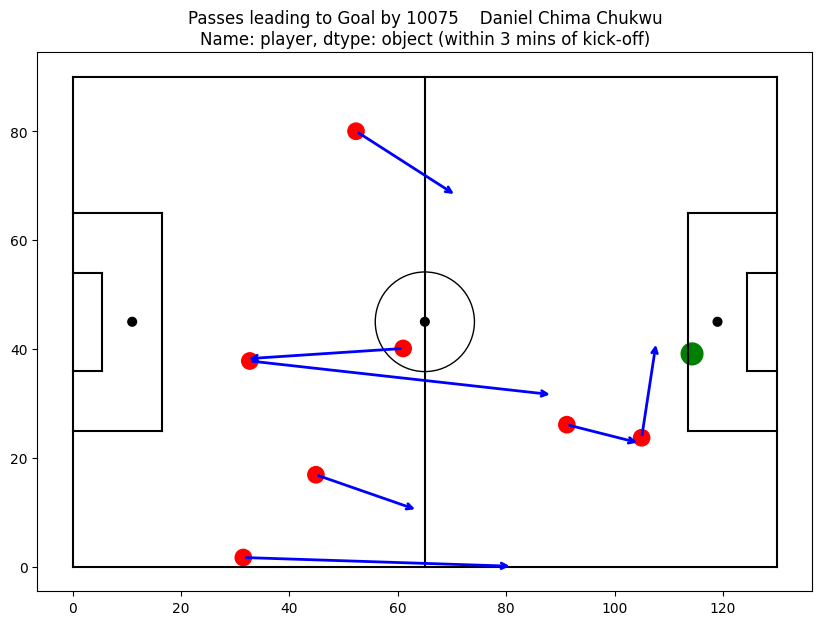

  Match ID: 3879759, Team: Juventus, Minute: 46


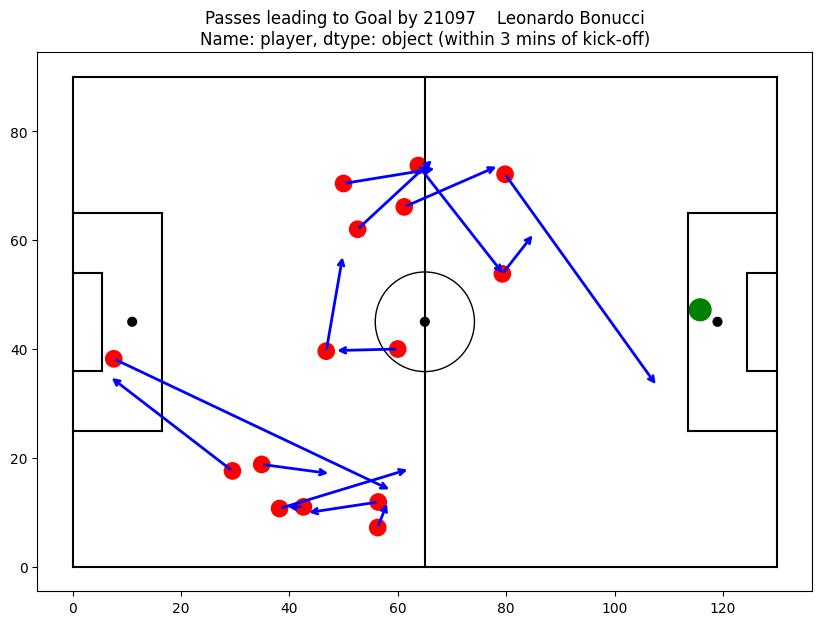

  Match ID: 3879834, Team: Udinese, Minute: 1


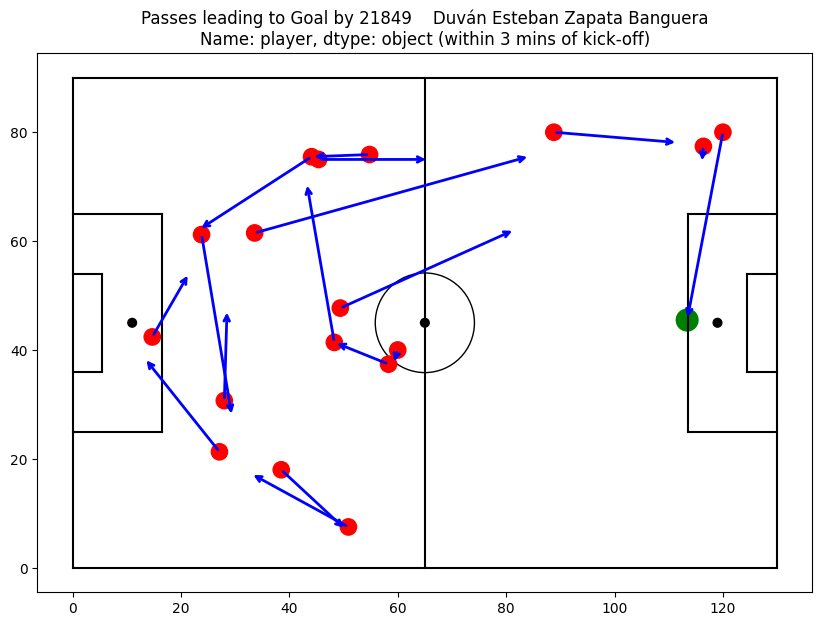

  Match ID: 3879847, Team: Udinese, Minute: 46


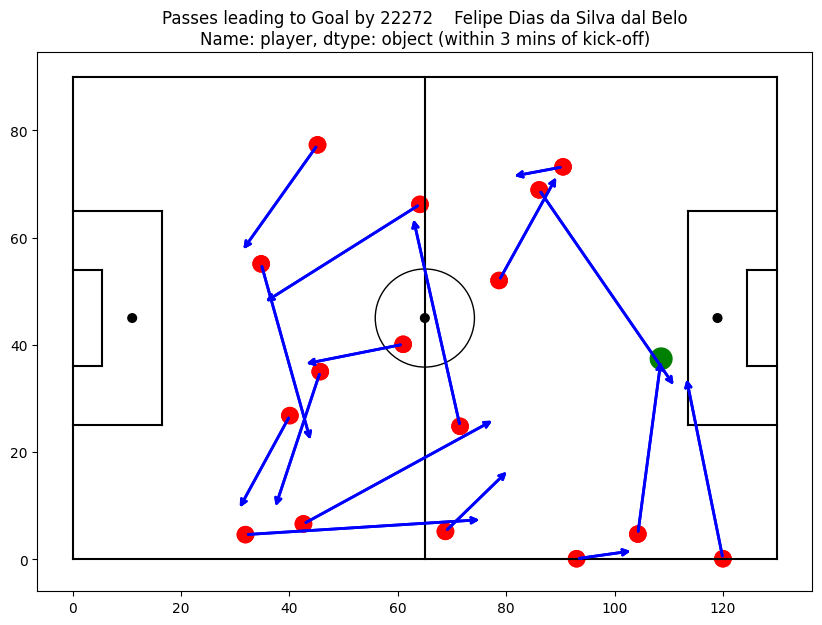

  Match ID: 3890271, Team: Schalke 04, Minute: 46


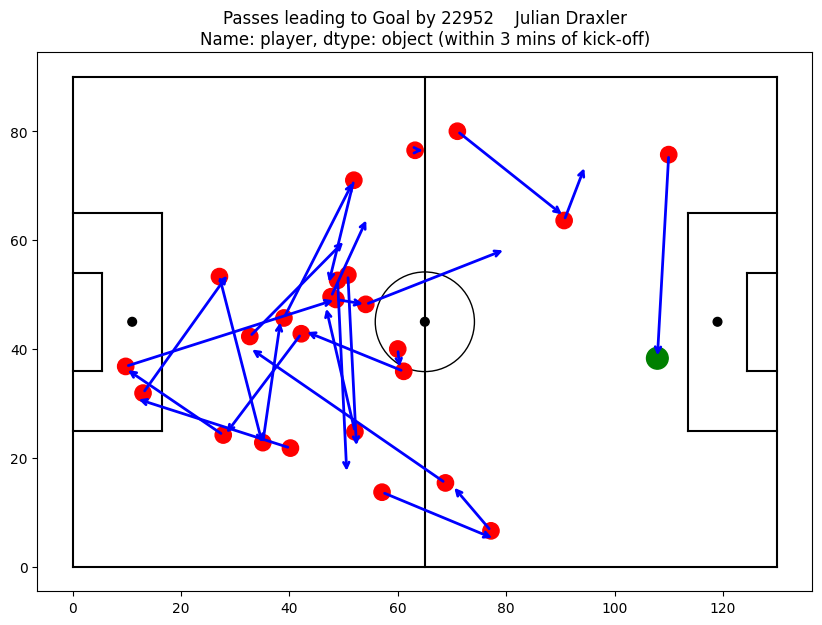

  Match ID: 3890335, Team: Wolfsburg, Minute: 0


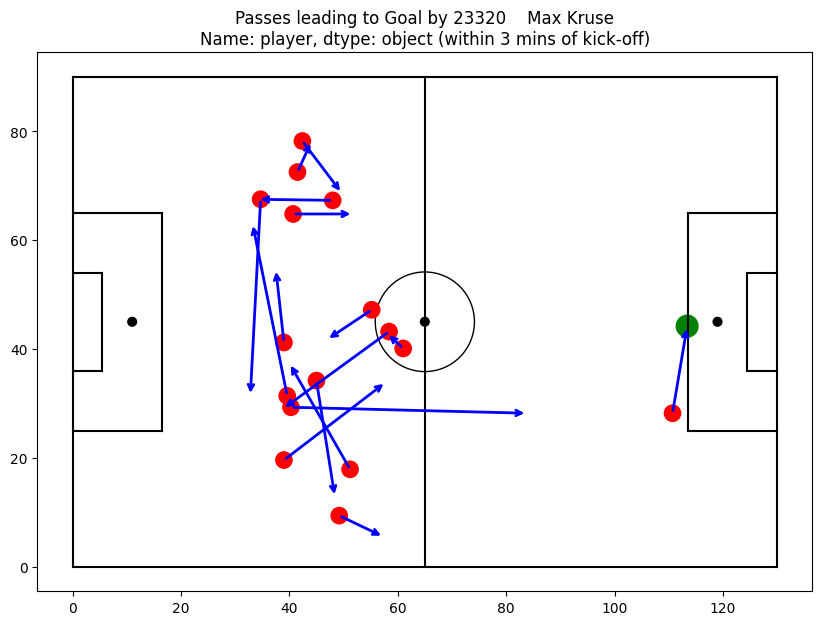

  Match ID: 3890365, Team: Borussia Dortmund, Minute: 46


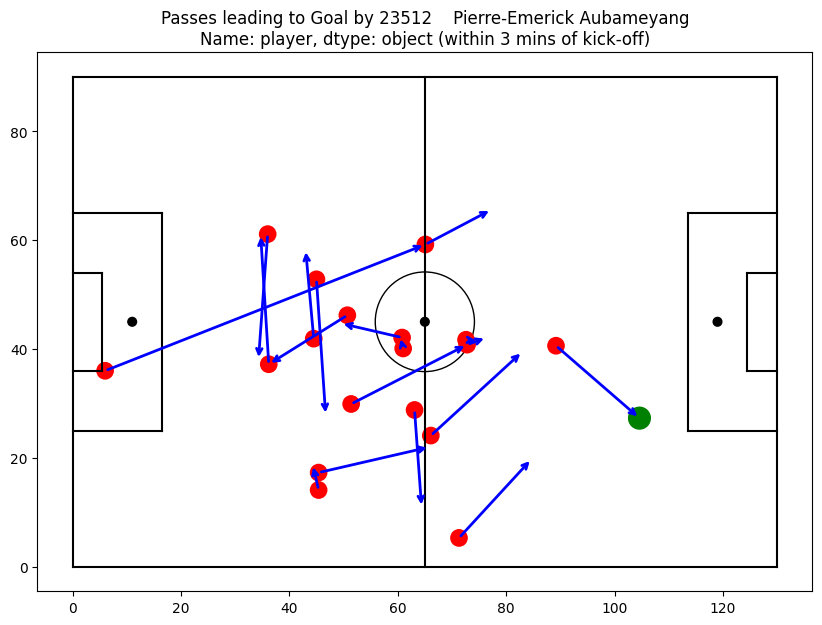

  Match ID: 3890408, Team: VfB Stuttgart, Minute: 46


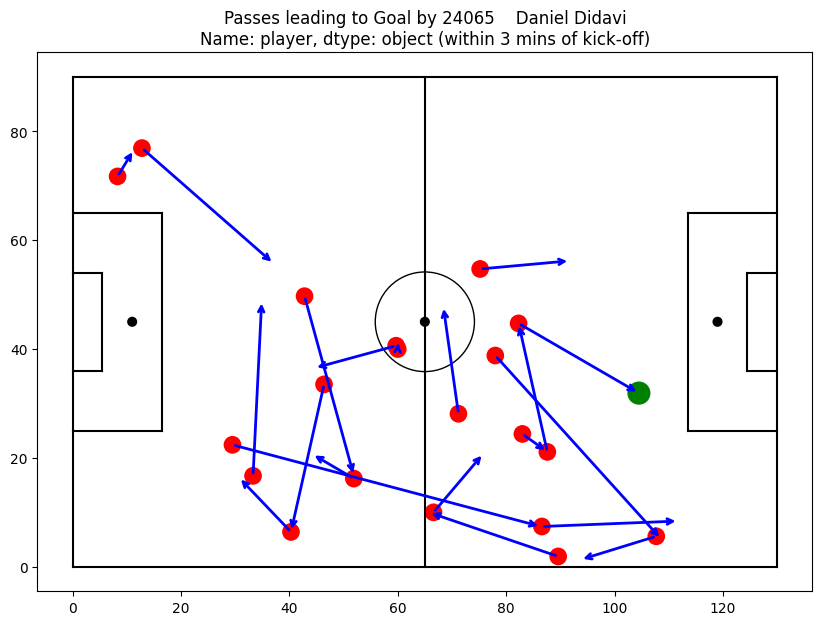

  Match ID: 3900624, Team: Lyon, Minute: 45


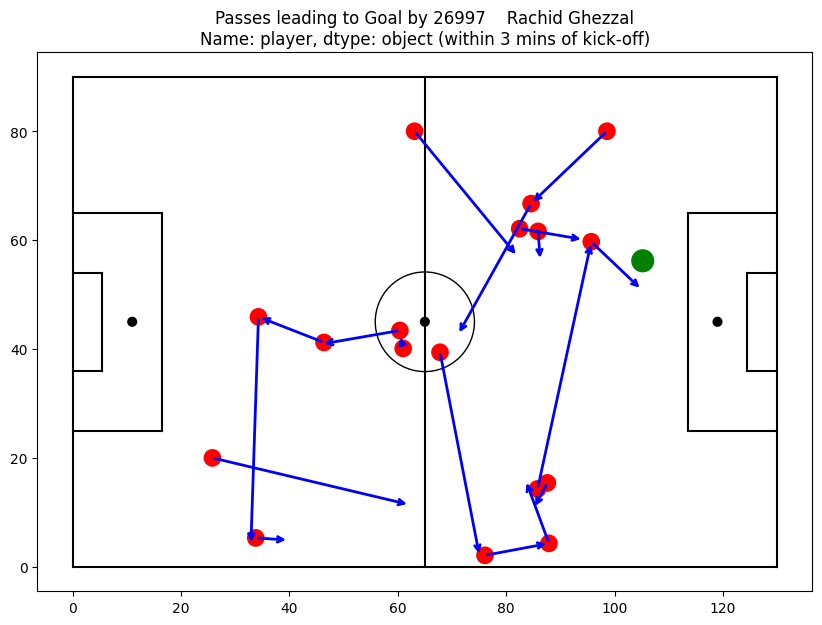

  Match ID: 3943043, Team: Spain, Minute: 46


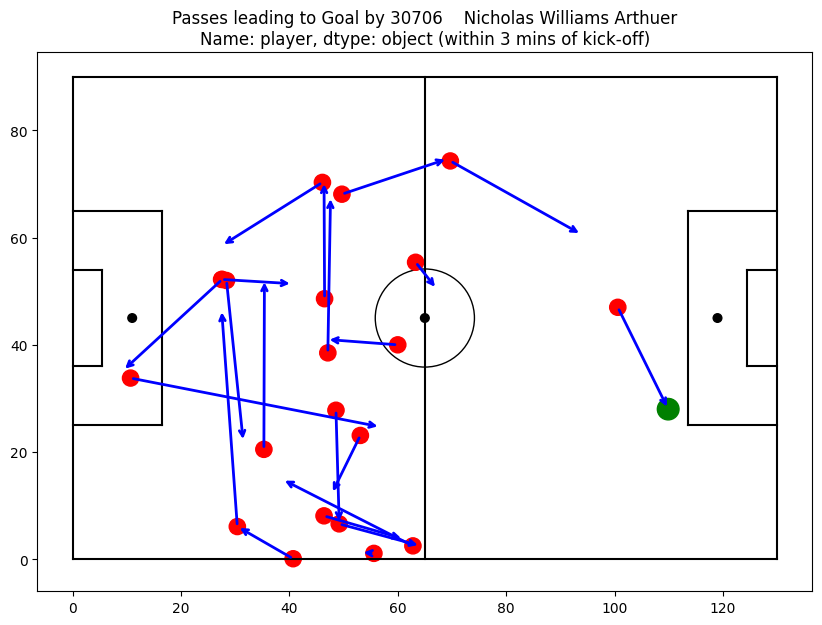


Cluster 9:
8
3754212 Liverpool 1
3795187 England 45
3825741 Sporting Gijón 0
3829517 Gazélec Ajaccio 0
3879650 Empoli 45
3879874 Lazio 1
3901183 Paris Saint-Germain 45
3940878 Switzerland 45
8
Match IDs and Scoring Teams:
  Match ID: 3754212, Team: Liverpool, Minute: 1


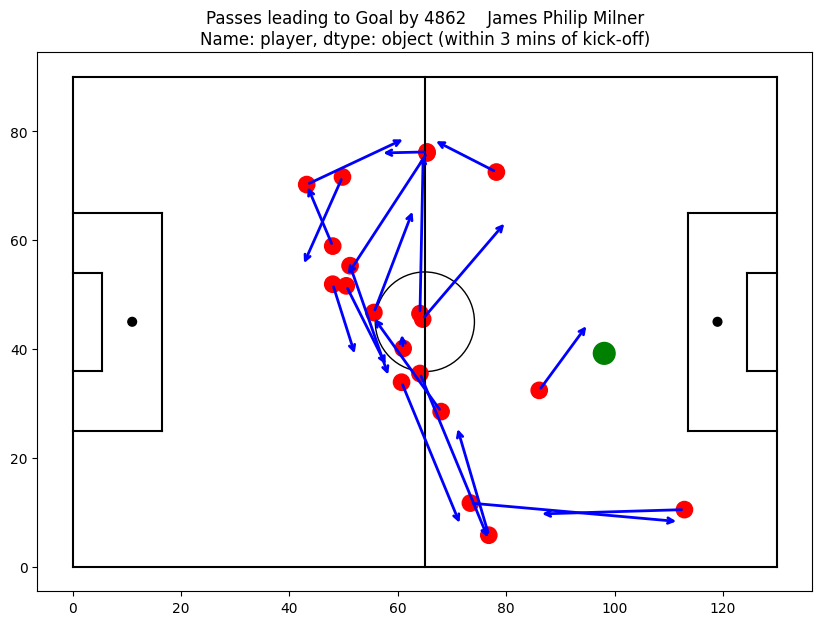

  Match ID: 3795187, Team: England, Minute: 45


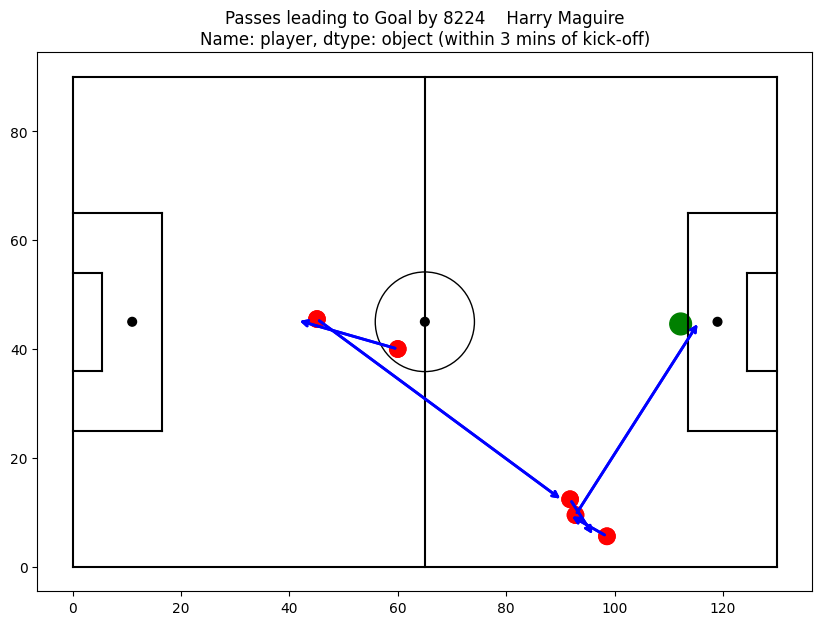

  Match ID: 3825741, Team: Sporting Gijón, Minute: 0


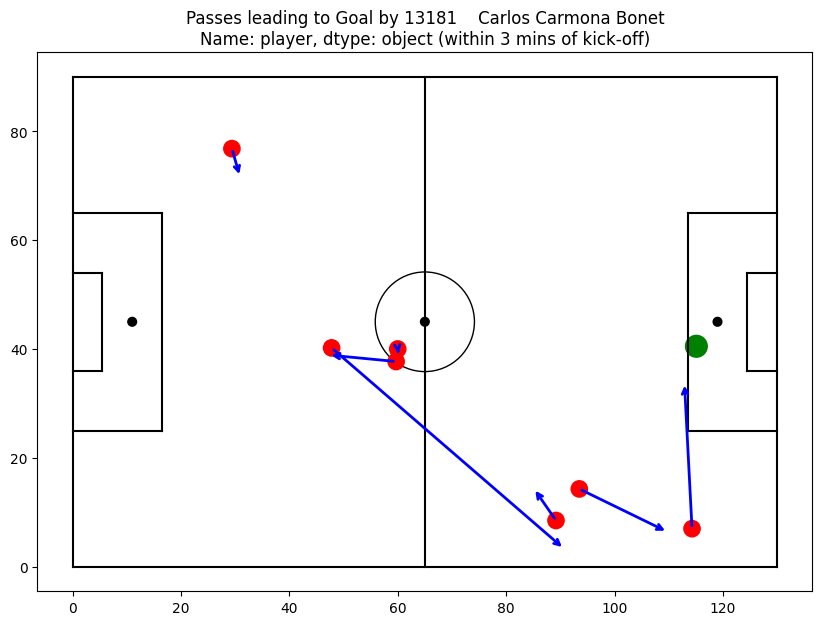

  Match ID: 3829517, Team: Gazélec Ajaccio, Minute: 0


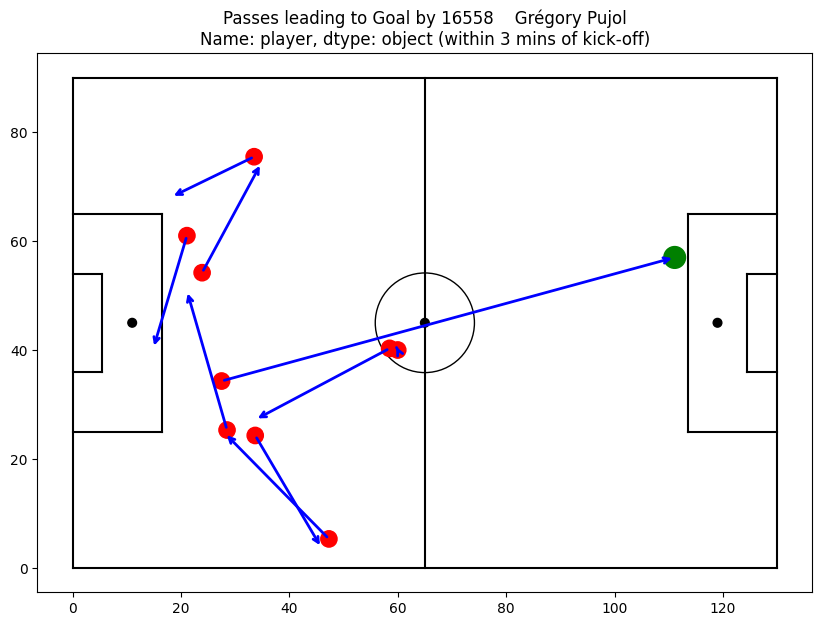

  Match ID: 3879650, Team: Empoli, Minute: 45


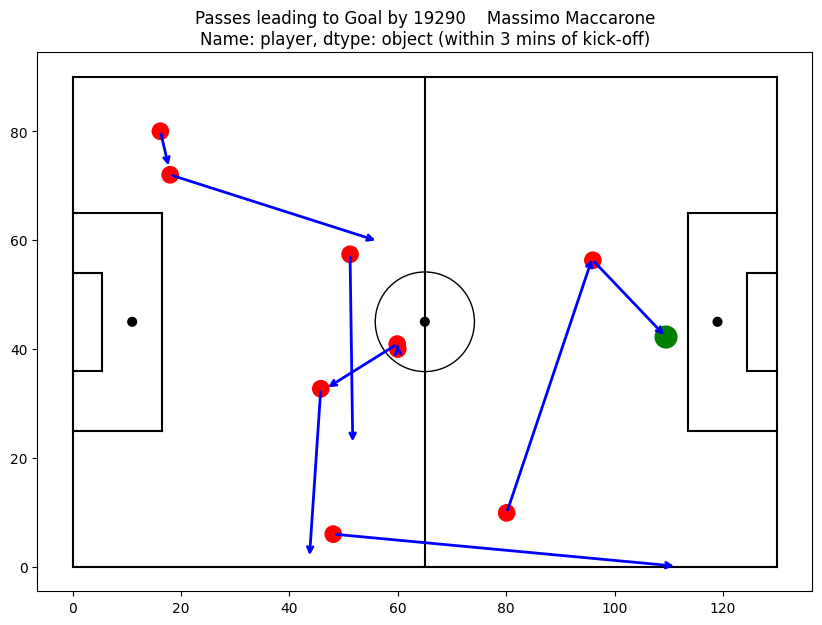

  Match ID: 3879874, Team: Lazio, Minute: 1


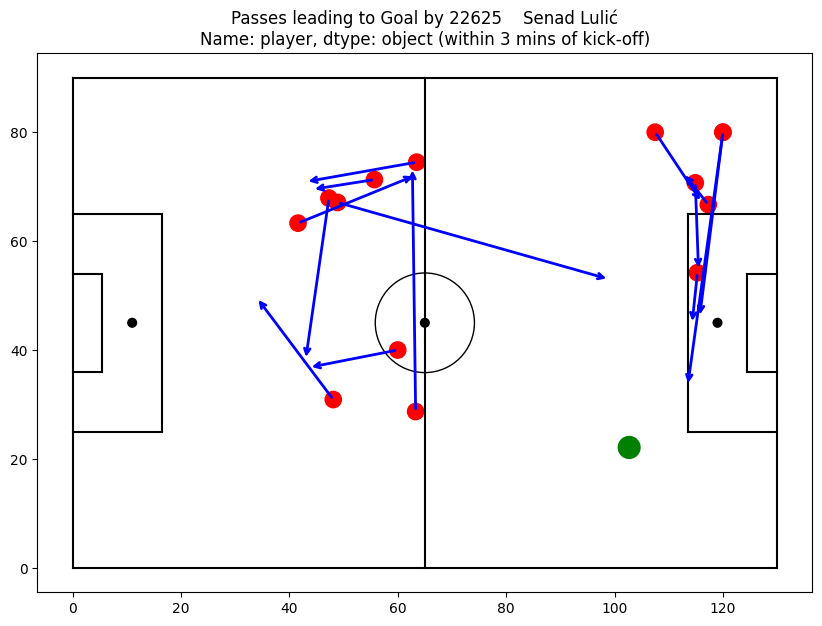

  Match ID: 3901183, Team: Paris Saint-Germain, Minute: 45


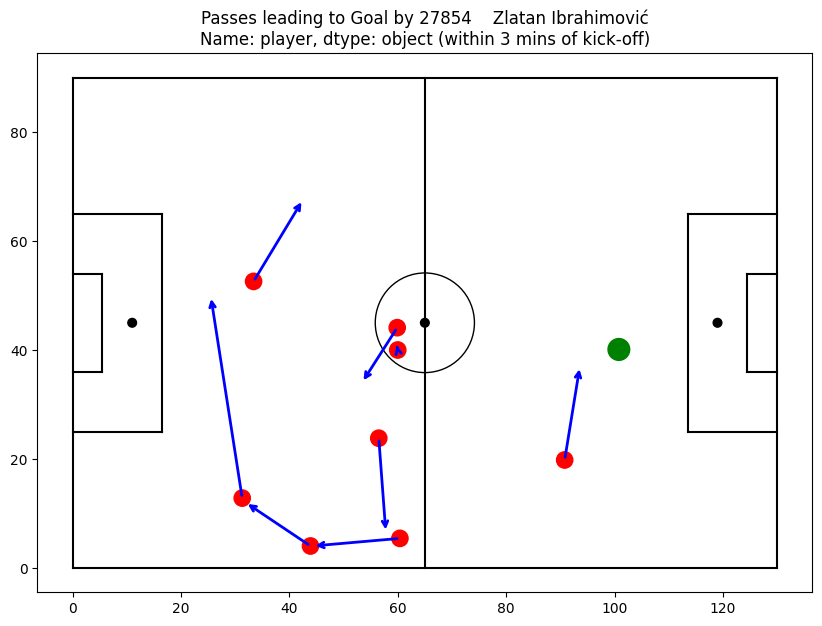

  Match ID: 3940878, Team: Switzerland, Minute: 45


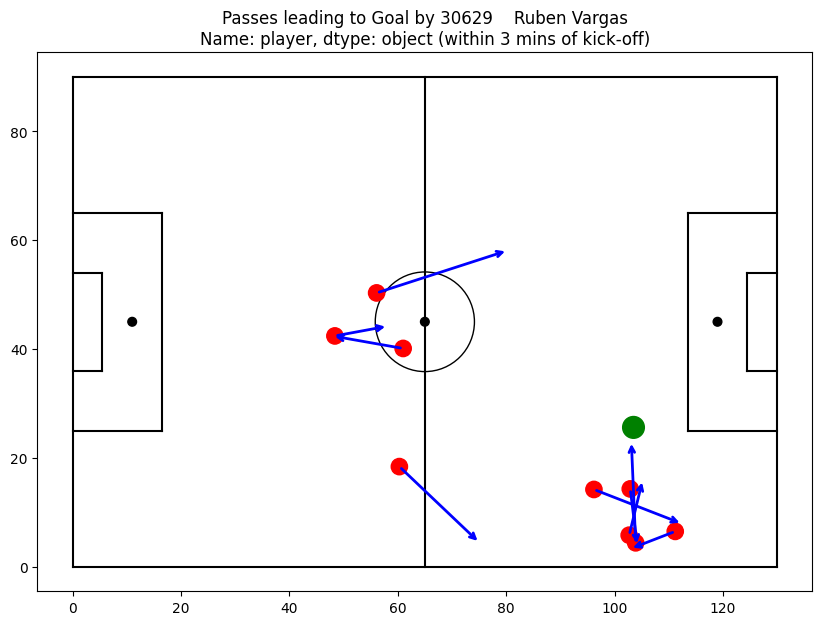


Cluster 10:
5
3817862 Mumbai City 46
3825760 Eibar 45
3825860 Atlético Madrid 1
3857260 Mexico 46
3900582 Gazélec Ajaccio 1
5
Match IDs and Scoring Teams:
  Match ID: 3817862, Team: Mumbai City, Minute: 46


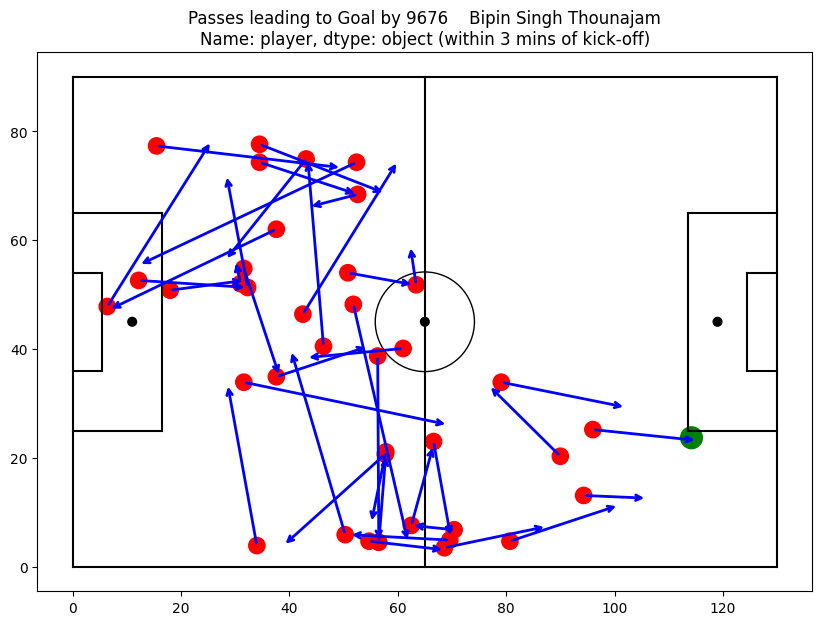

  Match ID: 3825760, Team: Eibar, Minute: 45


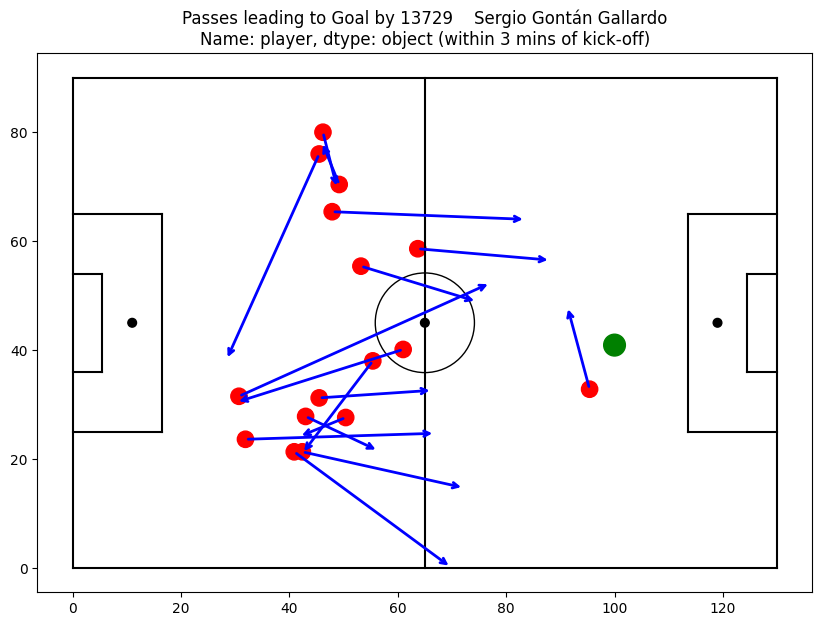

  Match ID: 3825860, Team: Atlético Madrid, Minute: 1


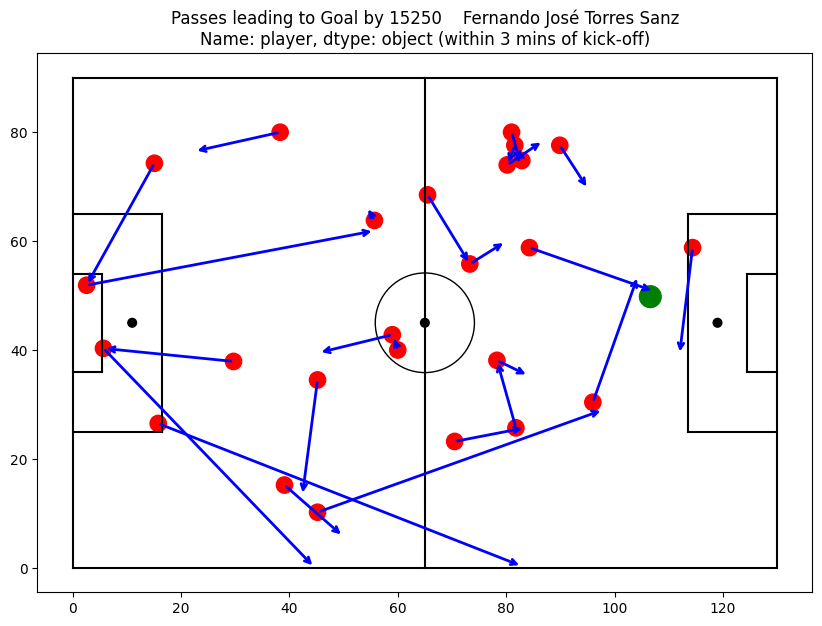

  Match ID: 3857260, Team: Mexico, Minute: 46


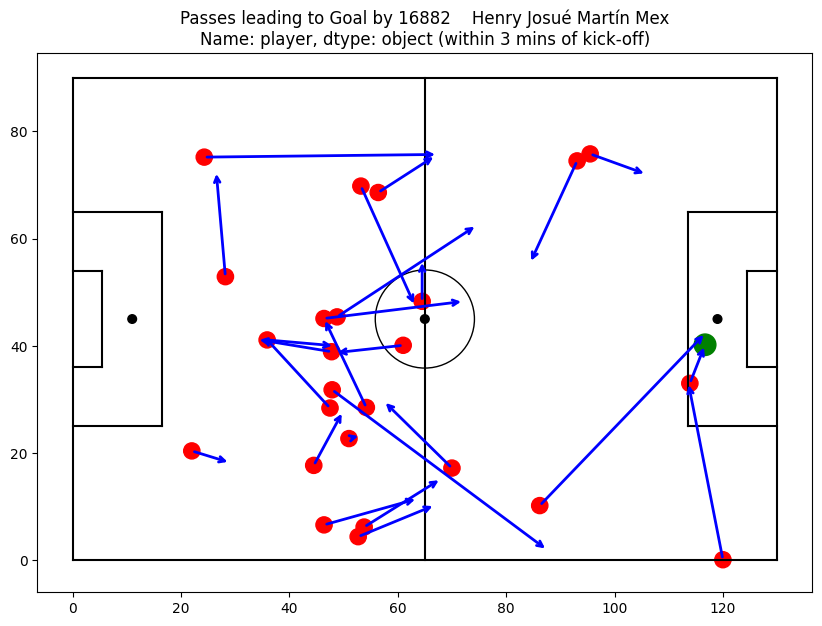

  Match ID: 3900582, Team: Gazélec Ajaccio, Minute: 1


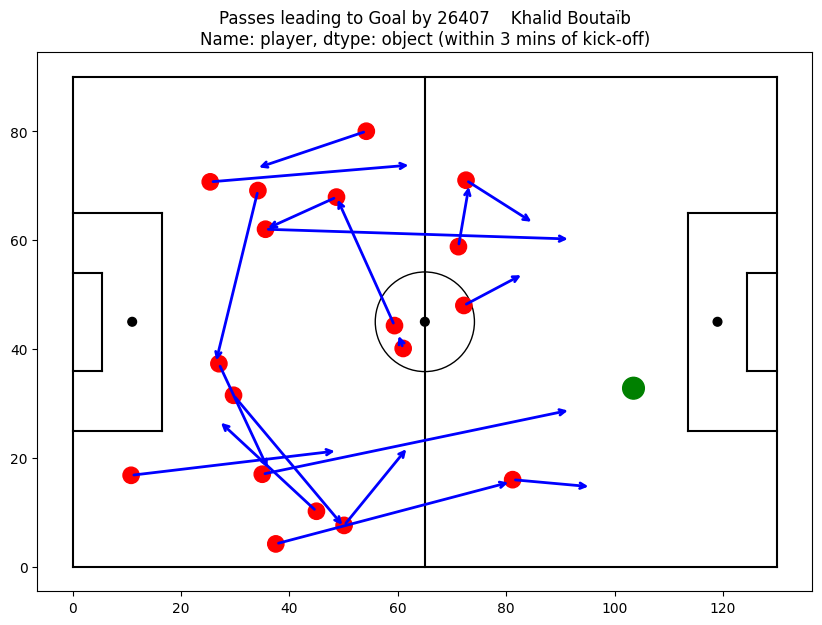


Cluster 11:
7
3829470 Saint-Étienne 46
3879851 Frosinone 1
3890280 Hamburger SV 46
3890360 Darmstadt 98 46
3890377 Hoffenheim 46
3900544 Lorient 46
3901223 AS Monaco 46
7
Match IDs and Scoring Teams:
  Match ID: 3829470, Team: Saint-Étienne, Minute: 46


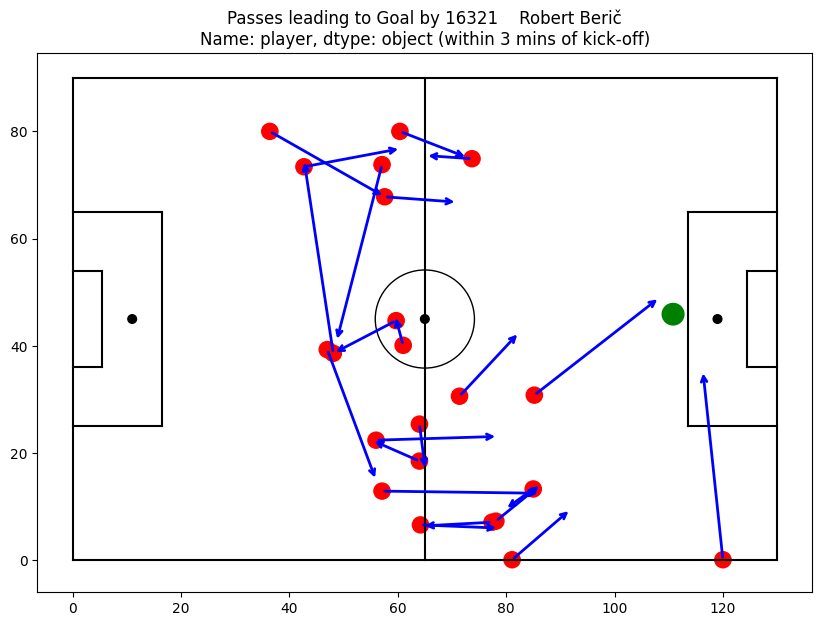

  Match ID: 3879851, Team: Frosinone, Minute: 1


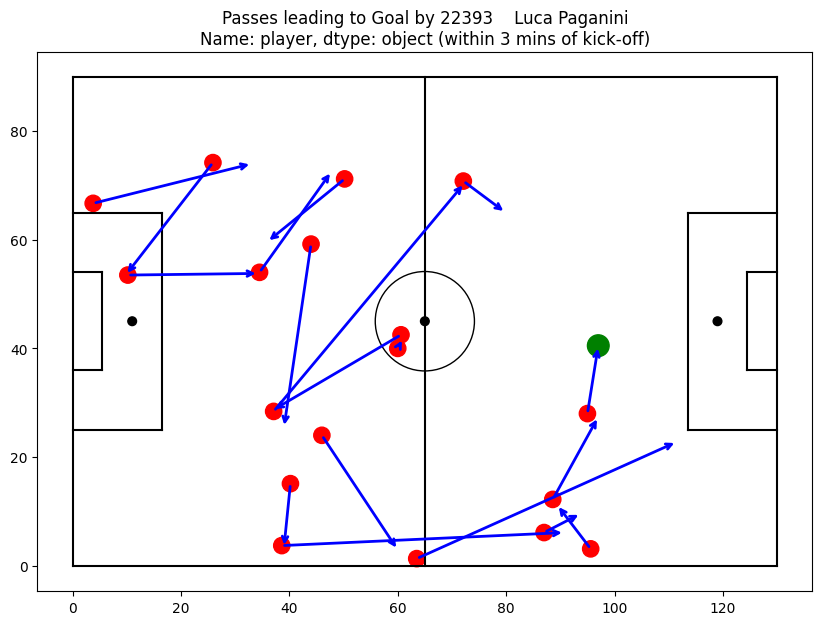

  Match ID: 3890280, Team: Hamburger SV, Minute: 46


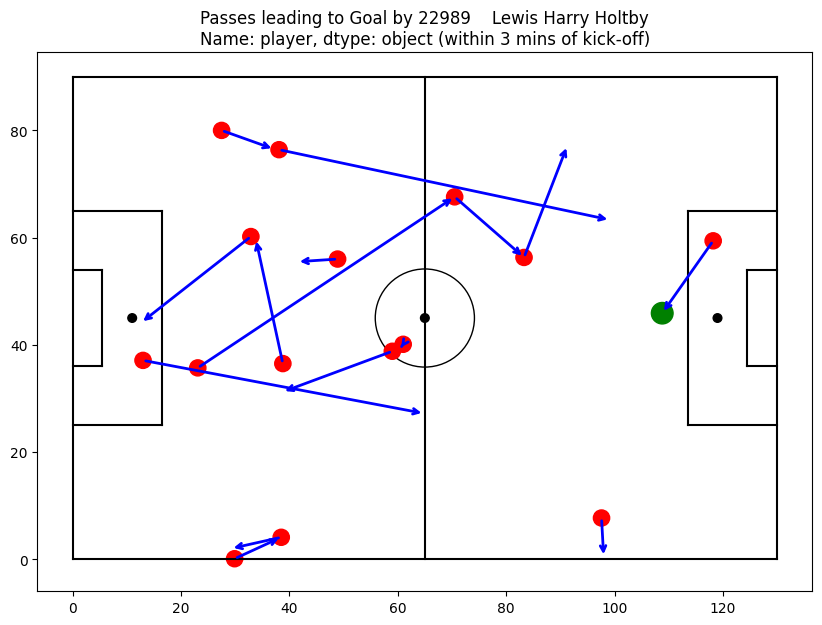

  Match ID: 3890360, Team: Darmstadt 98, Minute: 46


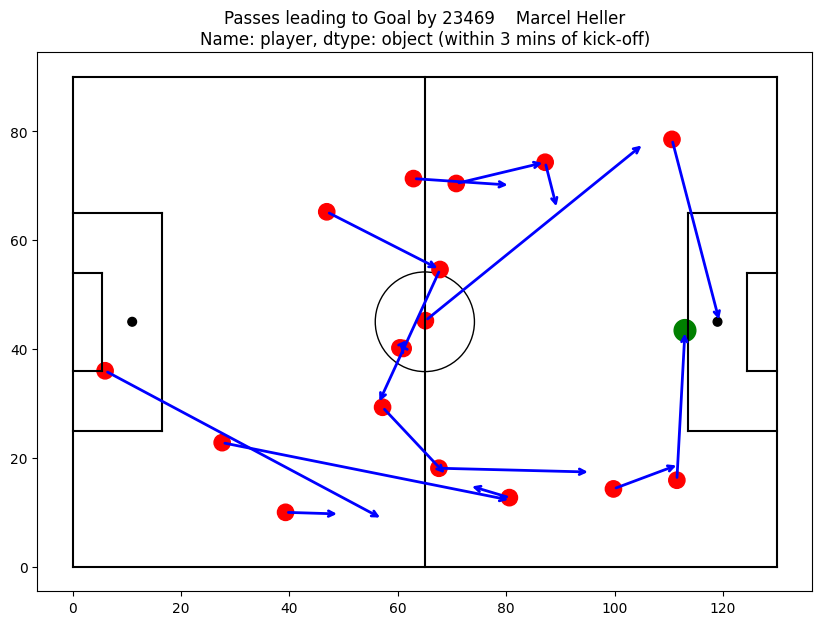

  Match ID: 3890377, Team: Hoffenheim, Minute: 46


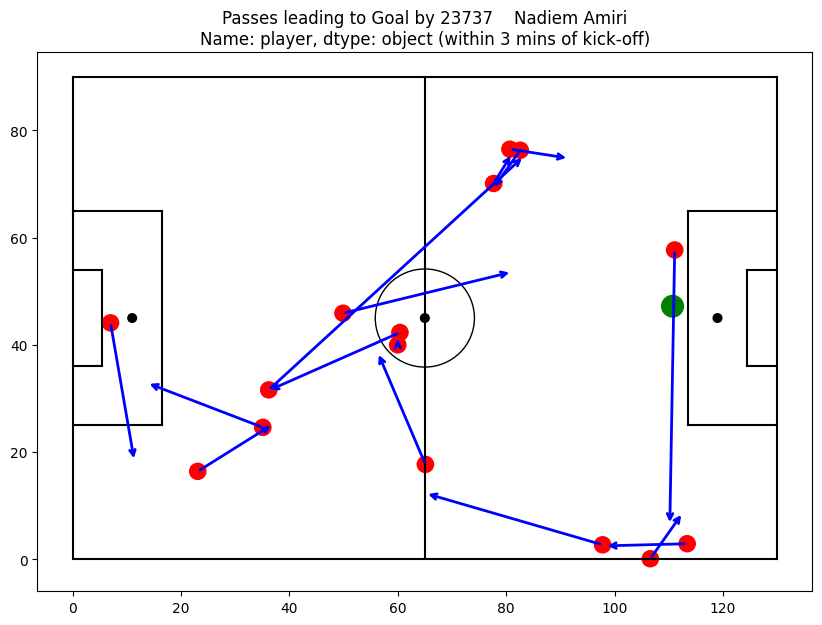

  Match ID: 3900544, Team: Lorient, Minute: 46


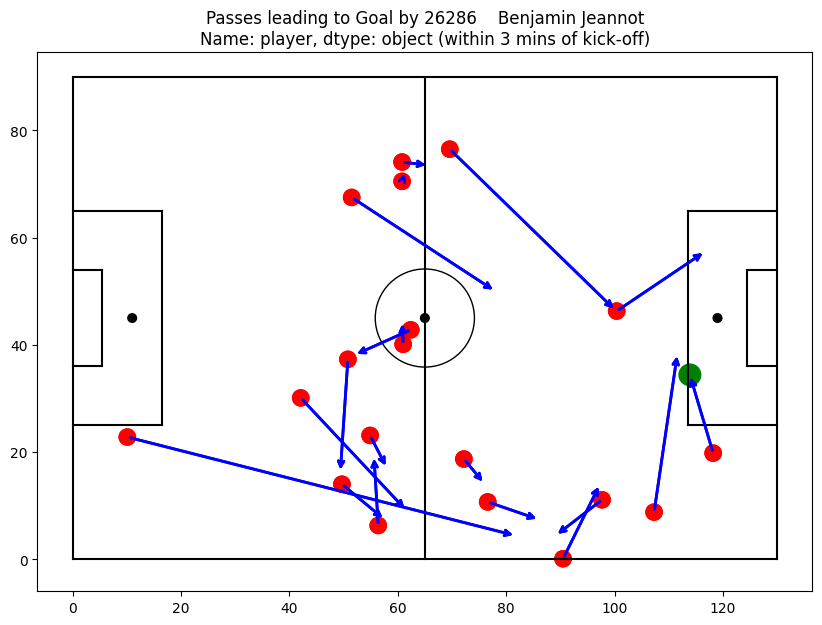

  Match ID: 3901223, Team: AS Monaco, Minute: 46


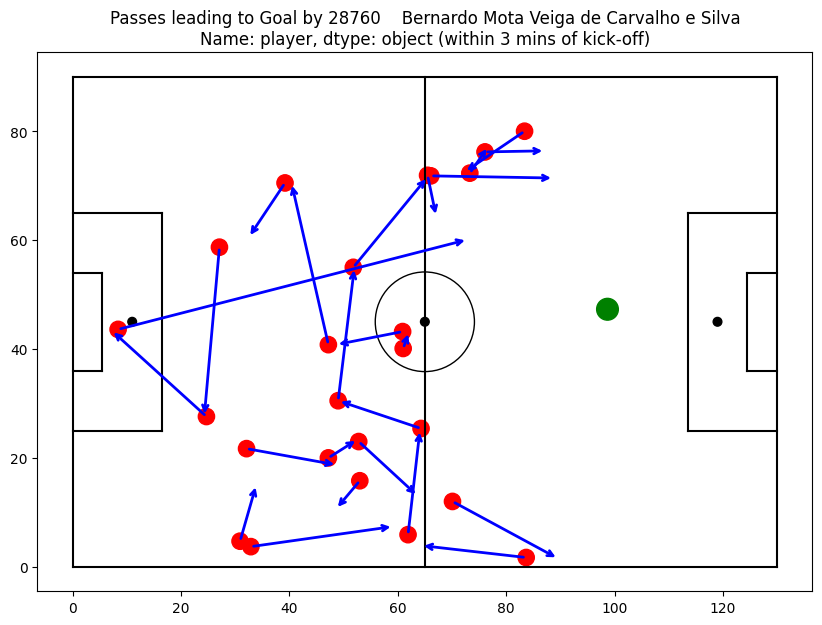


Cluster 12:
5
3813312 Mumbai City 46
3817900 Jamshedpur 45
3879572 Napoli 45
3890270 Hoffenheim 0
3930161 Albania 0
5
Match IDs and Scoring Teams:
  Match ID: 3813312, Team: Mumbai City, Minute: 46


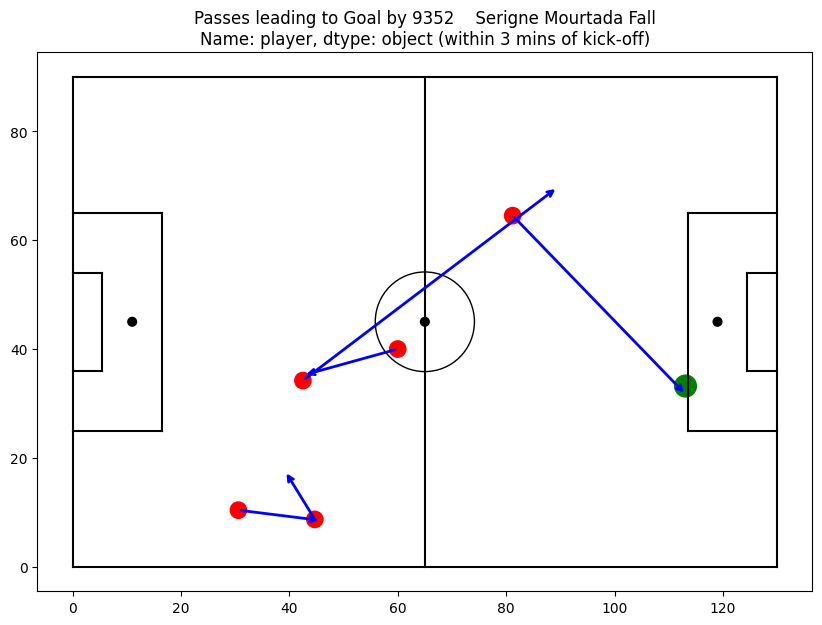

  Match ID: 3817900, Team: Jamshedpur, Minute: 45


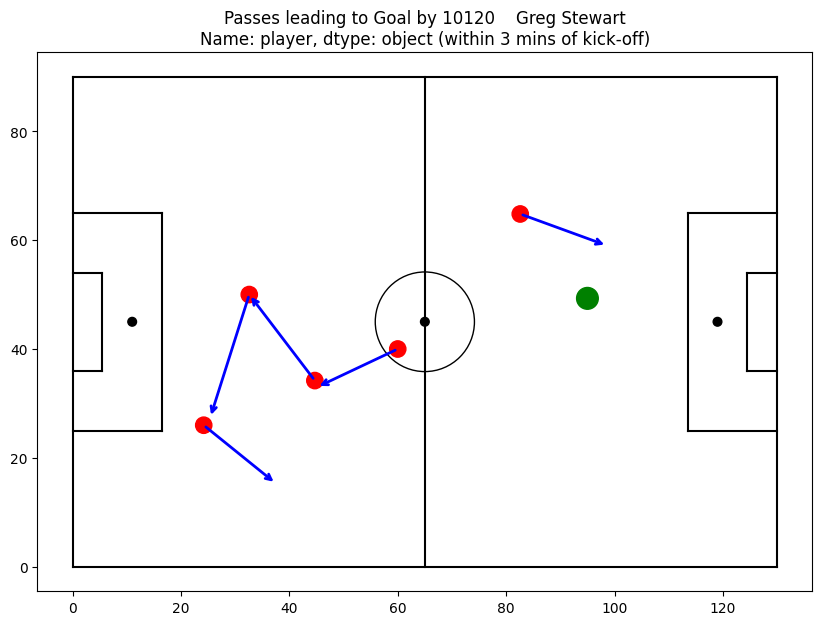

  Match ID: 3879572, Team: Napoli, Minute: 45


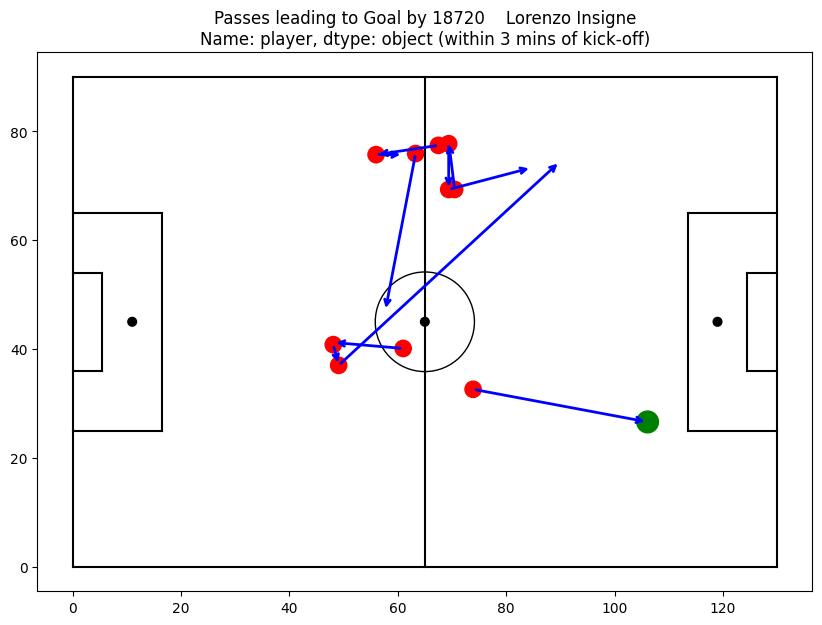

  Match ID: 3890270, Team: Hoffenheim, Minute: 0


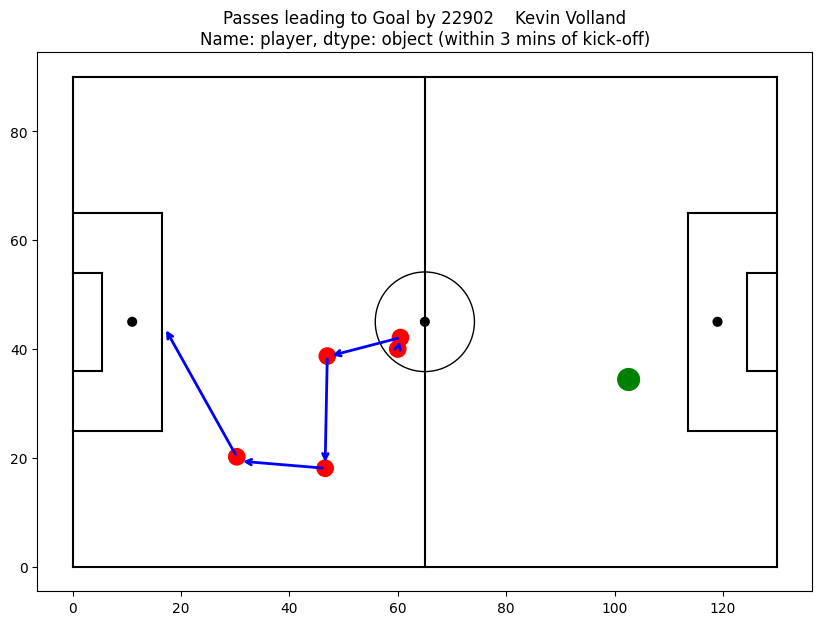

  Match ID: 3930161, Team: Albania, Minute: 0


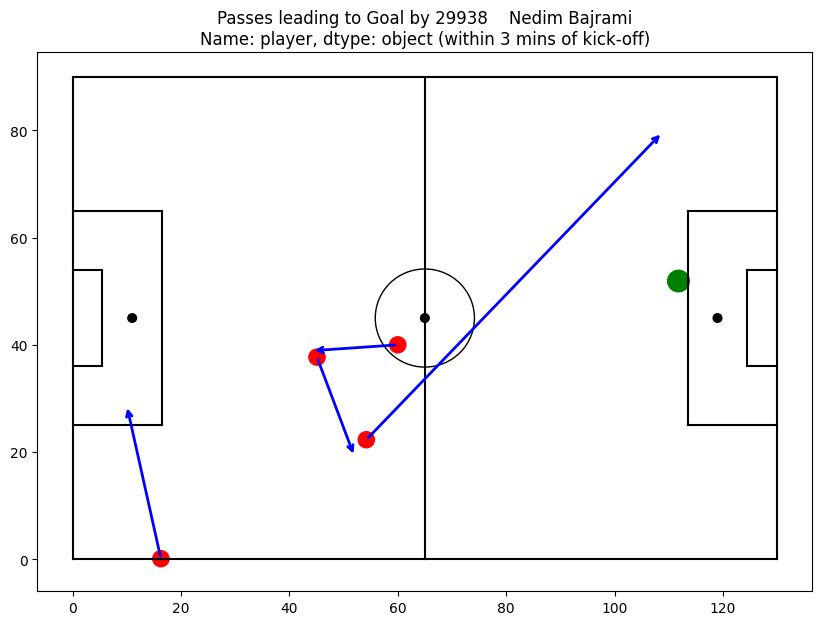


Cluster 13:
6
3754075 Chelsea 45
3754110 West Ham United 0
3788773 France 46
3825572 Real Madrid 46
3825756 Sevilla 0
3825756 Sevilla 46
6
Match IDs and Scoring Teams:
  Match ID: 3754075, Team: Chelsea, Minute: 45


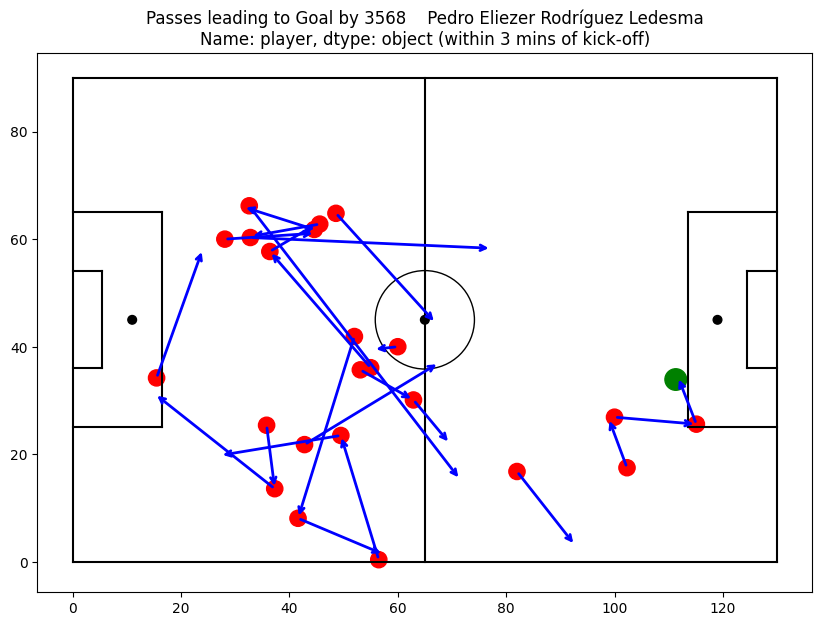

  Match ID: 3754110, Team: West Ham United, Minute: 0


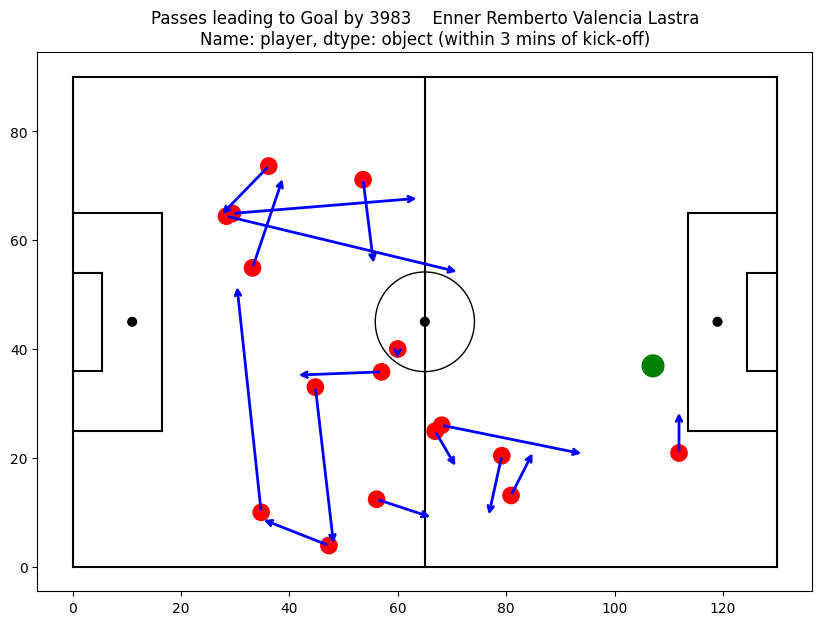

  Match ID: 3788773, Team: France, Minute: 46


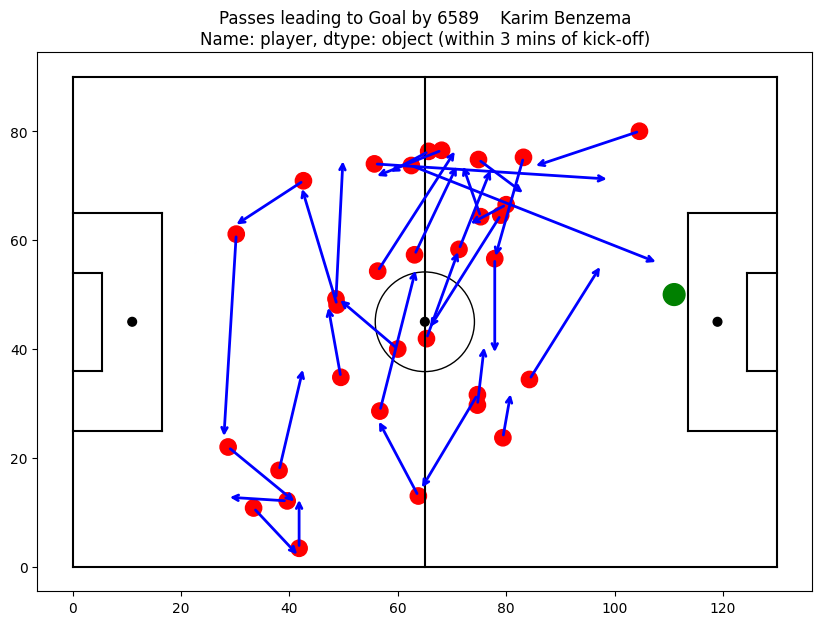

  Match ID: 3825572, Team: Real Madrid, Minute: 46


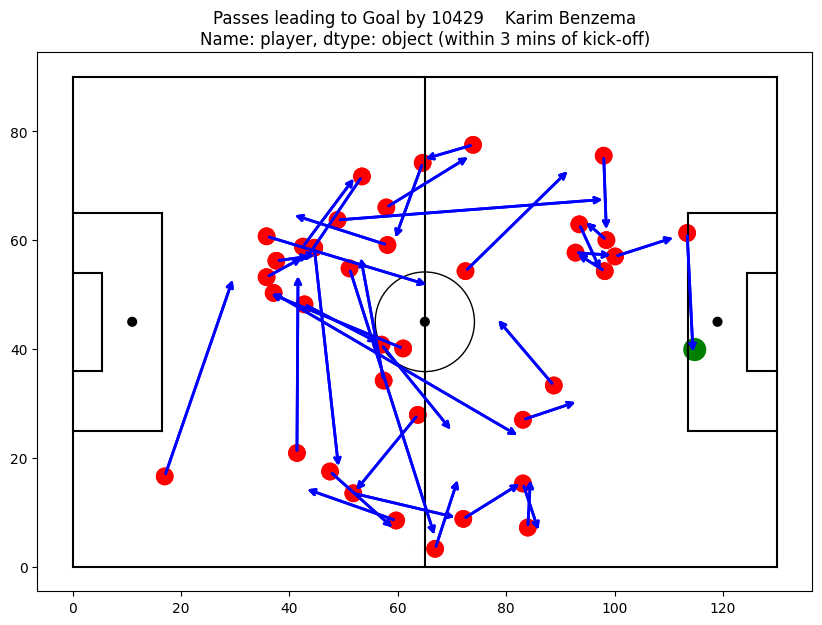

  Match ID: 3825756, Team: Sevilla, Minute: 0


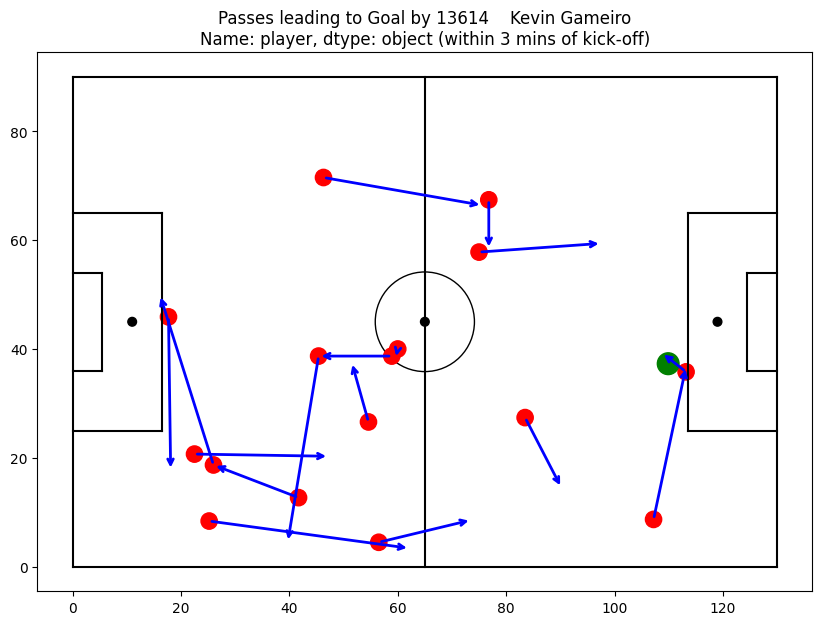

  Match ID: 3825756, Team: Sevilla, Minute: 46


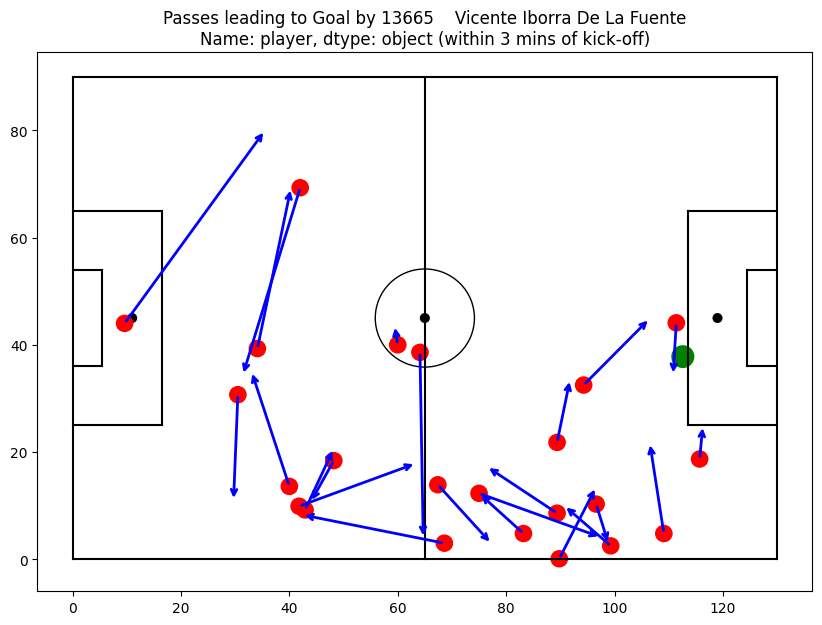


Cluster 14:
4
3813264 ATK Mohun Bagan 0
3879835 Chievo 46
3900633 Gazélec Ajaccio 0
3901170 Rennes 0
4
Match IDs and Scoring Teams:
  Match ID: 3813264, Team: ATK Mohun Bagan, Minute: 0


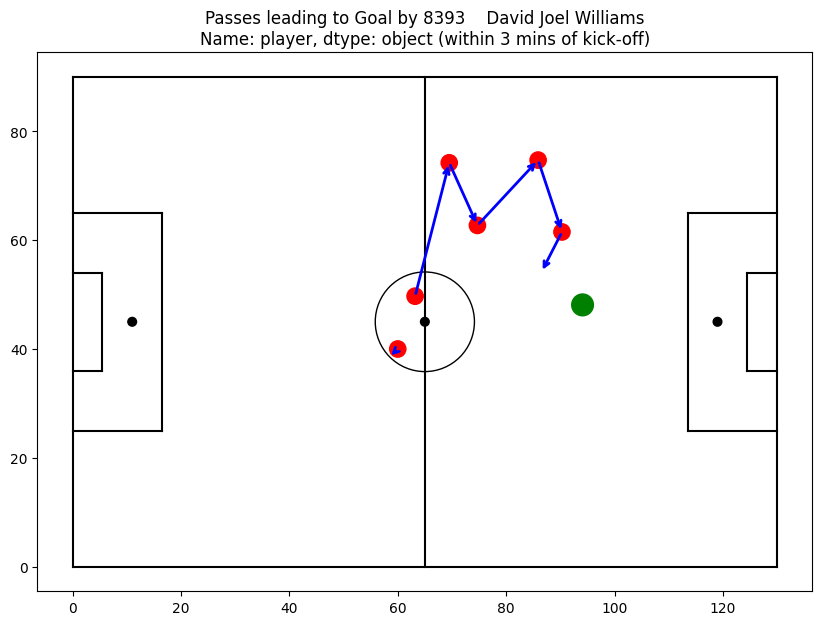

  Match ID: 3879835, Team: Chievo, Minute: 46


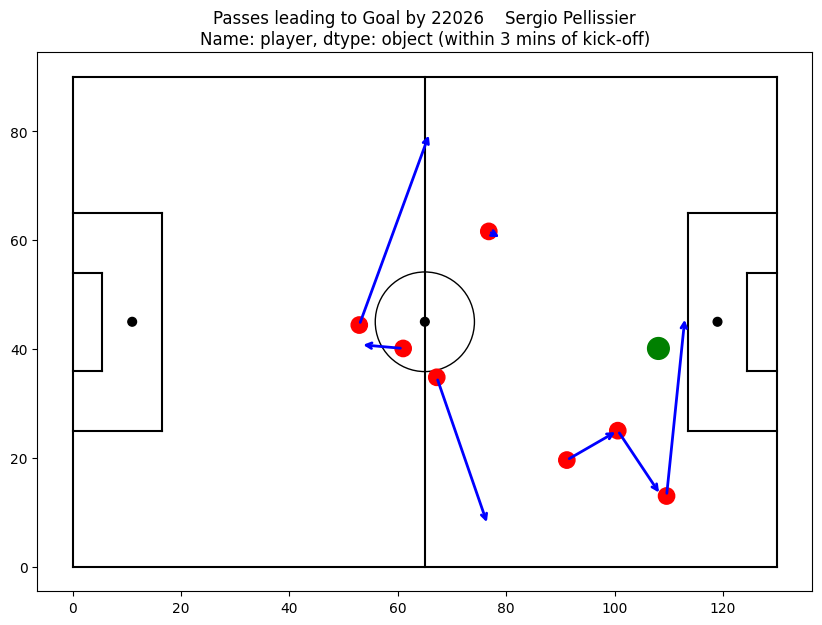

  Match ID: 3900633, Team: Gazélec Ajaccio, Minute: 0


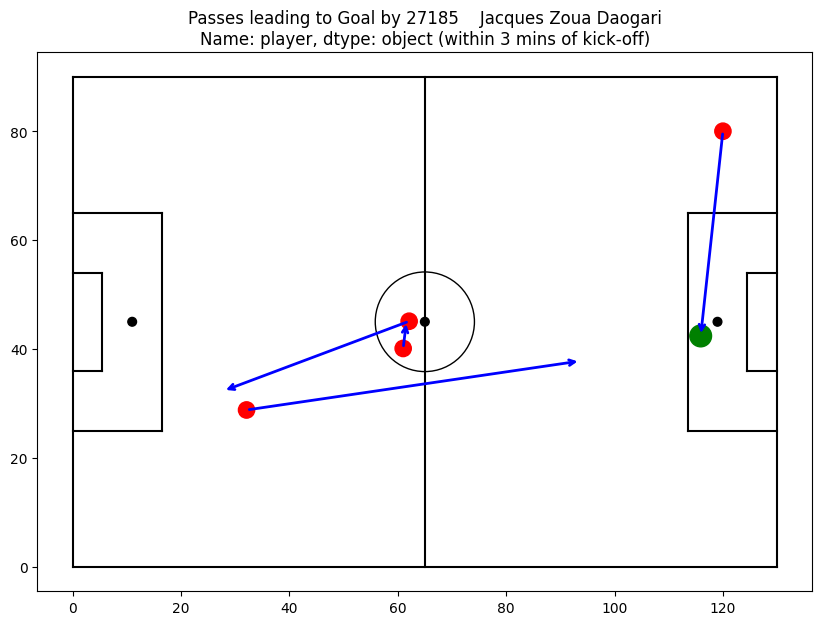

  Match ID: 3901170, Team: Rennes, Minute: 0


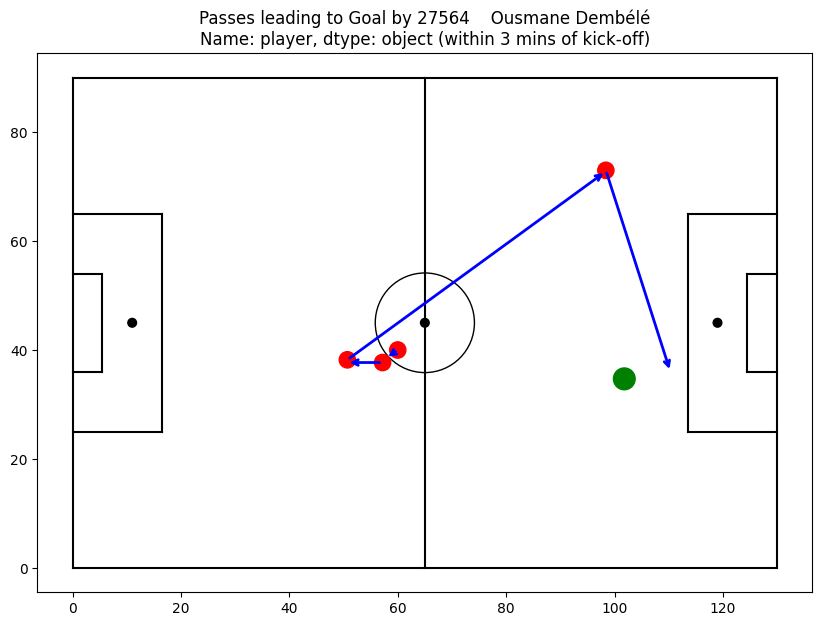


Cluster 15:
2
3829498 Lorient 46
3879745 Palermo 1
2
Match IDs and Scoring Teams:
  Match ID: 3829498, Team: Lorient, Minute: 46


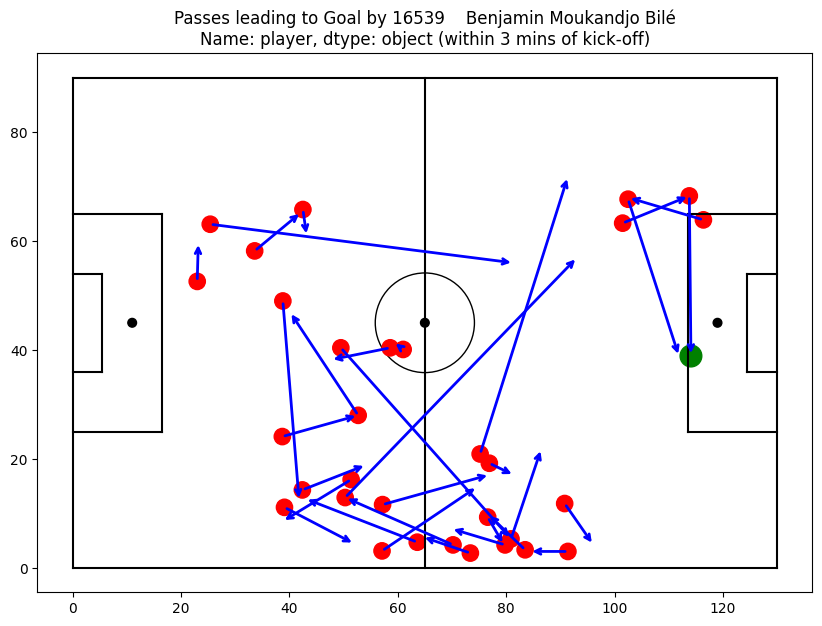

  Match ID: 3879745, Team: Palermo, Minute: 1


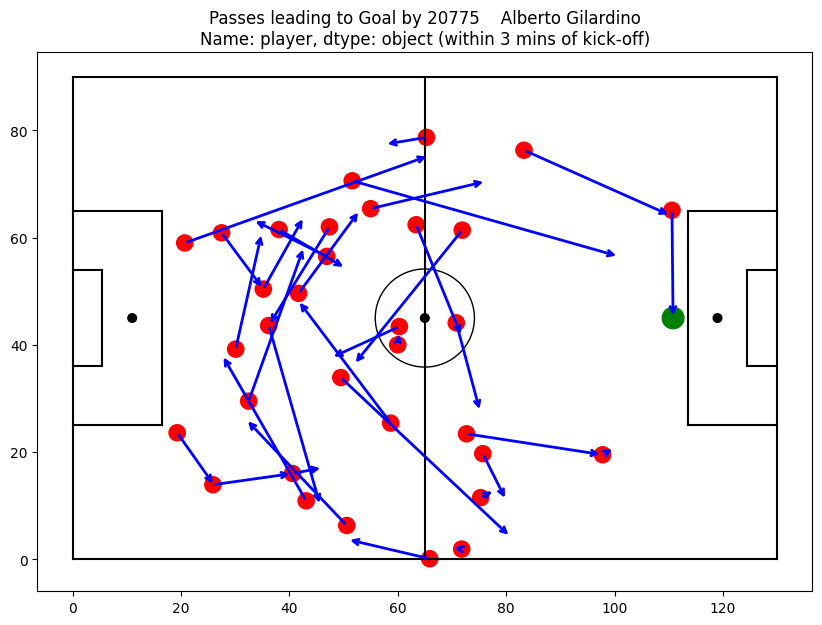


Cluster 16:
5
266149 Barcelona 46
266310 Barcelona 46
3754317 Tottenham Hotspur 1
3825589 Getafe 1
3879769 Chievo 1
5
Match IDs and Scoring Teams:
  Match ID: 266149, Team: Barcelona, Minute: 46


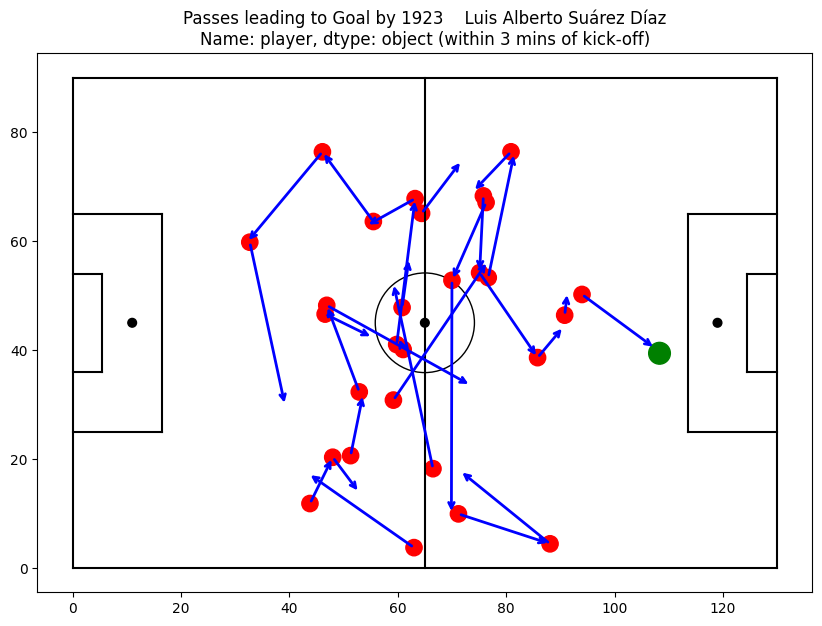

  Match ID: 266310, Team: Barcelona, Minute: 46


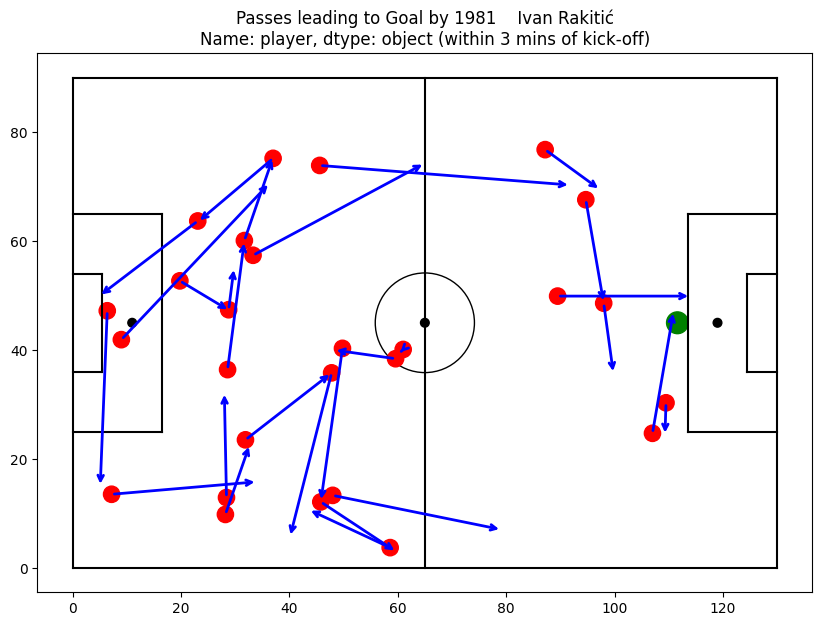

  Match ID: 3754317, Team: Tottenham Hotspur, Minute: 1


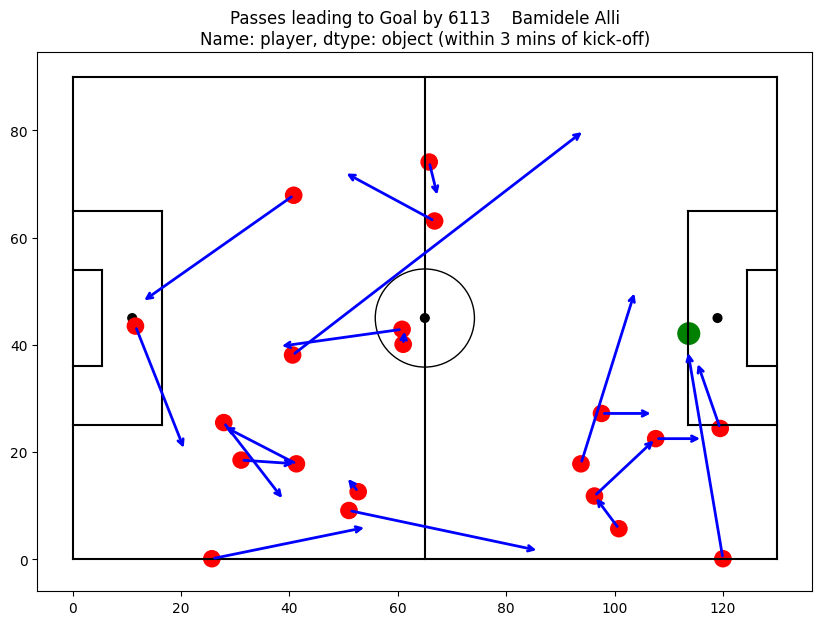

  Match ID: 3825589, Team: Getafe, Minute: 1


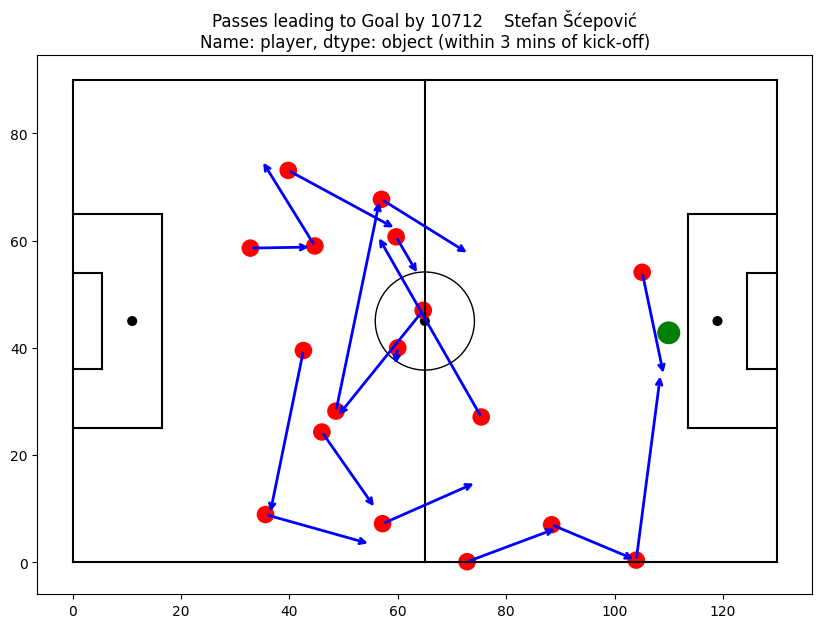

  Match ID: 3879769, Team: Chievo, Minute: 1


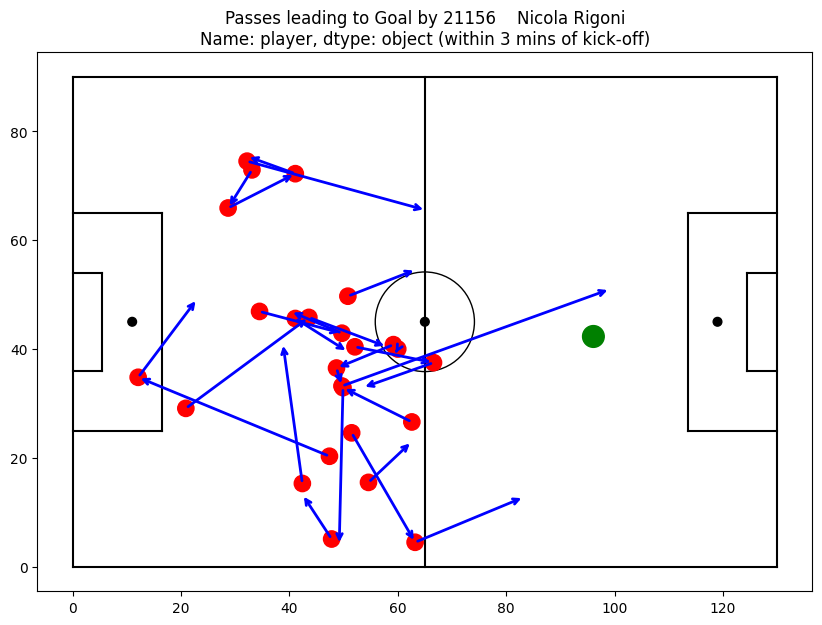


Cluster 17:
1
3900629 Paris Saint-Germain 1
1
Match IDs and Scoring Teams:
  Match ID: 3900629, Team: Paris Saint-Germain, Minute: 1


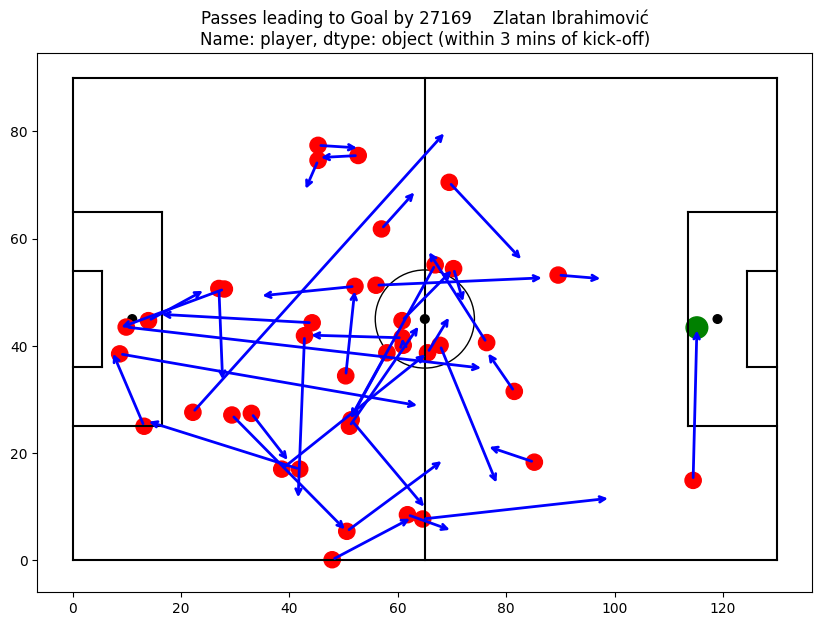


Cluster 18:
4
3817848 ATK Mohun Bagan 45
3879815 Torino 45
3890329 Bayern Munich 45
3900594 Nantes 0
4
Match IDs and Scoring Teams:
  Match ID: 3817848, Team: ATK Mohun Bagan, Minute: 45


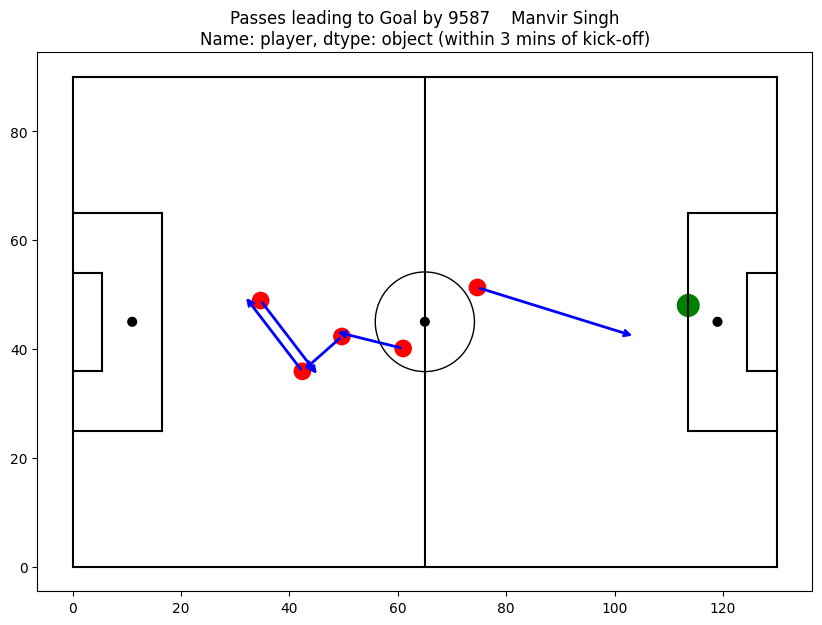

  Match ID: 3879815, Team: Torino, Minute: 45


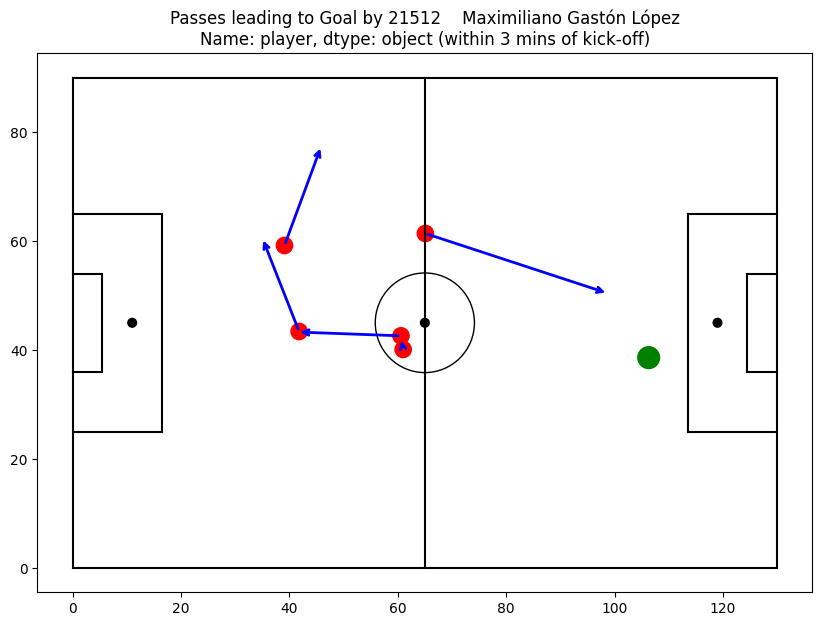

  Match ID: 3890329, Team: Bayern Munich, Minute: 45


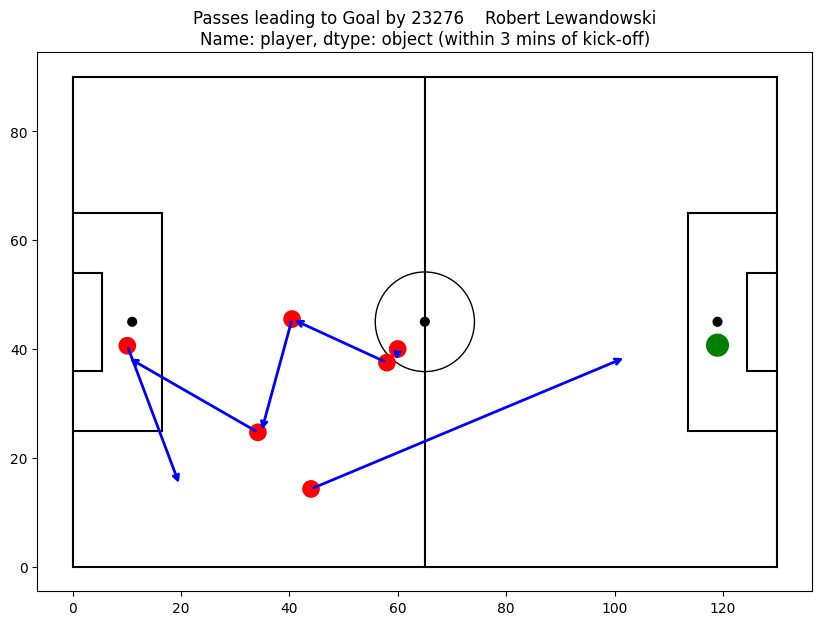

  Match ID: 3900594, Team: Nantes, Minute: 0


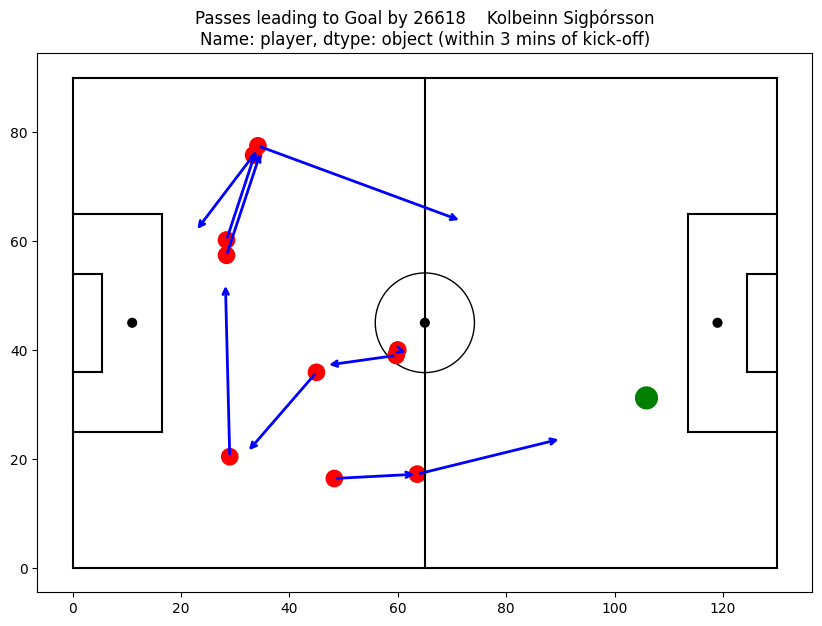


Cluster 19:
1
3879843 Sassuolo 1
1
Match IDs and Scoring Teams:
  Match ID: 3879843, Team: Sassuolo, Minute: 1


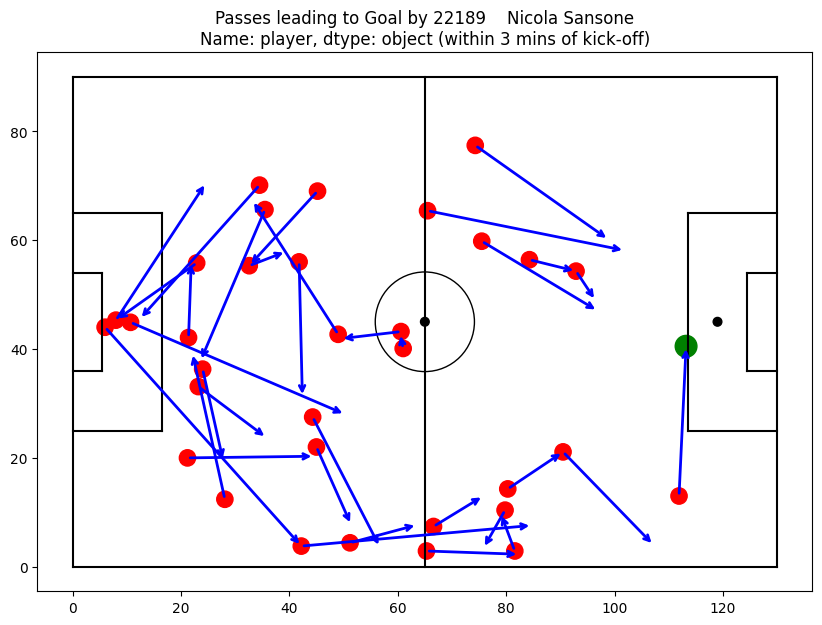


Cluster 20:
2
3754026 Crystal Palace 46
3754246 Manchester City 46
2
Match IDs and Scoring Teams:
  Match ID: 3754026, Team: Crystal Palace, Minute: 46


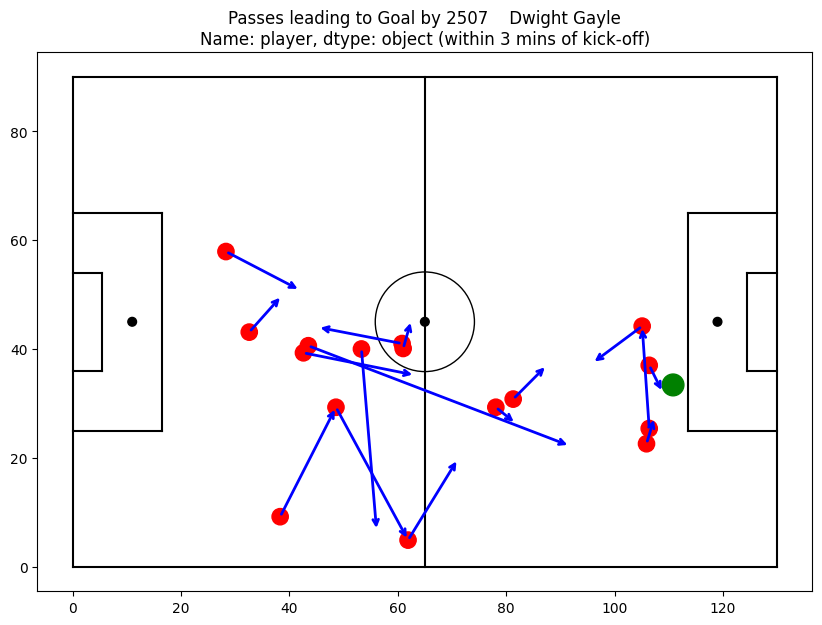

  Match ID: 3754246, Team: Manchester City, Minute: 46


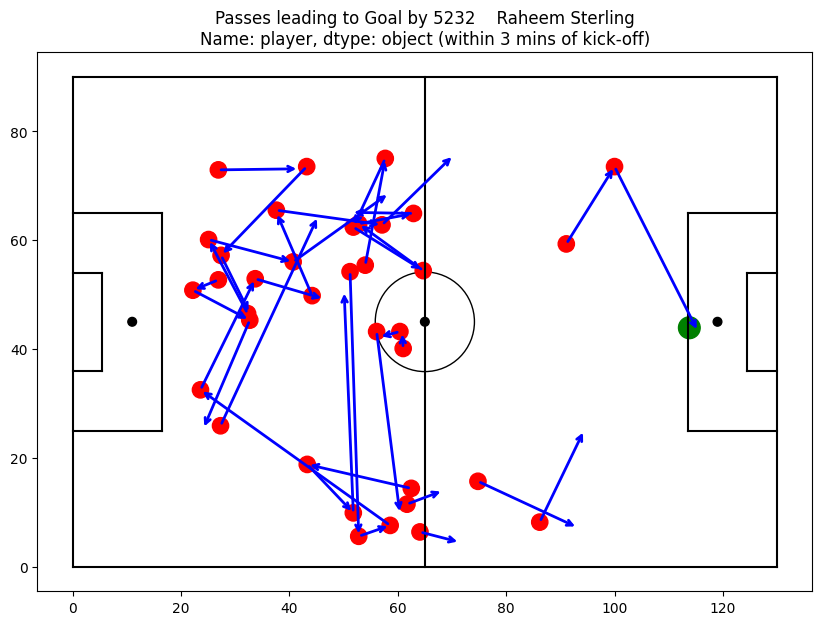

In [ ]:
for cluster_num in range(optimal_clusters):
  print(f"\nCluster {cluster_num}:")
  cluster_seqs = clustered_sequences[clustered_sequences['cluster'] == cluster_num]['sequence']
  cluster_match_info = []

  print(len(cluster_seqs.index))

  for seq in cluster_seqs.index:
    match_id, team, minute = sequences_with_match[seq][0]
    print(match_id, team, minute)

    df_events = sequences_with_match[seq][1]
    cluster_match_info.append([match_id, team, minute, df_events])

  print(len(cluster_match_info))
  print("Match IDs and Scoring Teams:")
  for match_id, team, minute, events in cluster_match_info:
    print(f"  Match ID: {match_id}, Team: {team}, Minute: {minute}")
    pass_events = events[(events['event_type'] == 'Pass') ]

    # Identify all goal events (shots with outcome 'Goal')
    goal = events[(events['event_type'] == 'Shot') & (events['shot_outcome'] == 'Goal')].head(1)

    # Plot the passes on the football pitch
    ax = draw_pitch()
    for _, pass_event in pass_events.iterrows():
        location = pass_event['location']
        location = string_to_list(location)
        start_x, start_y = location
        end_location = pass_event['pass_end_location']
        end_location = string_to_list(end_location)
        end_x, end_y = end_location

        # Plot the pass arrow
        ax.annotate('', xy=(end_x, end_y), xytext=(start_x, start_y),
                    arrowprops=dict(arrowstyle="->", color='blue', lw=2))

        # Optionally, add a circle for the start of the pass
        ax.add_patch(plt.Circle((start_x, start_y), 1.5, color='red', fill=True))

    # Mark the location of the goal
    goal_location = goal['location'].values[0]
    goal_location = string_to_list(goal_location)
    ax.add_patch(plt.Circle((goal_location[0], goal_location[1]), 2, color='green', fill=True))

    plt.title(f"Passes leading to Goal by {goal['player']} (within 3 mins of kick-off)")
    plt.show()

## Guardar los datos

In [ ]:
EG_Sequences = pd.DataFrame(columns=['match_id', 'team', 'minute', 'sequence', 'cluster', 'df_events'])

for cluster_num in range(optimal_clusters):
  cluster_seqs = clustered_sequences[clustered_sequences['cluster'] == cluster_num]['sequence']
  cluster_match_info = []

  for seq_index in cluster_seqs.index:
    match_id, team, minute = sequences_with_match[seq_index][0]
    df_events = sequences_with_match[seq_index][1]
    dict_sequence = event_descriptions[seq_index]
    cluster_match_info.append([match_id, team, minute, sequences_gen[seq_index], cluster_num, df_events, dict_sequence])

  temp_df = pd.DataFrame(cluster_match_info, columns=['match_id', 'team', 'minute', 'sequence', 'cluster', 'df_events', 'dict_sequences'])

  EG_Sequences = pd.concat([EG_Sequences, temp_df], ignore_index=True)

In [ ]:
EG_Sequences[['match_id', 'team', 'minute', 'sequence', 'cluster', 'dict_sequences']]

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


,match_id,team,minute,sequence,cluster,dict_sequences
0,3754154,Liverpool,1,"[Possession_From Kick Off_Short_YES_T2, Posses...",0,"[{'team': 'YES', 'third': 'T2', 'events': [{'t..."
1,3754280,Chelsea,0,"[Possession_From Kick Off_Medium_YES_T2, Posse...",0,"[{'team': 'YES', 'third': 'T2', 'events': [{'t..."
2,3813282,Kerala Blasters,46,"[Possession_From Kick Off_Short_YES_T2, Posses...",0,"[{'team': 'YES', 'third': 'T2', 'events': [{'t..."
3,3825610,Real Betis,45,"[Possession_From Kick Off_Short_YES_T2, Posses...",0,"[{'team': 'YES', 'third': 'T2', 'events': [{'t..."
4,3825774,Atlético Madrid,1,"[Possession_From Kick Off_Medium_YES_T2, Posse...",0,"[{'team': 'YES', 'third': 'T2', 'events': [{'t..."
...,...,...,...,...,...,...
137,3890329,Bayern Munich,45,"[Possession_From Kick Off_Medium_YES_T2, Posse...",18,"[{'team': 'YES', 'third': 'T2', 'events': [{'t..."
138,3900594,Nantes,0,"[Possession_From Kick Off_Medium_YES_T2, Posse...",18,"[{'team': 'YES', 'third': 'T2', 'events': [{'t..."
139,3879843,Sassuolo,1,"[Possession_From Kick Off_Medium_YES_T2, Posse...",19,"[{'team': 'YES', 'third': 'T2', 'events': [{'t..."
140,3754026,Crystal Palace,46,"[Possession_From Kick Off_Medium_YES_T2, Posse...",20,"[{'team': 'YES', 'third': 'T2', 'events': [{'t..."


# Información adicional

In [ ]:
def count_possessions(sequence, string):
    short_count = 0
    medium_count = 0
    long_count = 0
    for event in sequence:
        if string in event:
            if "Short" in event:
                short_count += 1
            elif "Medium" in event:
                medium_count += 1
            elif "Long" in event:
                long_count += 1
    return short_count, medium_count, long_count

EG_Sequences[['KO_short_possessions', 'KO_medium_possessions', 'KO_long_possessions']] = EG_Sequences['sequence'].apply(lambda x: pd.Series(count_possessions(x, "YES")))
EG_Sequences[['DS_short_possessions', 'DS_medium_possessions', 'DS_long_possessions']] = EG_Sequences['sequence'].apply(lambda x: pd.Series(count_possessions(x, "NO")))

In [ ]:
def process_events(events):

  last_event = {}
  second_last_event = {}
  shot_data = {}

  if len(events) > 0:
    shot_data = events[-1]

  if len(events) > 1:

    last_pos = events[-2]

    if 'events' in last_pos:

      last_event = last_pos['events'][-1]

      if len(last_pos['events']) > 1:
        last_event = last_pos['events'][-1]
        second_last_event = last_pos['events'][-2]
        print("Case 1")
        print(last_event)
        print(second_last_event)

      else:
        sec_last_pos = events[-3]

        if 'events' in sec_last_pos:
          second_last_event = sec_last_pos['events'][-1]
        else:
          second_last_event = sec_last_pos

        print("Case 2")
        print(last_event)
        print(second_last_event)

    else:
      last_event = last_pos

      if len(events) > 2:

        second_last_pos = events[-3]

        if 'events' in second_last_pos:
          second_last_event = second_last_pos['events'][-1]
        else:
          second_last_event = second_last_pos

        print("Case 3")
        print(last_event)
        print(second_last_event)

      else:
        second_last_event = []

  return last_event, second_last_event, shot_data

EG_Sequences['last_event'], EG_Sequences['second_last_event'], EG_Sequences['shot_data'] = zip(*EG_Sequences['dict_sequences'].apply(process_events))

Case 2
{'type': 'Carry', 'play_source': 'From Free Kick', 'length': 'Short', 'direction': 'Sideways', 'third': 'T1', 'team': 'YES'}
{'type': 'Pass', 'play_source': 'From Free Kick', 'pass_type': 'None', 'pass_detail': 'High Pass', 'length': 'Long', 'direction': 'Towards', 'third': 'T2', 'team': 'YES'}
Case 1
{'type': 'Carry', 'play_source': 'From Throw In', 'length': 'Medium', 'direction': 'Towards', 'third': 'T2', 'team': 'NO'}
{'type': 'Pass', 'play_source': 'From Throw In', 'pass_type': 'None', 'pass_detail': 'Ground Pass', 'length': 'Medium', 'direction': 'Sideways', 'third': 'T2', 'team': 'NO'}
Case 1
{'type': 'Pass', 'play_source': 'From Throw In', 'pass_type': 'Cross', 'pass_detail': 'High Pass', 'length': 'Long', 'direction': 'Towards', 'third': 'T1', 'team': 'YES'}
{'type': 'Carry', 'play_source': 'From Throw In', 'length': 'Short', 'direction': 'Sideways', 'third': 'T1', 'team': 'YES'}
Case 1
{'type': 'Pass', 'play_source': 'Regular Play', 'pass_type': 'None', 'pass_detail': 

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [ ]:
EG_Sequences

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


,match_id,team,minute,sequence,cluster,df_events,dict_sequences,KO_short_possessions,KO_medium_possessions,KO_long_possessions,DS_short_possessions,DS_medium_possessions,DS_long_possessions,last_event,second_last_event,shot_data
0,3754154,Liverpool,1,"[Possession_From Kick Off_Short_YES_T2, Posses...",0,match_id competition_name season_name h...,"[{'team': 'YES', 'third': 'T2', 'events': [{'t...",6,0,0,3,0,0,"{'type': 'Carry', 'play_source': 'From Free Ki...","{'type': 'Pass', 'play_source': 'From Free Kic...","{'type': 'Shot', 'event': {'type': 'Shot', 'pl..."
1,3754280,Chelsea,0,"[Possession_From Kick Off_Medium_YES_T2, Posse...",0,match_id competition_name season_name ...,"[{'team': 'YES', 'third': 'T2', 'events': [{'t...",2,1,0,4,2,0,"{'type': 'Carry', 'play_source': 'From Throw I...","{'type': 'Pass', 'play_source': 'From Throw In...","{'type': 'Shot', 'event': {'type': 'Shot', 'pl..."
2,3813282,Kerala Blasters,46,"[Possession_From Kick Off_Short_YES_T2, Posses...",0,match_id competition_name season_nam...,"[{'team': 'YES', 'third': 'T2', 'events': [{'t...",3,3,1,2,0,0,"{'type': 'Pass', 'play_source': 'From Throw In...","{'type': 'Carry', 'play_source': 'From Throw I...","{'type': 'Shot', 'event': {'type': 'Shot', 'pl..."
3,3825610,Real Betis,45,"[Possession_From Kick Off_Short_YES_T2, Posses...",0,match_id competition_name season_name ...,"[{'team': 'YES', 'third': 'T2', 'events': [{'t...",5,3,0,0,1,0,"{'type': 'Pass', 'play_source': 'Regular Play'...","{'type': 'Carry', 'play_source': 'Regular Play...","{'type': 'Shot', 'event': {'type': 'Shot', 'pl..."
4,3825774,Atlético Madrid,1,"[Possession_From Kick Off_Medium_YES_T2, Posse...",0,match_id competition_name season_name h...,"[{'team': 'YES', 'third': 'T2', 'events': [{'t...",5,1,1,2,0,0,"{'type': 'Pass', 'play_source': 'Regular Play'...","{'type': 'Carry', 'play_source': 'Regular Play...","{'type': 'Shot', 'event': {'type': 'Shot', 'pl..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
137,3890329,Bayern Munich,45,"[Possession_From Kick Off_Medium_YES_T2, Posse...",18,match_id competition_name season_name ...,"[{'team': 'YES', 'third': 'T2', 'events': [{'t...",4,2,0,0,0,0,"{'type': 'Carry', 'play_source': 'From Kick Of...","{'type': 'Dribble', 'event': {'type': 'Dribble...","{'type': 'Shot', 'event': {'type': 'Shot', 'pl..."
138,3900594,Nantes,0,"[Possession_From Kick Off_Medium_YES_T2, Posse...",18,match_id competition_name season_name h...,"[{'team': 'YES', 'third': 'T2', 'events': [{'t...",0,2,0,3,1,0,"{'type': 'Carry', 'play_source': 'From Counter...","{'type': 'Dribble', 'event': {'type': 'Dribble...","{'type': 'Shot', 'event': {'type': 'Shot', 'pl..."
139,3879843,Sassuolo,1,"[Possession_From Kick Off_Medium_YES_T2, Posse...",19,match_id competition_name season_name h...,"[{'team': 'YES', 'third': 'T2', 'events': [{'t...",6,2,0,9,3,0,"{'type': 'Pass', 'play_source': 'From Free Kic...","{'type': 'Carry', 'play_source': 'From Free Ki...","{'type': 'Shot', 'event': {'type': 'Shot', 'pl..."
140,3754026,Crystal Palace,46,"[Possession_From Kick Off_Medium_YES_T2, Posse...",20,match_id competition_name season_name ...,"[{'team': 'YES', 'third': 'T2', 'events': [{'t...",10,3,0,3,0,0,"{'type': 'Pass', 'play_source': 'Regular Play'...","{'type': 'Carry', 'play_source': 'Regular Play...","{'type': 'Shot', 'event': {'type': 'Shot', 'pl..."


## Variables de rendimiento del equipo

In [ ]:
EG_performance_indicators = pd.read_csv('/content/drive/MyDrive/Hackathon FUT/Data/EG_team_metrics_surrounding.csv').dropna()
EG_performance_indicators

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


,original_match_id,original_goal_minute,original_competition_name,original_season_name,original_half,original_home_team,original_away_team,original_scoring_team,related_match_id,related_team,GF,GA,Shots_on_Target,Shots_off_Target,Possession_Percentage,Pass_Accuracy_Percentage,xG,xGA
0,3890511,3,1. Bundesliga,2015/2016,1,Hertha Berlin,Hannover 96,Hertha Berlin,3890470,Hertha Berlin,2,0,7,5,44.988865,71.805274,1.500296,0.367560
1,3890511,3,1. Bundesliga,2015/2016,1,Hertha Berlin,Hannover 96,Hertha Berlin,3890470,Eintracht Frankfurt,0,2,6,5,55.011135,70.137525,0.367560,1.500296
2,3890511,3,1. Bundesliga,2015/2016,1,Hertha Berlin,Hannover 96,Hertha Berlin,3890483,Hamburger SV,2,0,8,7,50.299898,76.988156,1.016613,0.255552
3,3890511,3,1. Bundesliga,2015/2016,1,Hertha Berlin,Hannover 96,Hertha Berlin,3890483,Hertha Berlin,0,2,2,1,49.700102,70.495495,0.255552,1.016613
4,3890511,3,1. Bundesliga,2015/2016,1,Hertha Berlin,Hannover 96,Hertha Berlin,3890484,Hertha Berlin,2,0,13,4,44.333284,80.434783,1.555961,1.346624
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
16959,69199,2,Women's World Cup,2019,1,Norway Women's,England Women's,England Women's,69301,Sweden Women's,2,1,6,2,31.671936,67.988669,0.549279,0.473843
16960,69199,2,Women's World Cup,2019,1,Norway Women's,England Women's,England Women's,3835319,England Women's,1,0,9,7,53.630738,83.274648,2.079074,0.471990
16961,69199,2,Women's World Cup,2019,1,Norway Women's,England Women's,England Women's,3835319,Austria Women's,0,1,7,2,46.369262,71.428571,0.471990,2.079074
16962,69199,2,Women's World Cup,2019,1,Norway Women's,England Women's,England Women's,3835327,England Women's,8,0,14,10,73.346831,86.779661,6.193674,0.210471


In [ ]:
EG_performance_indicators['GD'] = EG_performance_indicators['GF'] - EG_performance_indicators['GA']
EG_performance_indicators['xGdf'] = EG_performance_indicators['GF'] - EG_performance_indicators['xG']
EG_performance_indicators['xGD'] = EG_performance_indicators['xG'] - EG_performance_indicators['xGA']

In [ ]:
from io import StringIO

numeric_cols = ['GD', 'xGD', 'xGdf', 'GF', 'GA', 'xG', 'xGA', 'Possession_Percentage']
EG_performance_indicators[numeric_cols] = EG_performance_indicators[numeric_cols].apply(pd.to_numeric)

original_matches = EG_performance_indicators[['original_match_id', 'original_competition_name','original_season_name', 'original_home_team', 'original_away_team','original_scoring_team']].drop_duplicates()

results = []

for idx, match in original_matches.iterrows():
    match_id = match['original_match_id']
    home_team = match['original_home_team']
    away_team = match['original_away_team']
    scoring_team = match['original_scoring_team']
    comp = match['original_competition_name']
    season = match['original_season_name']

    match_result = {
        'original_match_id': match_id,
        'comp': comp,
        'season': season,
        'home_team': home_team,
        'away_team': away_team,
        'scoring_team': scoring_team,
    }

    for team in [home_team, away_team]:
        if team == scoring_team:
            prefix = 'scoring_team'
        else:
            prefix = 'not_scoring_team'

        related_matches = EG_performance_indicators[
            (EG_performance_indicators['related_team'] == team) &
            (EG_performance_indicators['related_match_id'] != match_id)
        ]

        if not related_matches.empty:
            indicators = related_matches[numeric_cols].mean().to_dict()

            indicators = {f"{prefix}_{k}": v for k, v in indicators.items()}

            match_result.update(indicators)
        else:
            indicators = {f"{prefix}_{k}": None for k in numeric_cols}
            match_result.update(indicators)

    results.append(match_result)

results_df = pd.DataFrame(results)

In [ ]:
results_df = results_df.dropna()

## Datos Completos

In [ ]:
results_df.sort_values(by=['original_match_id'], inplace=True)
results_df

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


,original_match_id,comp,season,home_team,away_team,scoring_team,scoring_team_GD,scoring_team_xGD,scoring_team_xGdf,scoring_team_GF,...,scoring_team_xGA,scoring_team_Possession_Percentage,not_scoring_team_GD,not_scoring_team_xGD,not_scoring_team_xGdf,not_scoring_team_GF,not_scoring_team_GA,not_scoring_team_xG,not_scoring_team_xGA,not_scoring_team_Possession_Percentage
92,7298,FA Women's Super League,2018/2019,Manchester City WFC,Chelsea FCW,Manchester City WFC,2.020906,1.370377,0.396466,2.689895,...,0.923053,58.788840,2.087719,1.762478,0.268667,2.714912,0.627193,2.446245,0.683768,58.597502
124,7536,FIFA World Cup,2018,Belgium,Panama,Belgium,0.704225,0.094988,0.039319,1.422535,...,1.288228,52.769493,-2.222222,-1.181312,0.346236,1.222222,3.444444,0.875986,2.057298,49.928782
123,7542,FIFA World Cup,2018,Portugal,Morocco,Portugal,0.575000,0.666950,0.128112,1.975000,...,1.179938,59.868875,0.840000,-0.344027,0.324056,1.320000,0.480000,0.995944,1.339970,35.592345
130,7549,FIFA World Cup,2018,Nigeria,Iceland,Nigeria,-0.312500,0.458773,-0.673762,0.625000,...,0.839989,43.283344,-0.500000,0.205182,-0.582406,1.000000,1.500000,1.582406,1.377224,34.239750
126,7551,FIFA World Cup,2018,Germany,Sweden,Germany,-0.590909,0.670481,-0.869317,0.863636,...,1.062472,59.228681,0.160000,-0.000577,-0.108051,1.120000,0.960000,1.228051,1.228628,32.421830
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
46,3939987,Copa America,2024,Jamaica,Venezuela,Venezuela,0.142857,-0.297731,-0.616642,2.571429,...,3.485801,53.797864,-1.000000,-1.013384,-0.220453,0.500000,1.500000,0.720453,1.733837,51.007269
45,3939992,Copa America,2024,Costa Rica,Paraguay,Costa Rica,-2.230769,-1.765337,0.060835,0.384615,...,2.089117,33.749884,-2.000000,-1.425169,0.240364,1.000000,3.000000,0.759636,2.184805,39.766571
400,3940878,UEFA Euro,2024,Switzerland,Italy,Switzerland,-0.320000,-0.251164,0.008412,2.100000,...,2.342752,48.230172,1.076923,0.398072,-0.063557,2.384615,1.307692,2.448172,2.050101,54.282639
399,3941022,UEFA Euro,2024,Austria,Turkey,Turkey,-0.687500,-0.493376,-0.205756,1.125000,...,1.824131,54.345085,0.050000,-0.391568,0.052435,1.200000,1.150000,1.147565,1.539133,48.359141


In [ ]:
EG_Sequences.sort_values(by=['match_id', 'minute'], inplace=True)
EG_Sequences

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


,match_id,team,minute,sequence,cluster,df_events,dict_sequences,KO_short_possessions,KO_medium_possessions,KO_long_possessions,DS_short_possessions,DS_medium_possessions,DS_long_possessions,last_event,second_last_event,shot_data
9,7536,Belgium,46,"[Possession_From Kick Off_Medium_YES_T2, Posse...",1,match_id competition_name season_name home...,"[{'team': 'YES', 'third': 'T2', 'events': [{'t...",5,5,0,1,0,0,"{'type': 'Error', 'event': {'type': 'Error', '...","{'type': 'Pass', 'play_source': 'From Throw In...","{'type': 'Shot', 'event': {'type': 'Shot', 'pl..."
67,7581,Denmark,0,"[Possession_From Kick Off_Short_YES_T2, Posses...",6,match_id competition_name season_name hom...,"[{'team': 'YES', 'third': 'T2', 'events': [{'t...",9,0,0,4,0,0,"{'type': 'Carry', 'play_source': 'From Throw I...","{'type': 'Pass', 'play_source': 'From Throw In...","{'type': 'Shot', 'event': {'type': 'Shot', 'pl..."
74,265894,Barcelona,1,"[Possession_From Kick Off_Medium_YES_T2, Posse...",7,match_id competition_name season_name ho...,"[{'team': 'YES', 'third': 'T2', 'events': [{'t...",2,3,1,0,0,0,"{'type': 'Shot', 'event': {'type': 'Shot', 'pl...","{'type': 'Carry', 'play_source': 'From Free Ki...","{'type': 'Shot', 'event': {'type': 'Shot', 'pl..."
129,266149,Barcelona,46,"[Possession_From Kick Off_Medium_YES_T2, Posse...",16,match_id competition_name season_name h...,"[{'team': 'YES', 'third': 'T2', 'events': [{'t...",9,4,0,1,1,0,"{'type': 'Pass', 'play_source': 'Regular Play'...","{'type': 'Carry', 'play_source': 'Regular Play...","{'type': 'Shot', 'event': {'type': 'Shot', 'pl..."
130,266310,Barcelona,46,"[Possession_From Kick Off_Medium_YES_T2, Posse...",16,match_id competition_name season_name ...,"[{'team': 'YES', 'third': 'T2', 'events': [{'t...",9,3,0,2,1,0,"{'type': 'Pass', 'play_source': 'Regular Play'...","{'type': 'Carry', 'play_source': 'Regular Play...","{'type': 'Shot', 'event': {'type': 'Shot', 'pl..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
66,3938644,Georgia,1,"[Possession_From Kick Off_Short_YES_T2, Posses...",5,match_id competition_name season_name h...,"[{'team': 'YES', 'third': 'T2', 'events': [{'t...",6,3,1,6,1,0,"{'type': 'Carry', 'play_source': 'From Counter...","{'type': 'Pass', 'play_source': 'From Counter'...","{'type': 'Shot', 'event': {'type': 'Shot', 'pl..."
36,3939986,Argentina,46,"[Possession_From Kick Off_Short_YES_T2, Posses...",2,match_id competition_name season_name ...,"[{'team': 'YES', 'third': 'T2', 'events': [{'t...",2,1,0,5,2,0,"{'type': 'Carry', 'play_source': 'Regular Play...","{'type': 'Pass', 'play_source': 'Regular Play'...","{'type': 'Shot', 'event': {'type': 'Shot', 'pl..."
99,3940878,Switzerland,45,"[Possession_From Kick Off_Medium_YES_T2, Posse...",9,match_id competition_name season_name ...,"[{'team': 'YES', 'third': 'T2', 'events': [{'t...",0,1,0,3,2,0,"{'type': 'Carry', 'play_source': 'Regular Play...","{'type': 'Pass', 'play_source': 'Regular Play'...","{'type': 'Shot', 'event': {'type': 'Shot', 'pl..."
8,3941022,Turkey,0,"[Possession_From Kick Off_Short_YES_T2, Posses...",0,match_id competition_name season_name h...,"[{'team': 'YES', 'third': 'T2', 'events': [{'t...",3,0,0,4,0,2,"{'type': 'Pass', 'play_source': 'From Corner',...","{'type': 'Pass', 'play_source': 'From Keeper',...","{'type': 'Shot', 'event': {'type': 'Shot', 'pl..."


In [ ]:
merged_df = pd.merge(EG_Sequences, results_df, left_on='match_id', right_on='original_match_id', how='inner')
merged_df.sort_values(by=['match_id', 'minute'], inplace=True)

In [ ]:
for column in ['GD', 'xGD', 'xGdf', 'GF', 'GA', 'xG', 'xGA', 'Possession_Percentage']:
  merged_df[f'{column}_diff'] = merged_df[f'scoring_team_{column}'] - merged_df[f'not_scoring_team_{column}']

In [ ]:
merged_df = merged_df.drop_duplicates(subset=['match_id'], keep='first')

In [ ]:
def categorize_difference(value):
    if 0.5 < value < 1:
        return 'low fav'
    elif 1 <= value < 1.5:
        return 'med fav'
    elif value >= 1.5:
        return 'high fav'
    elif -1 < value < -0.5:
        return 'low unfav'
    elif -1.5 < value <= -1:
        return 'med unfav'
    elif value <= -1.5:
        return 'high unfav'
    else:
        return 'neutral'

merged_df['x_fav'] = merged_df['xGD_diff'].apply(categorize_difference)
merged_df['fav'] = merged_df['GD_diff'].apply(categorize_difference)

In [ ]:
different_fav_rows = merged_df[merged_df['x_fav'] != merged_df['fav']]
different_fav_rows.head(5)

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


,match_id,team,minute,sequence,cluster,df_events,dict_sequences,KO_short_possessions,KO_medium_possessions,KO_long_possessions,...,GD_diff,xGD_diff,xGdf_diff,GF_diff,GA_diff,xG_diff,xGA_diff,Possession_Percentage_diff,x_fav,fav
0,7536,Belgium,46,"[Possession_From Kick Off_Medium_YES_T2, Posse...",1,match_id competition_name season_name home...,"[{'team': 'YES', 'third': 'T2', 'events': [{'t...",5,5,0,...,2.926448,1.276300,-0.306917,0.200313,-2.726135,0.507230,-0.769070,2.840712,med fav,high fav
3,265894,Barcelona,1,"[Possession_From Kick Off_Medium_YES_T2, Posse...",7,match_id competition_name season_name ho...,"[{'team': 'YES', 'third': 'T2', 'events': [{'t...",2,3,1,...,2.090615,1.436278,0.734581,2.007752,-0.082863,1.273171,-0.163107,15.661709,med fav,high fav
4,266149,Barcelona,46,"[Possession_From Kick Off_Medium_YES_T2, Posse...",16,match_id competition_name season_name h...,"[{'team': 'YES', 'third': 'T2', 'events': [{'t...",9,4,0,...,1.432129,0.973091,0.213794,1.119869,-0.312261,0.906075,-0.067016,15.924716,low fav,med fav
9,3754043,Tottenham Hotspur,0,"[Possession_From Kick Off_Short_YES_T2, Posses...",7,match_id competition_name season_name ...,"[{'team': 'YES', 'third': 'T2', 'events': [{'t...",5,0,1,...,1.758477,0.914668,0.193264,0.756347,-1.002129,0.563083,-0.351585,2.051664,low fav,high fav
10,3754075,Chelsea,45,"[Possession_From Kick Off_Short_YES_T2, Posses...",13,match_id competition_name season_name ...,"[{'team': 'YES', 'third': 'T2', 'events': [{'t...",9,3,0,...,1.688947,1.293304,0.003504,0.679211,-1.009737,0.675706,-0.617597,13.479869,med fav,high fav


In [ ]:
def get_team_scored_on(row):
  if row['scoring_team'] == row['home_team']:
    return row['away_team']
  elif row['scoring_team'] == row['away_team']:
    return row['home_team']
  else:
    return None

merged_df['team_scored_on'] = merged_df.apply(get_team_scored_on, axis=1)

In [ ]:
selected_columns = ['match_id','comp','season',

                    'home_team',
                    'away_team',

                    'scoring_team',
                    'team_scored_on',

                    'minute',

                    'cluster',

                    'KO_short_possessions',
                    'KO_medium_possessions',
                    'KO_long_possessions',
                    'DS_short_possessions',
                    'DS_medium_possessions',
                    'DS_long_possessions',

                    'last_event',
                    'second_last_event',
                    'shot_data',

                    'GD_diff',
                    'xGD_diff',
                    'xGdf_diff',

                    'GF_diff',
                    'GA_diff',
                    'xG_diff',
                    'xGA_diff',
                    'Possession_Percentage_diff',

                    'x_fav',
                    'fav'
                    ]

EG_full = merged_df[selected_columns]

In [ ]:
EG_full = EG_full.dropna()

In [ ]:
EG_full

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


,match_id,comp,season,home_team,away_team,scoring_team,team_scored_on,minute,cluster,KO_short_possessions,...,GD_diff,xGD_diff,xGdf_diff,GF_diff,GA_diff,xG_diff,xGA_diff,Possession_Percentage_diff,x_fav,fav
0,7536,FIFA World Cup,2018,Belgium,Panama,Belgium,Panama,46,1,5,...,2.926448,1.276300,-0.306917,0.200313,-2.726135,0.507230,-0.769070,2.840712,med fav,high fav
1,7581,FIFA World Cup,2018,Croatia,Denmark,Croatia,Denmark,0,6,9,...,-0.371212,0.045425,-0.047969,0.352652,0.723864,0.400621,0.355196,3.588275,neutral,neutral
3,265894,La Liga,2015/2016,Málaga,Barcelona,Barcelona,Málaga,1,7,2,...,2.090615,1.436278,0.734581,2.007752,-0.082863,1.273171,-0.163107,15.661709,med fav,high fav
4,266149,La Liga,2015/2016,Barcelona,Athletic Club,Barcelona,Athletic Club,46,16,9,...,1.432129,0.973091,0.213794,1.119869,-0.312261,0.906075,-0.067016,15.924716,low fav,med fav
5,266310,La Liga,2015/2016,RC Deportivo La Coruña,Barcelona,Barcelona,RC Deportivo La Coruña,46,16,9,...,2.600000,1.521999,0.454905,1.661538,-0.938462,1.206633,-0.315366,17.238028,high fav,high fav
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
144,3938644,UEFA Euro,2024,Georgia,Portugal,Georgia,Portugal,1,5,6,...,-2.458472,-2.222699,-0.516858,-1.239203,1.219269,-0.722345,1.500354,-19.277217,high unfav,high unfav
145,3939986,Copa America,2024,Argentina,Peru,Argentina,Peru,46,2,2,...,1.569892,1.316336,0.776259,2.413978,0.844086,1.637719,0.321384,7.027618,med fav,high fav
146,3940878,UEFA Euro,2024,Switzerland,Italy,Switzerland,Italy,45,9,0,...,-1.396923,-0.649236,0.071969,-0.284615,1.112308,-0.356585,0.292651,-6.052467,low unfav,med unfav
147,3941022,UEFA Euro,2024,Austria,Turkey,Turkey,Austria,0,0,3,...,-0.737500,-0.101808,-0.258190,-0.075000,0.662500,0.183190,0.284998,5.985945,neutral,low unfav


In [ ]:
EG_full.to_csv('/content/drive/MyDrive/Hackathon FUT/Data/EG_full.csv', index=False)

### Incluyendo df de eventos

In [ ]:
selected_columns = ['match_id','comp','season',

                    'home_team',
                    'away_team',

                    'scoring_team',
                    'team_scored_on',

                    'minute',

                    'cluster',

                    'KO_short_possessions',
                    'KO_medium_possessions',
                    'KO_long_possessions',
                    'DS_short_possessions',
                    'DS_medium_possessions',
                    'DS_long_possessions',

                    'last_event',
                    'second_last_event',
                    'shot_data',

                    'GD_diff',
                    'xGD_diff',
                    'xGdf_diff',

                    'GF_diff',
                    'GA_diff',
                    'xG_diff',
                    'xGA_diff',
                    'Possession_Percentage_diff',

                    'x_fav',
                    'fav',

                    'df_events',
                    'dict_sequences'
                    ]

EG_full_w_seq = merged_df[selected_columns]

In [ ]:
EG_full_w_seq = EG_full_w_seq.dropna()

In [ ]:
EG_full_w_seq

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


,match_id,comp,season,home_team,away_team,scoring_team,team_scored_on,minute,cluster,KO_short_possessions,...,GF_diff,GA_diff,xG_diff,xGA_diff,Possession_Percentage_diff,x_fav,fav,df_events,dict_sequences,df_events_dict
0,7536,FIFA World Cup,2018,Belgium,Panama,Belgium,Panama,46,1,5,...,0.200313,-2.726135,0.507230,-0.769070,2.840712,med fav,high fav,match_id competition_name season_name home...,"[{'team': 'YES', 'third': 'T2', 'events': [{'t...","[{'match_id': 7536, 'competition_name': 'FIFA ..."
1,7581,FIFA World Cup,2018,Croatia,Denmark,Croatia,Denmark,0,6,9,...,0.352652,0.723864,0.400621,0.355196,3.588275,neutral,neutral,match_id competition_name season_name hom...,"[{'team': 'YES', 'third': 'T2', 'events': [{'t...","[{'match_id': 7581, 'competition_name': 'FIFA ..."
3,265894,La Liga,2015/2016,Málaga,Barcelona,Barcelona,Málaga,1,7,2,...,2.007752,-0.082863,1.273171,-0.163107,15.661709,med fav,high fav,match_id competition_name season_name ho...,"[{'team': 'YES', 'third': 'T2', 'events': [{'t...","[{'match_id': 265894, 'competition_name': 'La ..."
4,266149,La Liga,2015/2016,Barcelona,Athletic Club,Barcelona,Athletic Club,46,16,9,...,1.119869,-0.312261,0.906075,-0.067016,15.924716,low fav,med fav,match_id competition_name season_name h...,"[{'team': 'YES', 'third': 'T2', 'events': [{'t...","[{'match_id': 266149, 'competition_name': 'La ..."
5,266310,La Liga,2015/2016,RC Deportivo La Coruña,Barcelona,Barcelona,RC Deportivo La Coruña,46,16,9,...,1.661538,-0.938462,1.206633,-0.315366,17.238028,high fav,high fav,match_id competition_name season_name ...,"[{'team': 'YES', 'third': 'T2', 'events': [{'t...","[{'match_id': 266310, 'competition_name': 'La ..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
144,3938644,UEFA Euro,2024,Georgia,Portugal,Georgia,Portugal,1,5,6,...,-1.239203,1.219269,-0.722345,1.500354,-19.277217,high unfav,high unfav,match_id competition_name season_name h...,"[{'team': 'YES', 'third': 'T2', 'events': [{'t...","[{'match_id': 3938644, 'competition_name': 'UE..."
145,3939986,Copa America,2024,Argentina,Peru,Argentina,Peru,46,2,2,...,2.413978,0.844086,1.637719,0.321384,7.027618,med fav,high fav,match_id competition_name season_name ...,"[{'team': 'YES', 'third': 'T2', 'events': [{'t...","[{'match_id': 3939986, 'competition_name': 'Co..."
146,3940878,UEFA Euro,2024,Switzerland,Italy,Switzerland,Italy,45,9,0,...,-0.284615,1.112308,-0.356585,0.292651,-6.052467,low unfav,med unfav,match_id competition_name season_name ...,"[{'team': 'YES', 'third': 'T2', 'events': [{'t...","[{'match_id': 3940878, 'competition_name': 'UE..."
147,3941022,UEFA Euro,2024,Austria,Turkey,Turkey,Austria,0,0,3,...,-0.075000,0.662500,0.183190,0.284998,5.985945,neutral,low unfav,match_id competition_name season_name h...,"[{'team': 'YES', 'third': 'T2', 'events': [{'t...","[{'match_id': 3941022, 'competition_name': 'UE..."


In [ ]:
EG_full_w_seq.to_csv('/content/drive/MyDrive/Hackathon FUT/Data/EG_full_w_seq.csv', index=False)

# MISC

## Markov

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)



Cluster 0:
Transition matrix shape: (48, 48)
Number of state names: 48


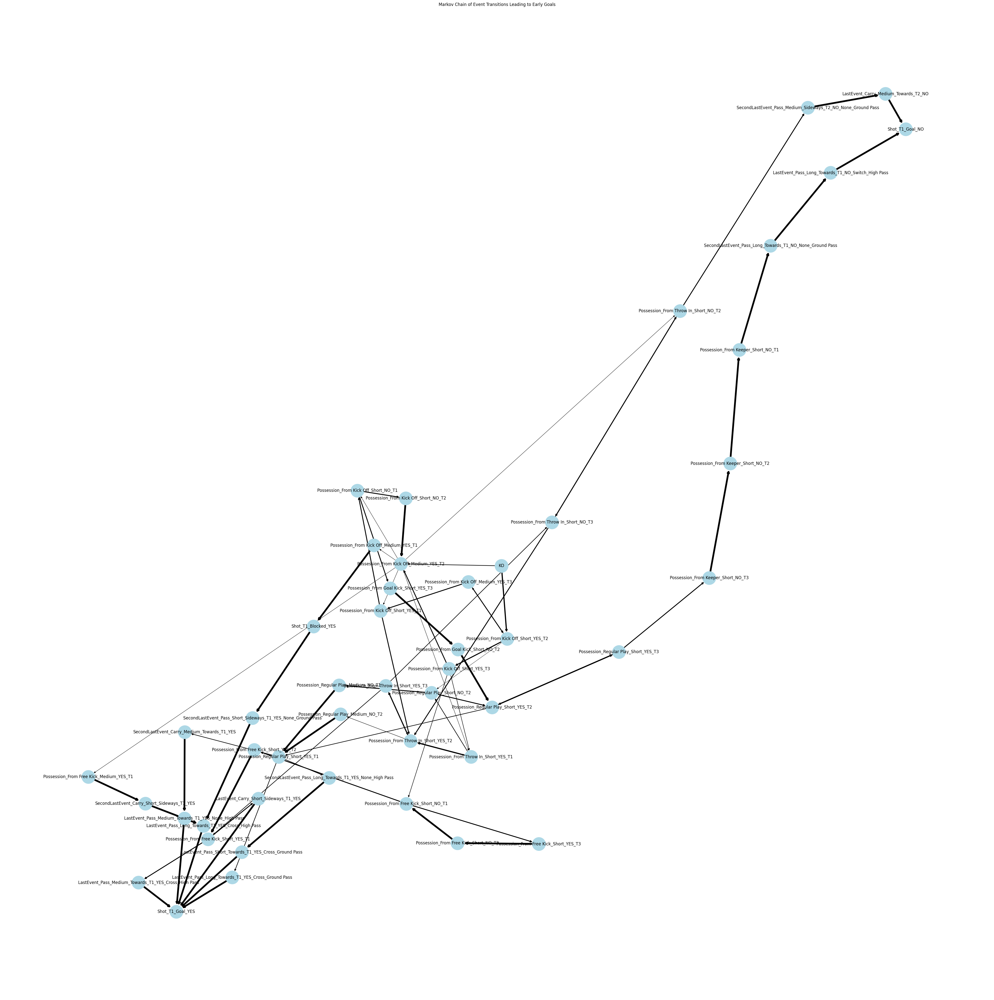


Cluster 1:
Transition matrix shape: (64, 64)
Number of state names: 64


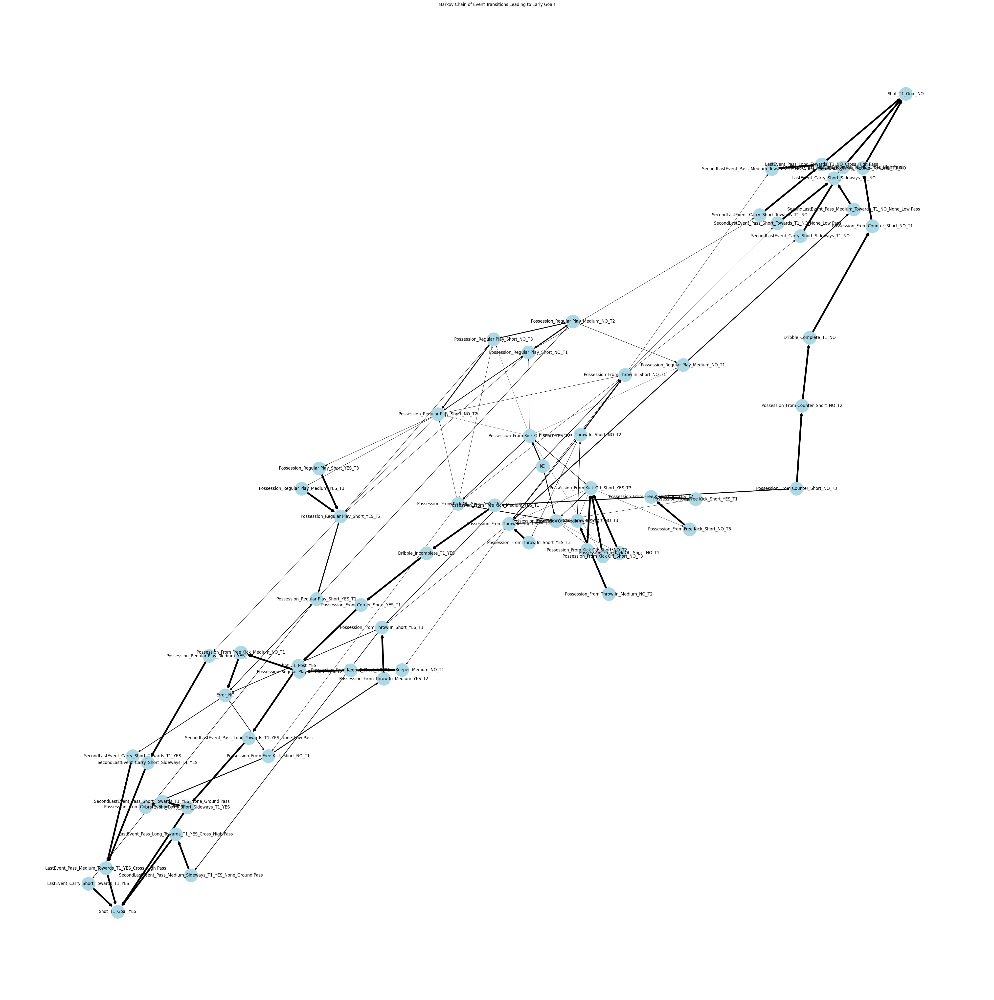


Cluster 2:
Transition matrix shape: (69, 69)
Number of state names: 69


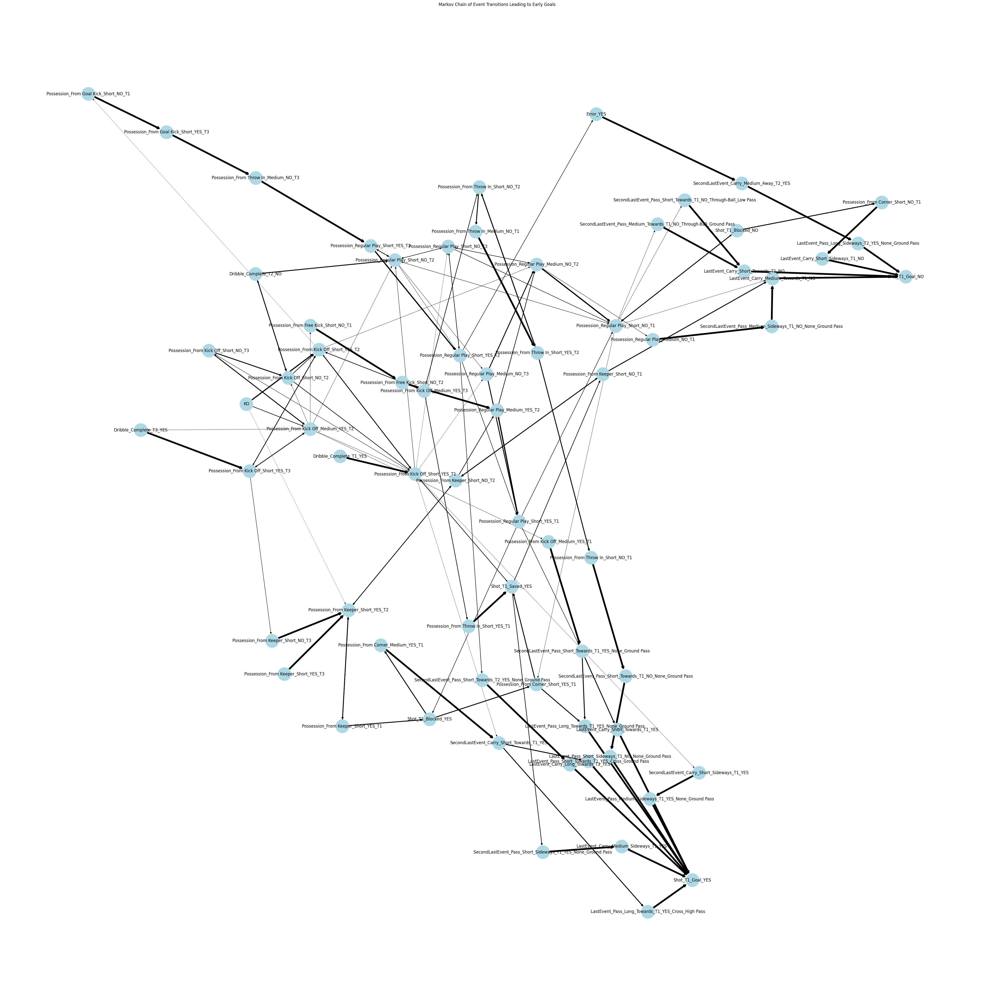


Cluster 3:
Transition matrix shape: (63, 63)
Number of state names: 63


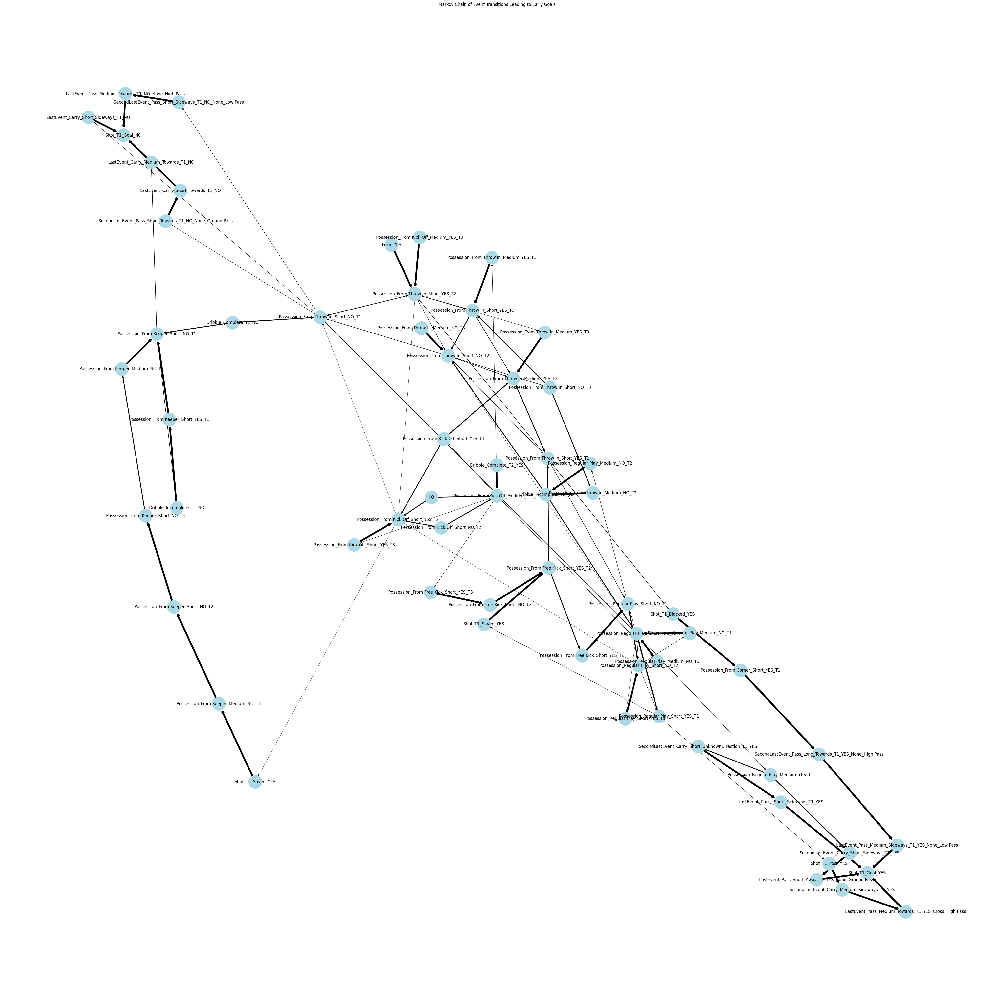


Cluster 4:
Transition matrix shape: (52, 52)
Number of state names: 52


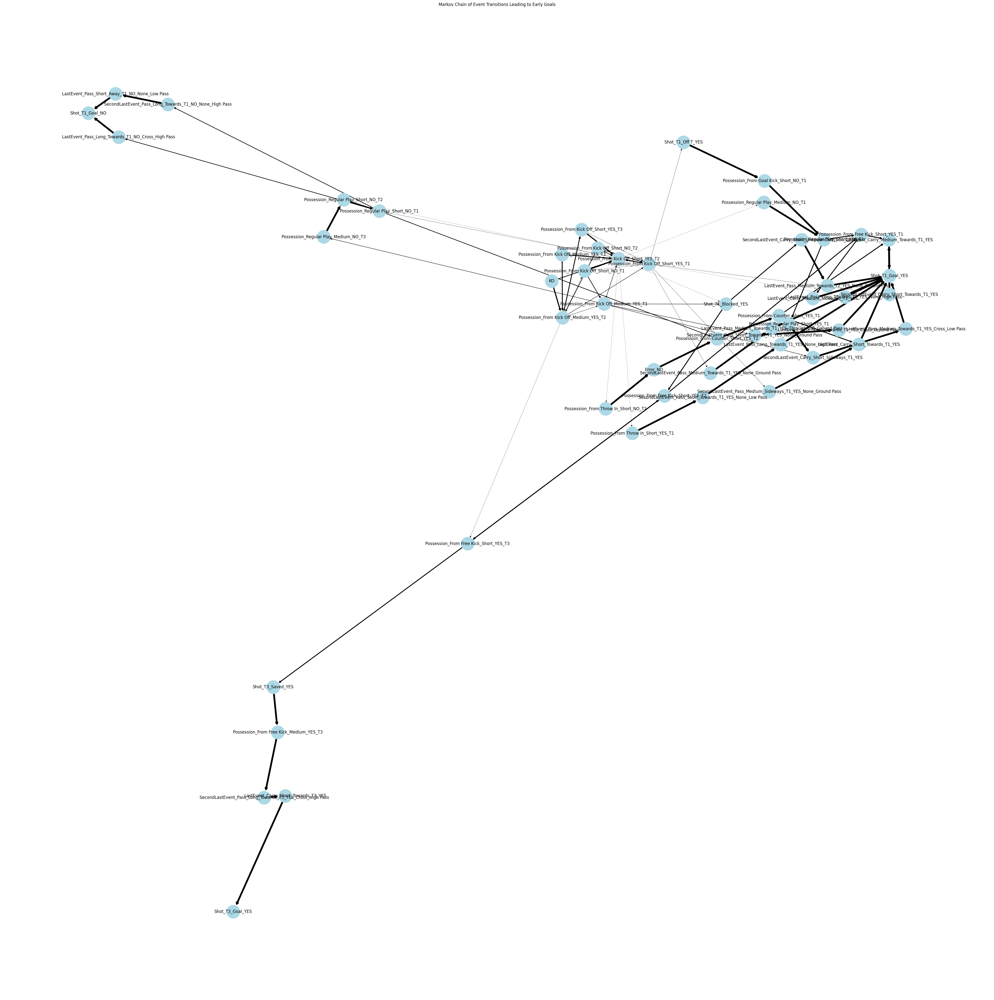


Cluster 5:
Transition matrix shape: (51, 51)
Number of state names: 51


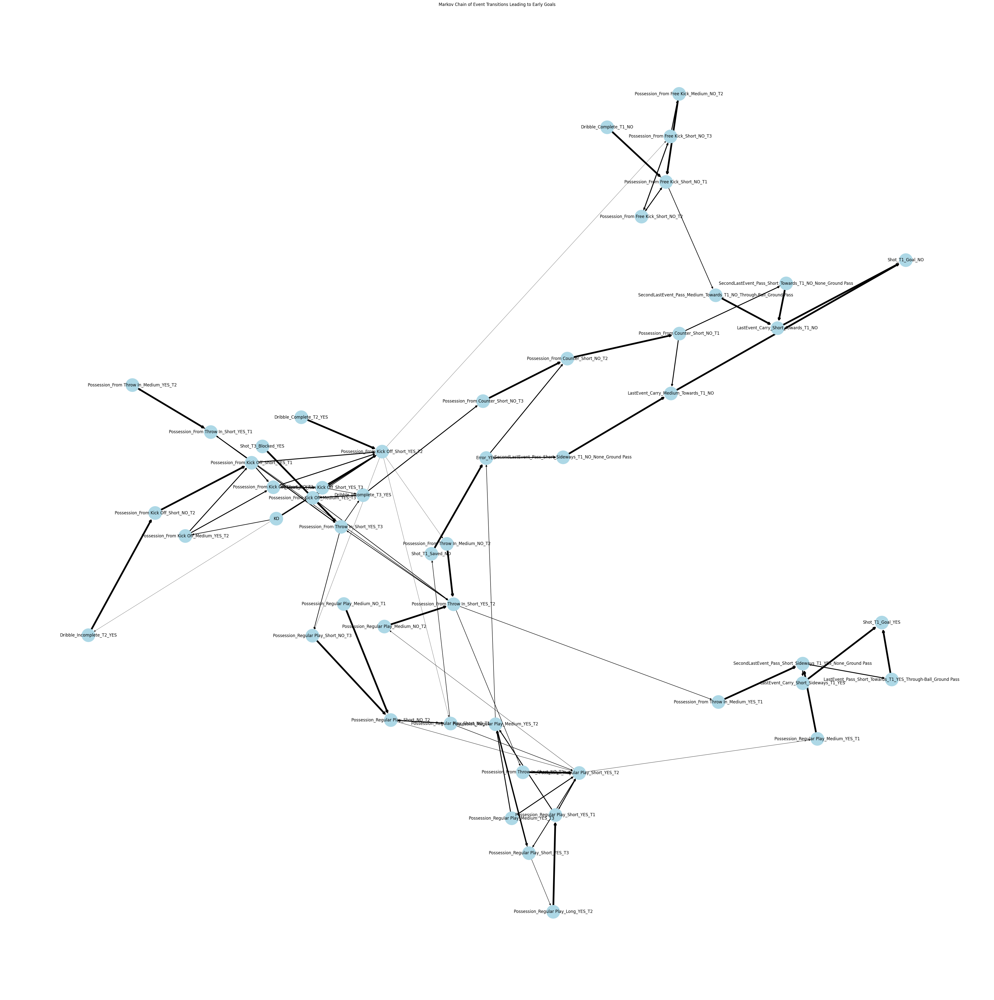


Cluster 6:
Transition matrix shape: (41, 41)
Number of state names: 41


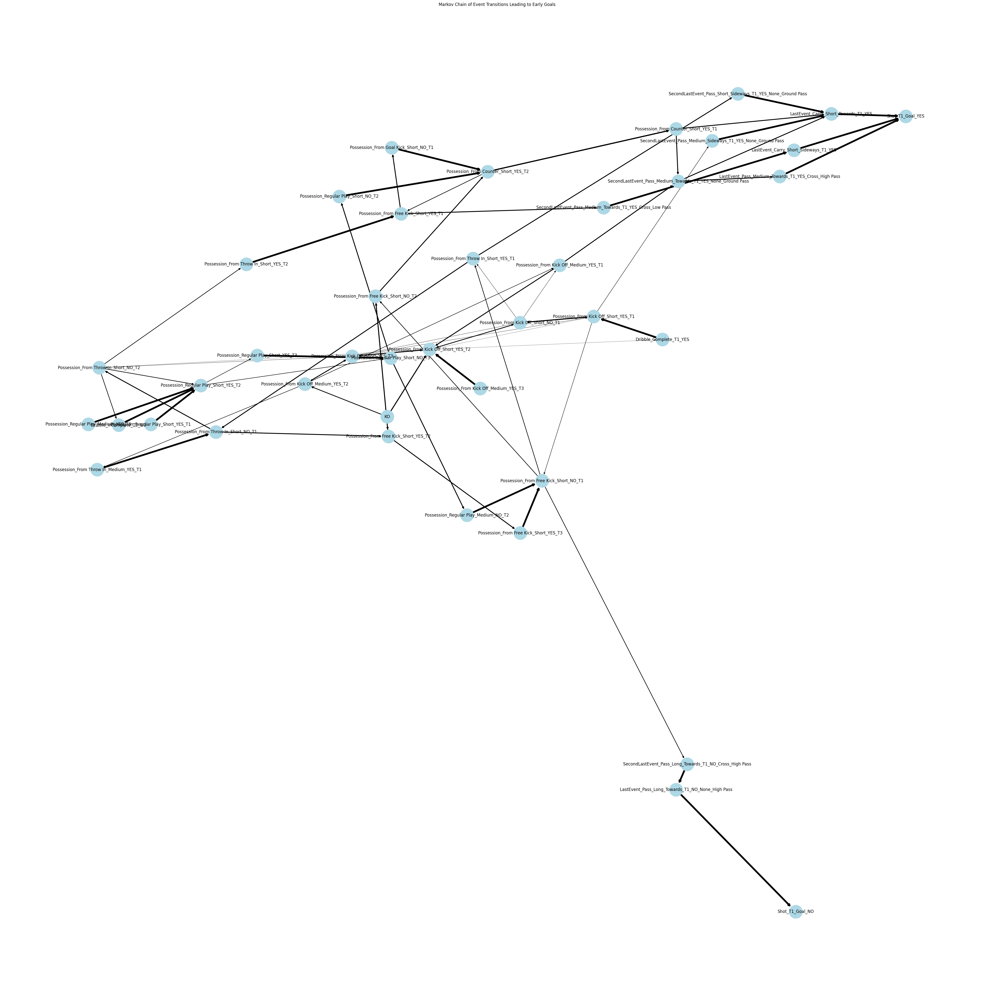


Cluster 7:
Transition matrix shape: (29, 29)
Number of state names: 29


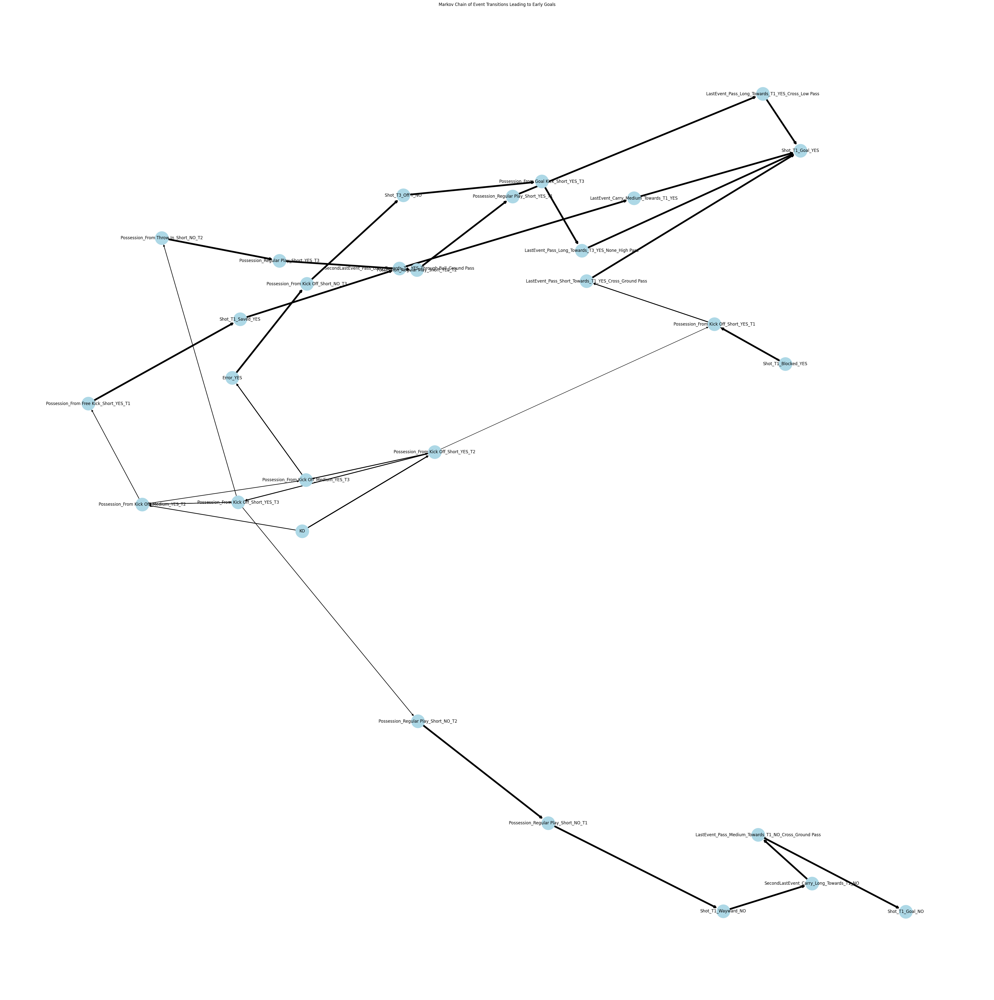


Cluster 8:
Transition matrix shape: (75, 75)
Number of state names: 75


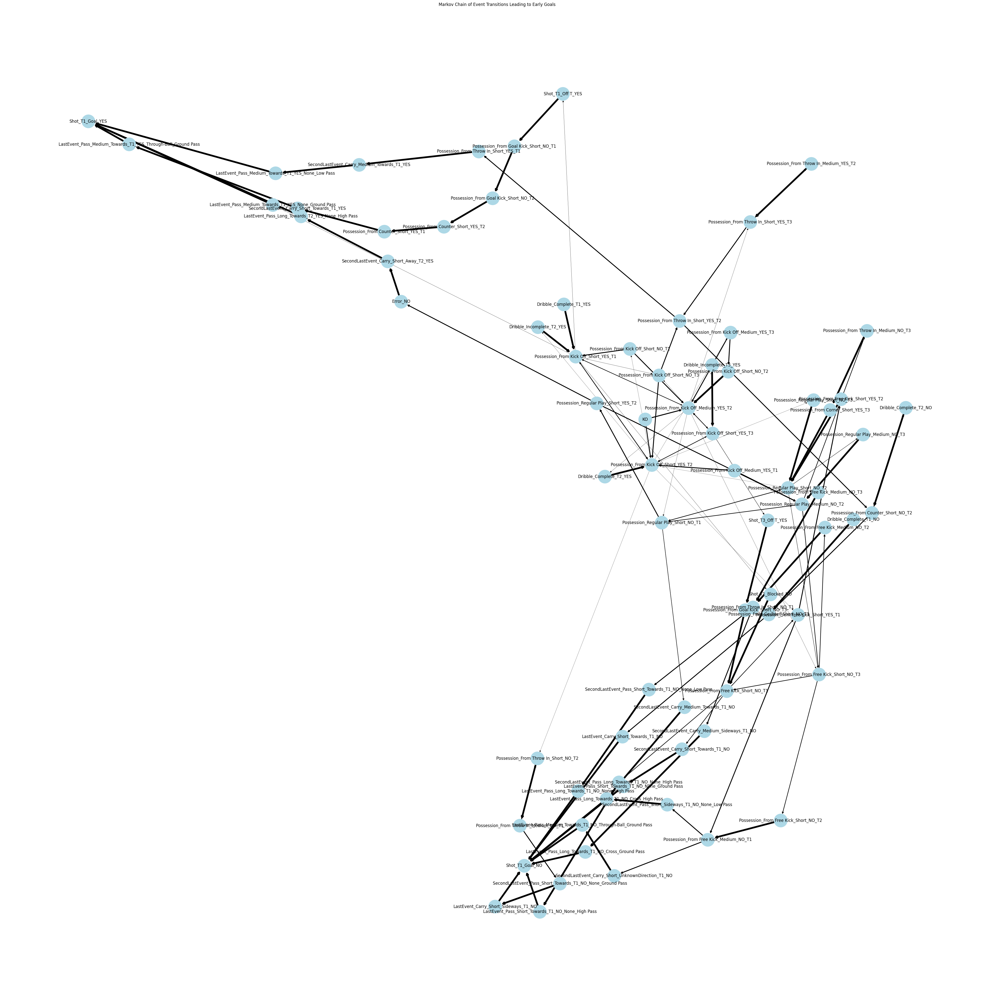


Cluster 9:
Transition matrix shape: (35, 35)
Number of state names: 35


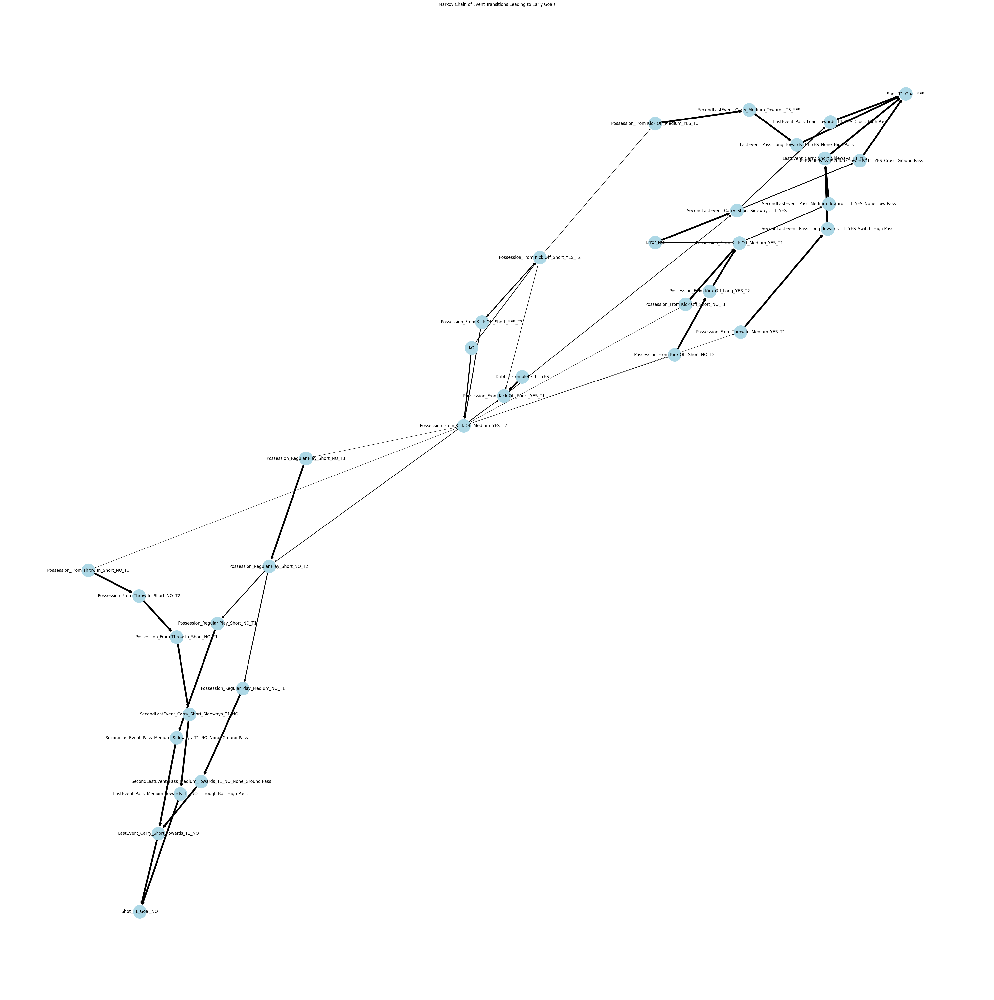


Cluster 10:
Transition matrix shape: (49, 49)
Number of state names: 49


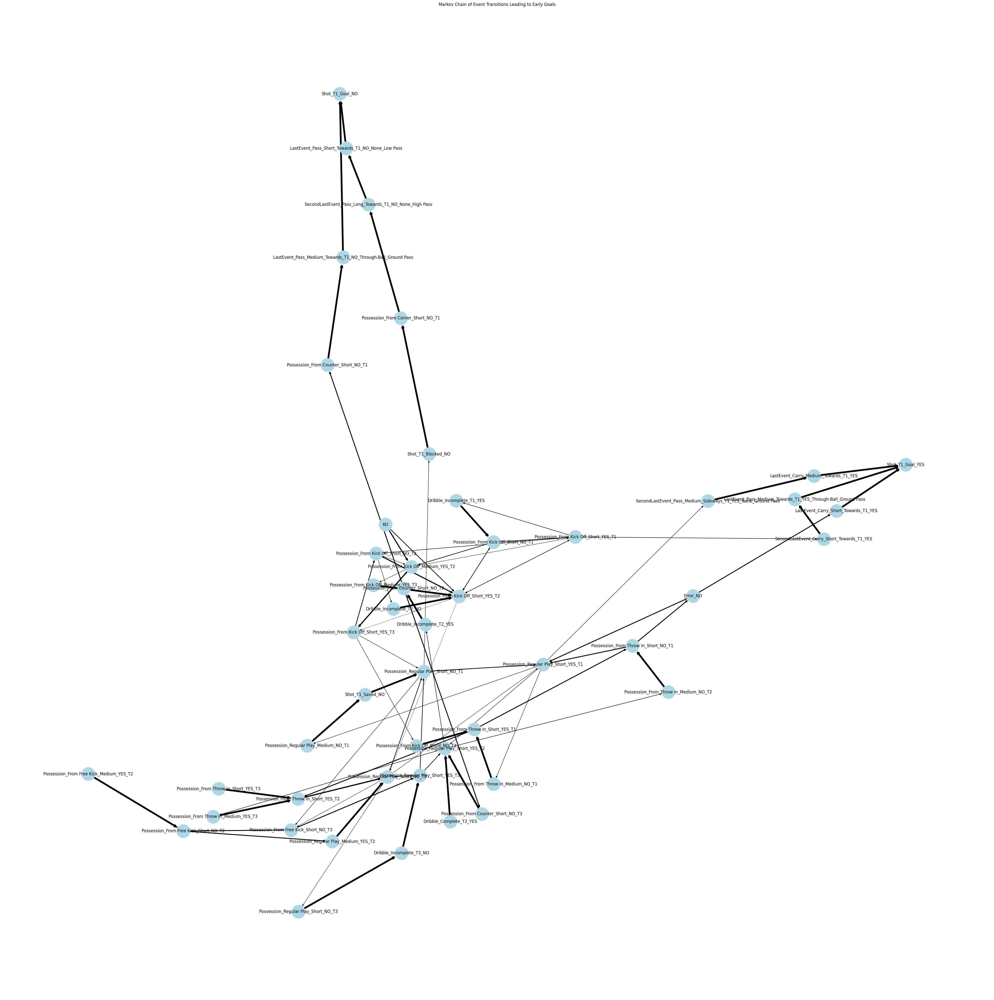


Cluster 11:
Transition matrix shape: (54, 54)
Number of state names: 54


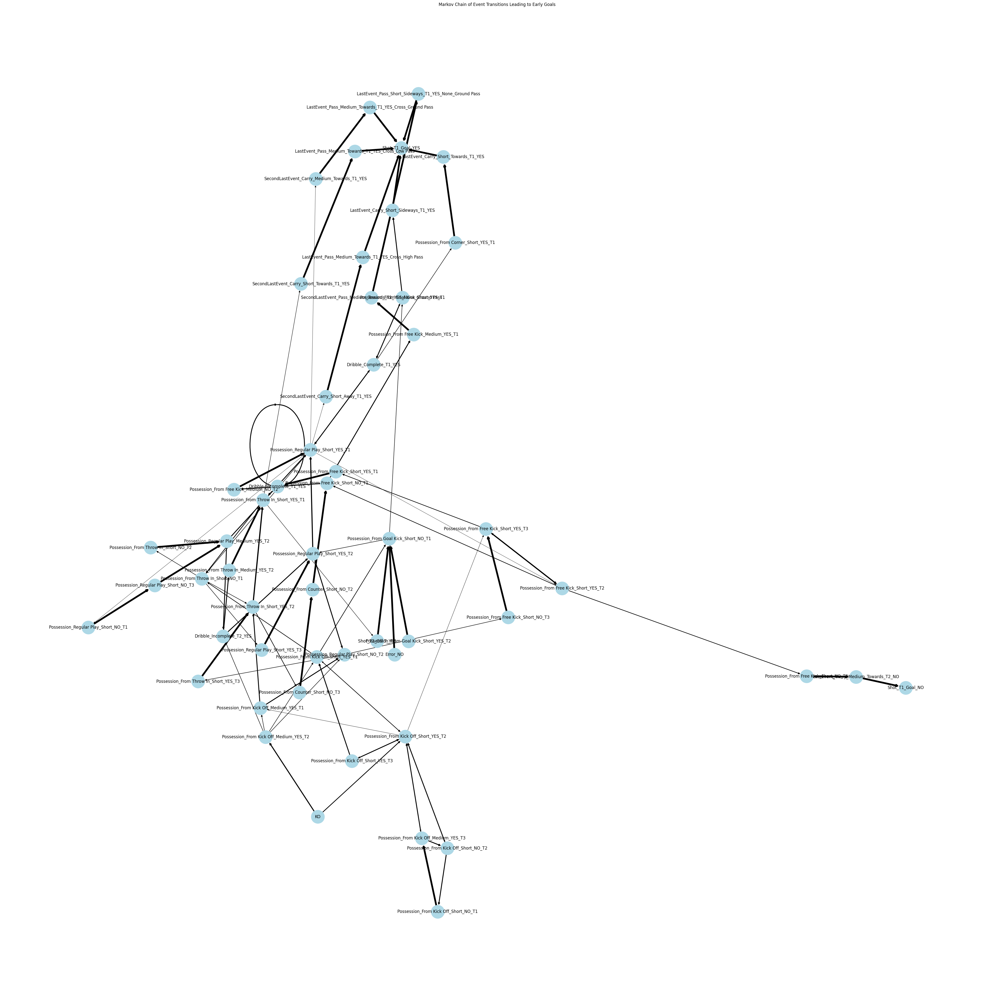


Cluster 12:
Transition matrix shape: (22, 22)
Number of state names: 22


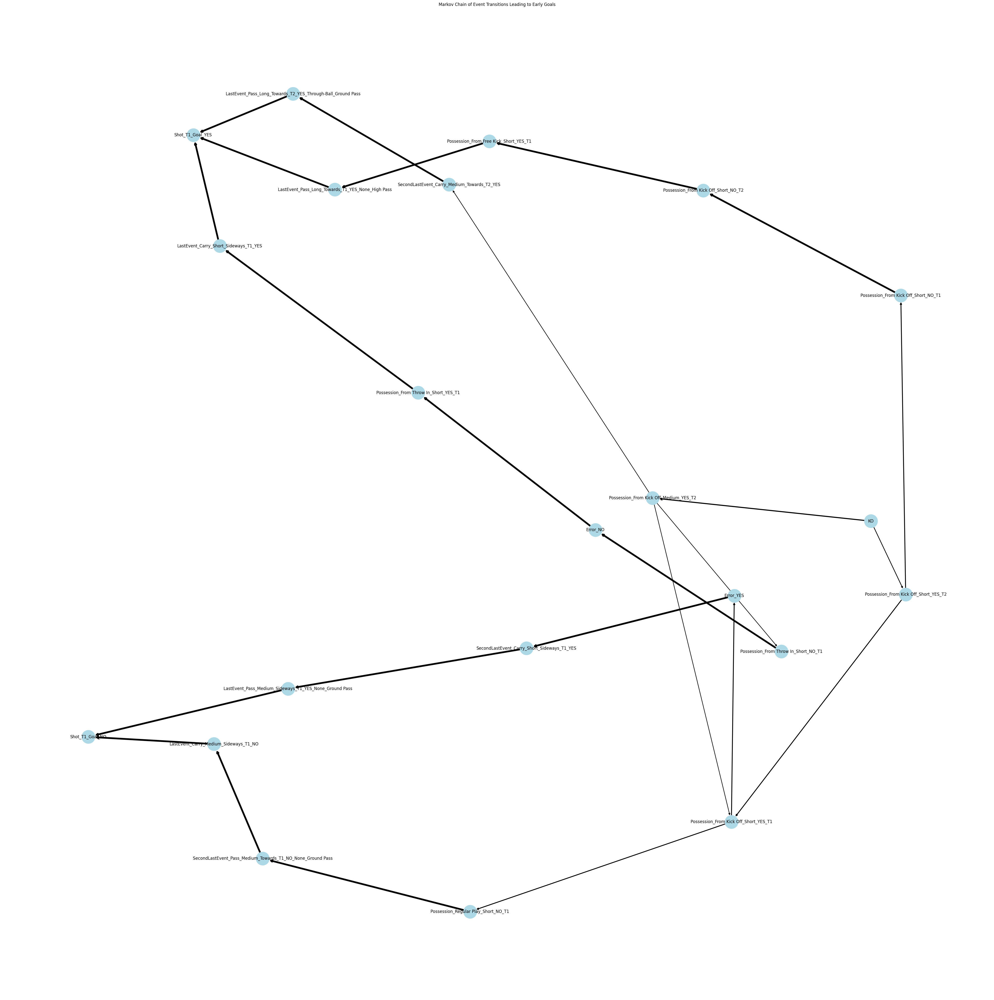


Cluster 13:
Transition matrix shape: (41, 41)
Number of state names: 41


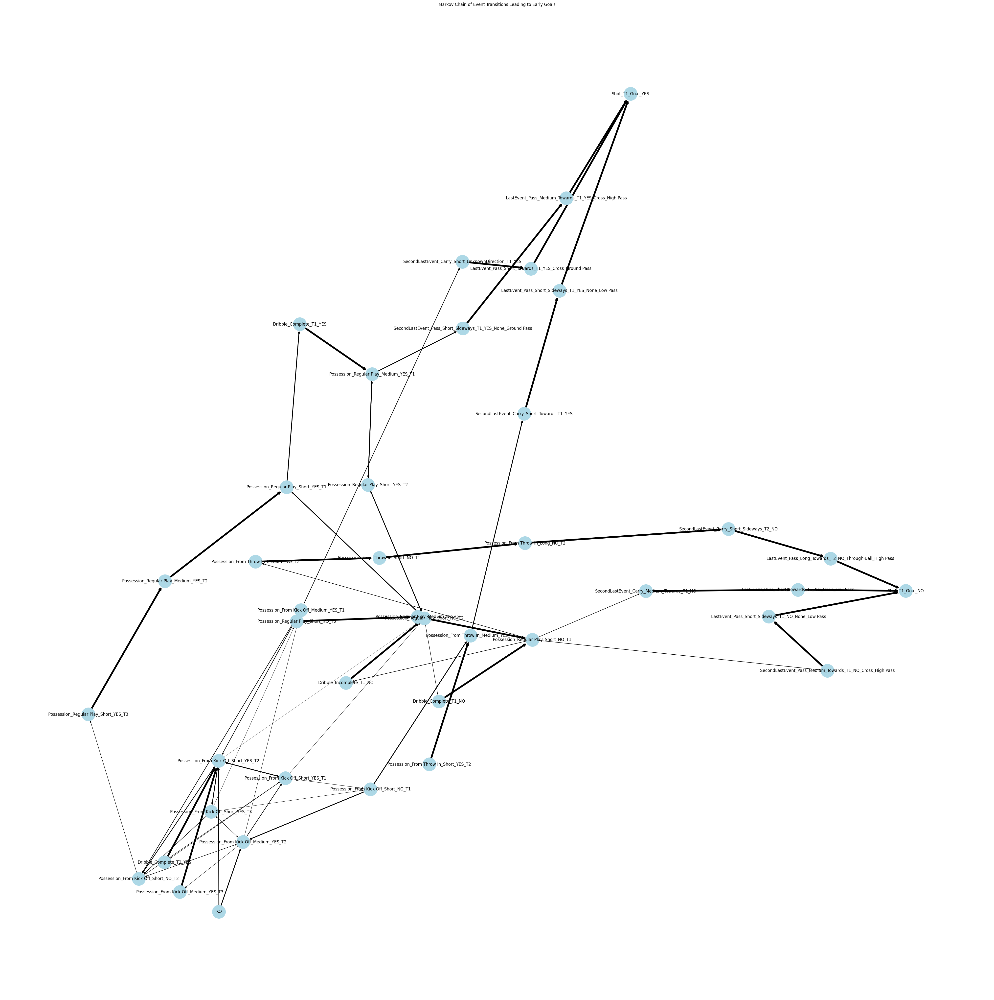


Cluster 14:
Transition matrix shape: (15, 15)
Number of state names: 15


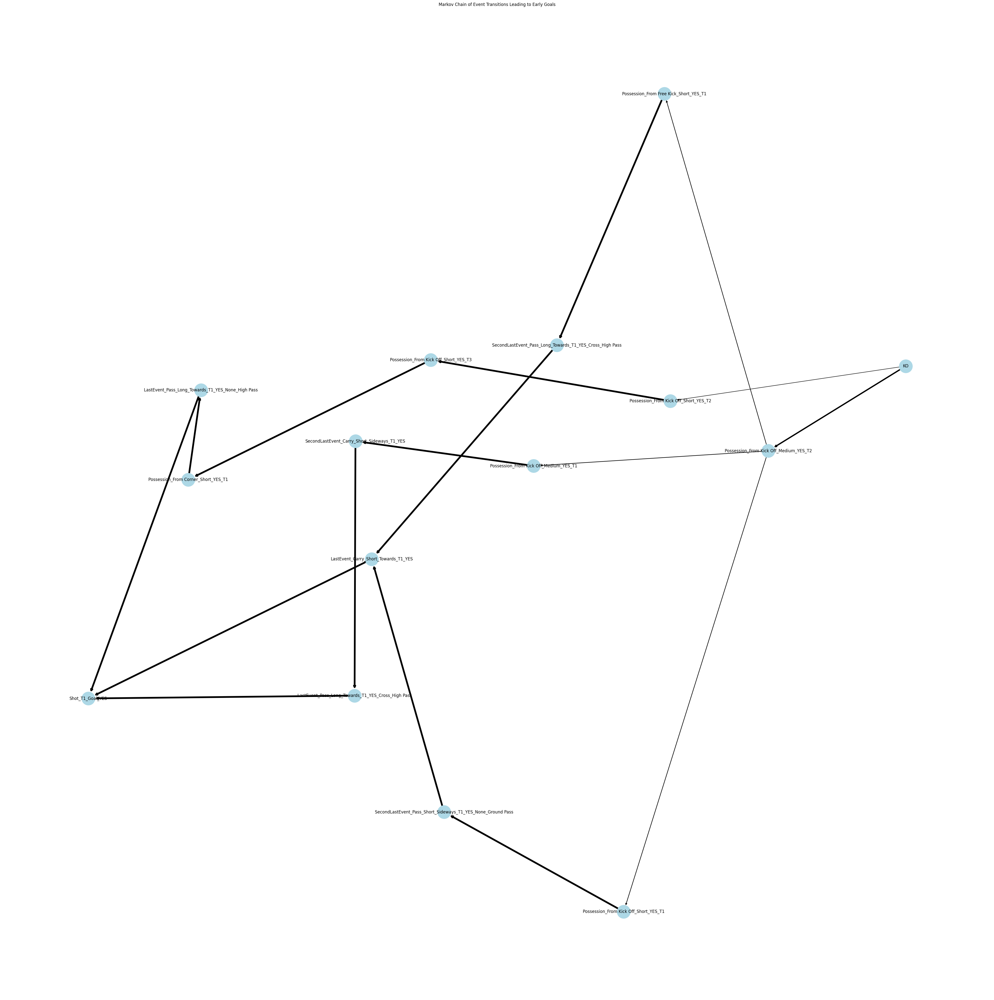


Cluster 15:
Transition matrix shape: (29, 29)
Number of state names: 29


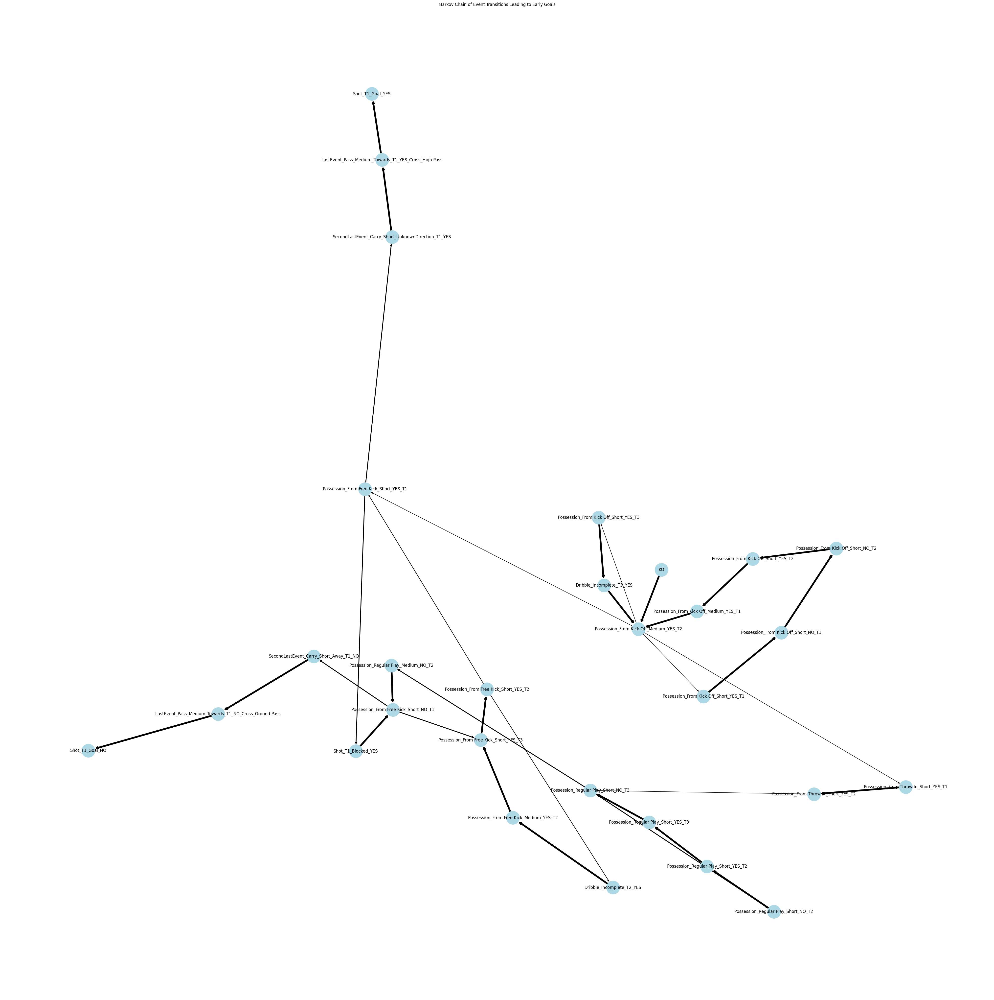


Cluster 16:
Transition matrix shape: (42, 42)
Number of state names: 42


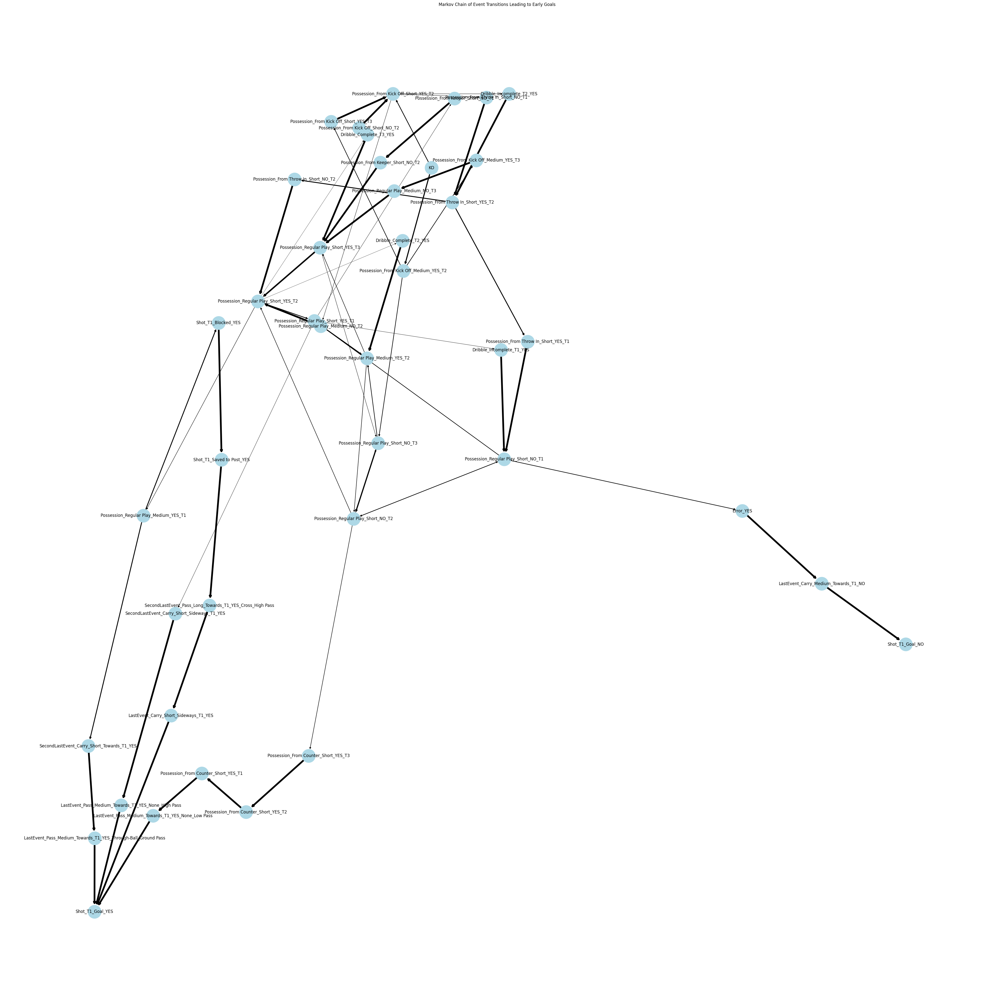


Cluster 17:
Transition matrix shape: (18, 18)
Number of state names: 18


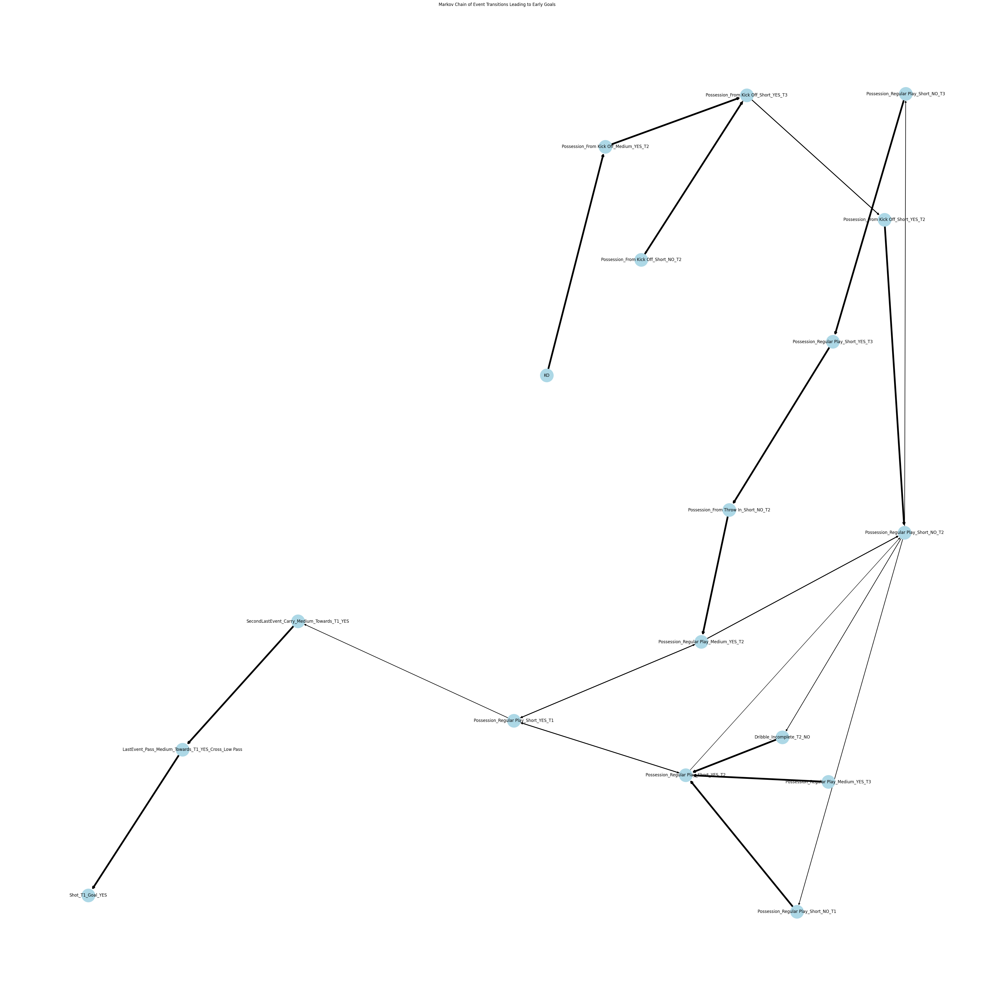


Cluster 18:
Transition matrix shape: (17, 17)
Number of state names: 17


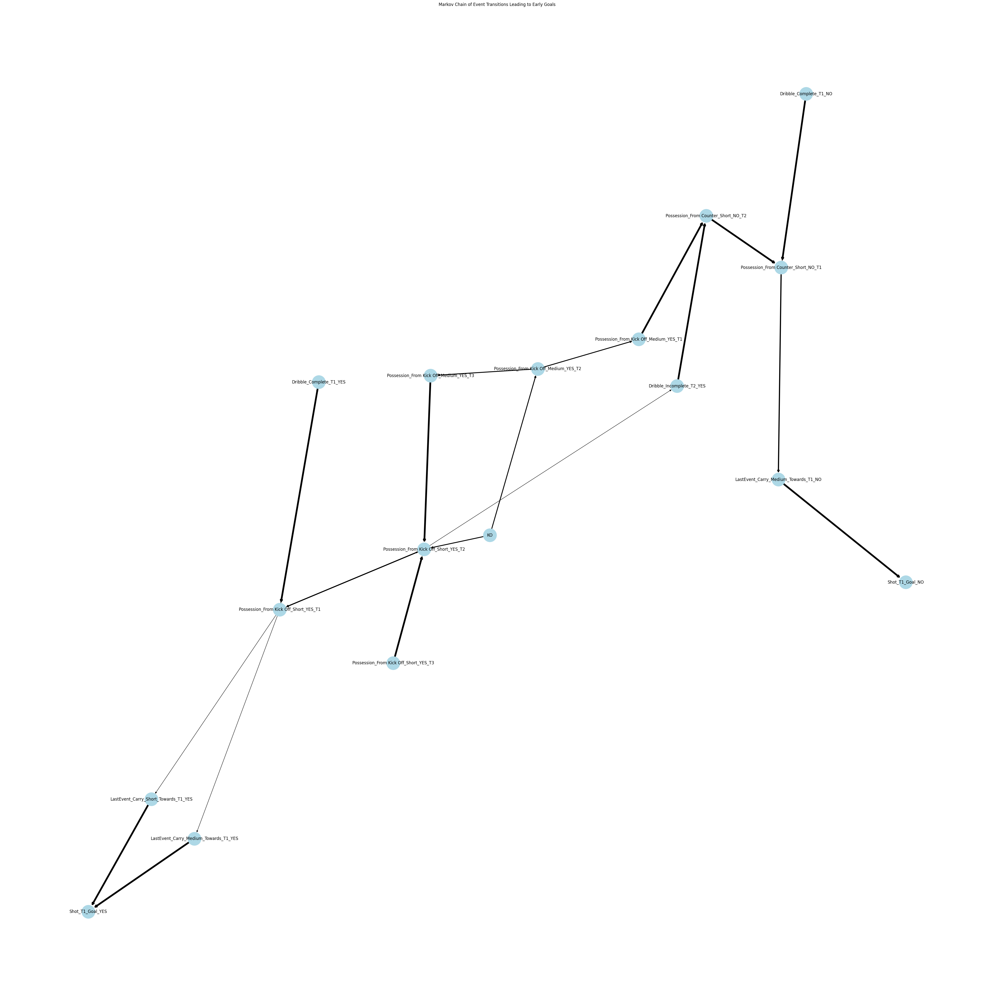


Cluster 19:
Transition matrix shape: (21, 21)
Number of state names: 21


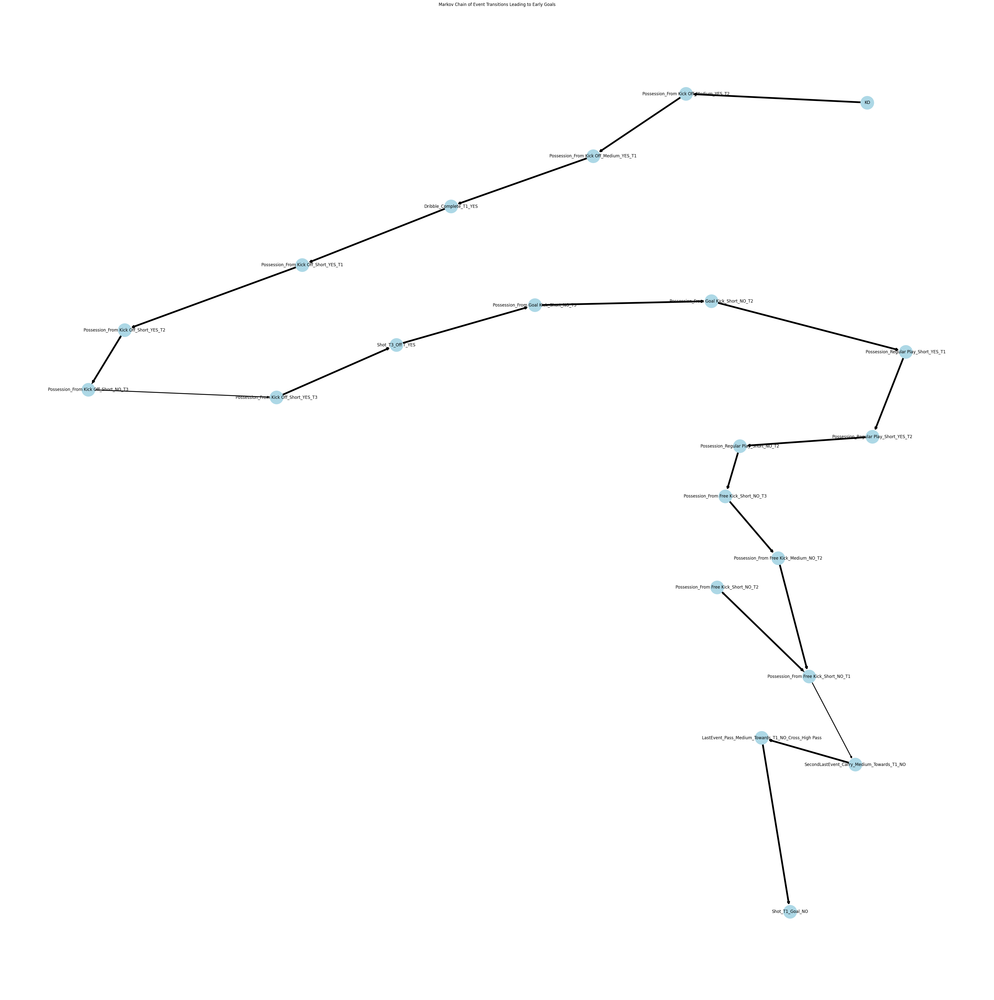


Cluster 20:
Transition matrix shape: (26, 26)
Number of state names: 26


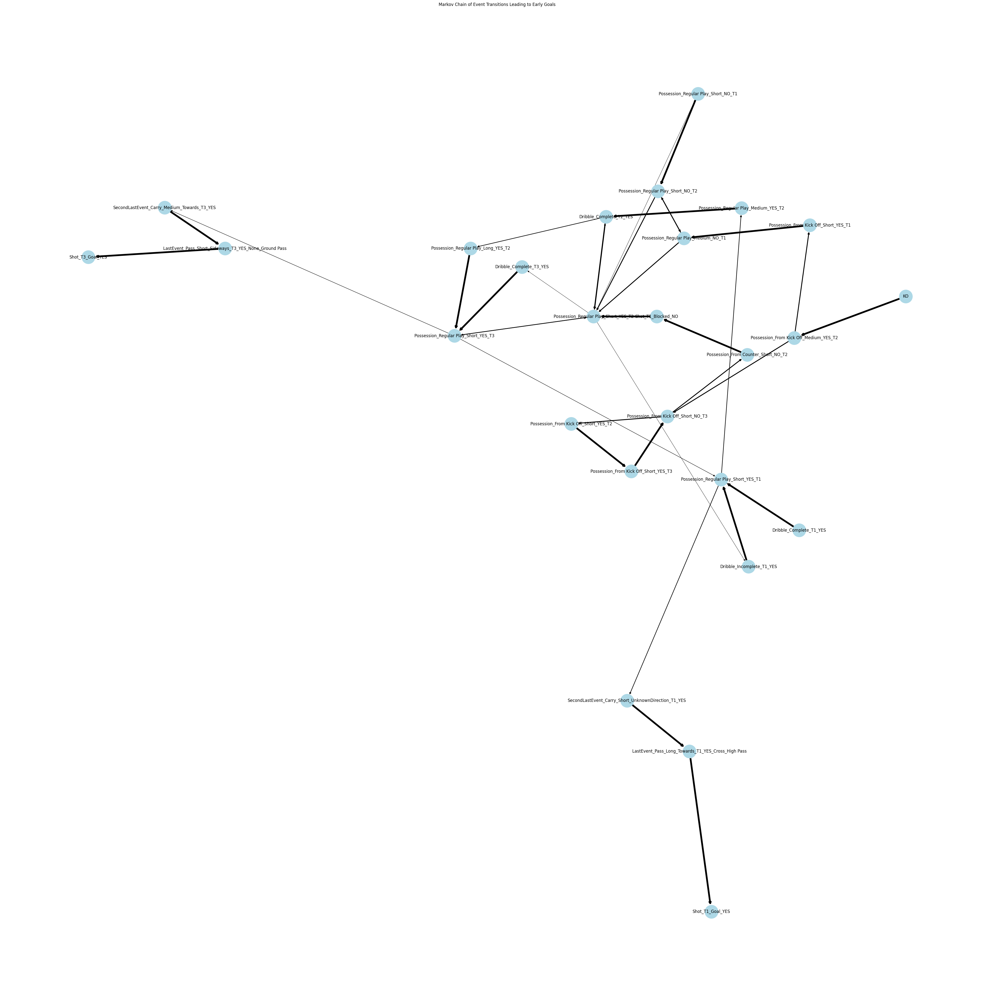

In [ ]:
for cluster_num in range(optimal_clusters):
    print(f"\nCluster {cluster_num}:")
    cluster_seqs = clustered_sequences[clustered_sequences['cluster'] == cluster_num]['sequence']

    seqs = []
    for seq in cluster_seqs:
      seq = ['KO'] + seq
      seqs.append(seq)

    all_enriched_events = [event for seq in seqs for event in seq]
    le = LabelEncoder()
    le.fit(all_enriched_events)

    # Encode sequences
    encoded_sequences = [le.transform(seq) for seq in seqs]

    # Initialize transition counts
    transition_counts = defaultdict(lambda: defaultdict(int))

    # Count transitions
    for seq in encoded_sequences:
        for i in range(len(seq) - 1):
            current_state = seq[i]
            next_state = seq[i + 1]
            transition_counts[current_state][next_state] += 1

    # Compute transition probabilities
    transition_matrix = {}
    for current_state, transitions in transition_counts.items():
        total = sum(transitions.values())
        transition_matrix[current_state] = {state: count / total for state, count in transitions.items()}


        # Step 1: Get all possible state indices and names
    all_state_indices = range(len(le.classes_))
    state_names = le.inverse_transform(all_state_indices)

    # Step 2: Initialize the transition matrix with zeros
    transition_df = pd.DataFrame(
        data=0.0,
        index=all_state_indices,
        columns=all_state_indices
    )

    # Step 3: Fill in the transition probabilities
    for current_state, transitions in transition_counts.items():
        total = sum(transitions.values())
        for next_state, count in transitions.items():
            probability = count / total
            transition_df.loc[current_state, next_state] = probability

    # Step 4: Assign state names to index and columns
    transition_df.index = state_names
    transition_df.columns = state_names

    # Step 5: Verify the dimensions
    print(f"Transition matrix shape: {transition_df.shape}")
    print(f"Number of state names: {len(state_names)}")

    G = nx.DiGraph()

    # Add edges with weights
    for from_state, transitions in transition_matrix.items():
        for to_state, prob in transitions.items():
            G.add_edge(le.inverse_transform([from_state])[0],
                      le.inverse_transform([to_state])[0],
                      weight=prob)

    # Draw the graph
    plt.figure(figsize=(40, 40))
    pos = nx.spring_layout(G)
    edges = G.edges(data=True)
    weights = [edge[2]['weight'] * 5 for edge in edges]  # Scale weights for visibility

    nx.draw(G, pos, with_labels=True, node_size=1500, node_color='lightblue', font_size=12, width=weights)
    plt.title('Markov Chain of Event Transitions Leading to Early Goals')
    plt.show()


## Future

Getting the most impactful players

Then trying to find a profile of player that excels at early goals

Individuality in the play

Control of the game



### Getting most important player from each goal

## OLD

### Temporal Pattern Finding

In [ ]:
from mlxtend.preprocessing import TransactionEncoder
from mlxtend.frequent_patterns import apriori, association_rules

# Prepare transactional data
transactions = []

for sequence in sequences:
    # Convert numerical encoding back to event types
    events_in_sequence = le.inverse_transform(sequence)
    transactions.append(list(events_in_sequence))

# Encode transactions
te = TransactionEncoder()
te_ary = te.fit(transactions).transform(transactions)
df_transactions = pd.DataFrame(te_ary, columns=te.columns_)

# Apply Apriori algorithm
frequent_itemsets = apriori(df_transactions, min_support=0.1, use_colnames=True)

# Generate association rules
rules = association_rules(frequent_itemsets, metric="lift", min_threshold=1)
